## Importing required modules

In [ ]:
import pandas as pd
import numpy as np
from numpy import where
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

# Task 1: Dataset1

In [ ]:
from google.colab import files
up = files.upload()

Saving Data1.csv to Data1.csv


In [ ]:
#Importing the datasets
df1 = pd.read_csv('/content/Data1.csv')

In [ ]:
df1.head()

,Unnamed: 0,X1,X2,X3,Class
0,1,-0.063274,0.027734,0.022683,1
1,2,-0.000731,0.048211,0.069198,1
2,3,-0.060767,-0.009080,0.053085,1
3,4,0.013252,-0.011876,0.055324,1
4,5,-0.054508,-0.003813,0.001738,1


In [ ]:
#brief of data
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 212 entries, 0 to 211
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  212 non-null    int64  
 1   X1          212 non-null    float64
 2   X2          212 non-null    float64
 3   X3          212 non-null    float64
 4   Class       212 non-null    int64  
dtypes: float64(3), int64(2)
memory usage: 8.4 KB


## Cleaning data 

we can drop column Unnamed: 0

In [ ]:
df1.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
#Brief stats
df1.describe()

,X1,X2,X3,Class
count,212.000000,212.000000,212.000000,212.000000
mean,0.015418,0.034183,-0.035626,3.971698
std,1.647716,1.670505,1.628822,2.016320
min,-3.970394,-3.881493,-3.909294,1.000000
25%,-0.407496,-0.476732,-0.423145,2.000000
50%,-0.003762,-0.004597,0.021322,4.000000
75%,0.438729,0.500722,0.384359,6.000000
max,3.747710,3.774495,3.899389,7.000000


In [ ]:
#Skewness
df1.skew()

X1      -0.035493
X2       0.028725
X3      -0.083991
Class    0.010996
dtype: float64

skewness is in acceptable range

In [ ]:
#Checking the class column
df1['Class'].value_counts()

1    32
2    30
3    30
4    30
5    30
6    30
7    30
Name: Class, dtype: int64

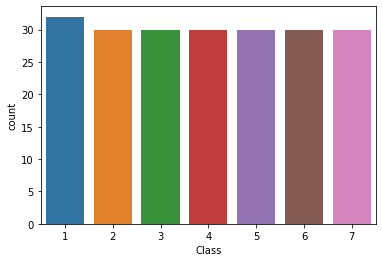

In [ ]:
#Seeing visually
sns.countplot(df1['Class'])

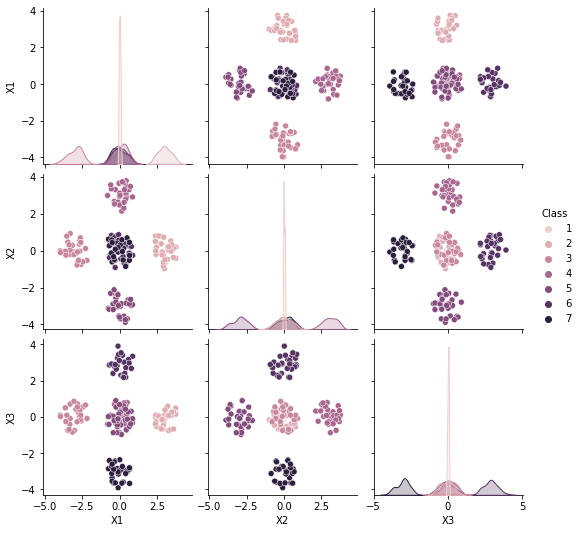

In [ ]:
#Viewing how the clusters are in original
sns.pairplot(df1,hue='Class')

## Task 1.1
- Cluster the dataset based on K-Means & Hierarchial 

making data ready for clustering

In [ ]:
df = df1.drop('Class',axis=1)
df.head()

,X1,X2,X3
0,-0.063274,0.027734,0.022683
1,-0.000731,0.048211,0.069198
2,-0.060767,-0.009080,0.053085
3,0.013252,-0.011876,0.055324
4,-0.054508,-0.003813,0.001738


In [ ]:
df2 = df.to_numpy()
y=df1['Class']

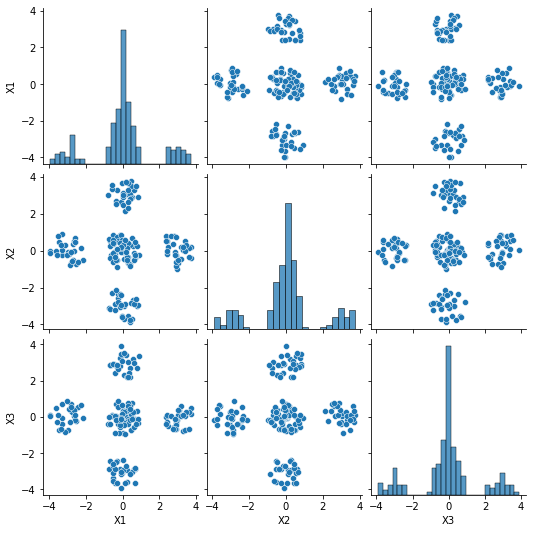

In [ ]:
sns.pairplot(df)

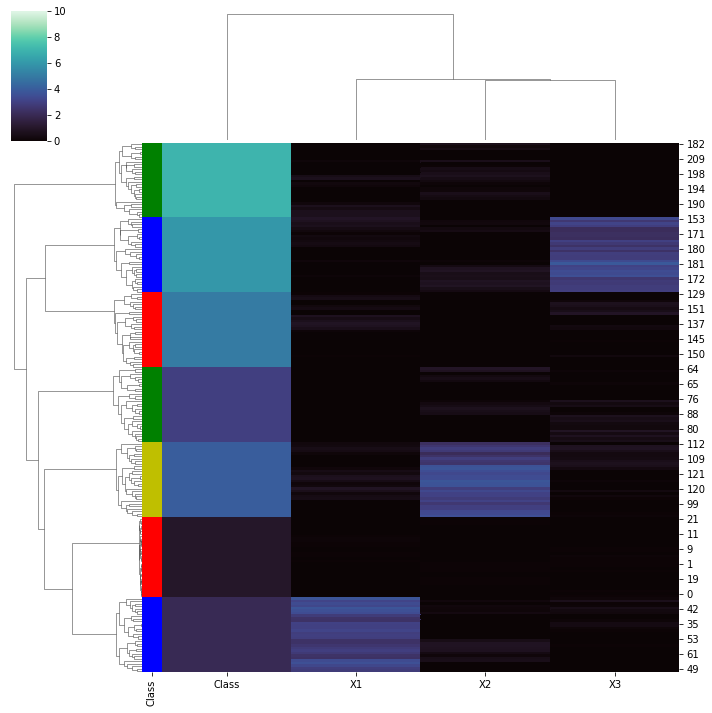

In [ ]:
ut = dict(zip(df1['Class'].unique(), "rbgyrbg"))
row_colors = df1['Class'].map(ut)
g = sns.clustermap(df1, row_colors=row_colors,cmap="mako", vmin=0, vmax=10)

#### Hierarchial clustering

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
df.head()

,X1,X2,X3
0,-0.063274,0.027734,0.022683
1,-0.000731,0.048211,0.069198
2,-0.060767,-0.009080,0.053085
3,0.013252,-0.011876,0.055324
4,-0.054508,-0.003813,0.001738


Trying different linkage techniques

Single linkage

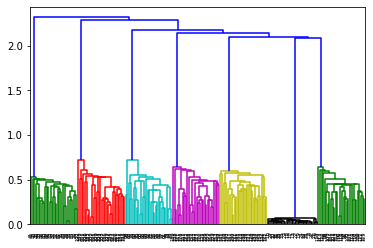

In [ ]:
#Single linkage
mergings = linkage(df,method='single',metric='euclidean')
dendrogram(mergings)
plt.show()

As per this we can make 7 clusters

Complete linkage

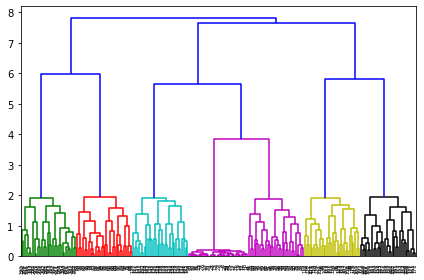

In [ ]:
#complete linkage
mergings = linkage(df,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

ward linkage

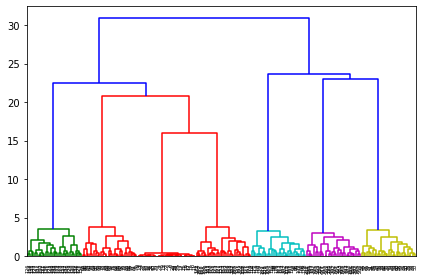

In [ ]:
mergings = linkage(df,method='ward',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

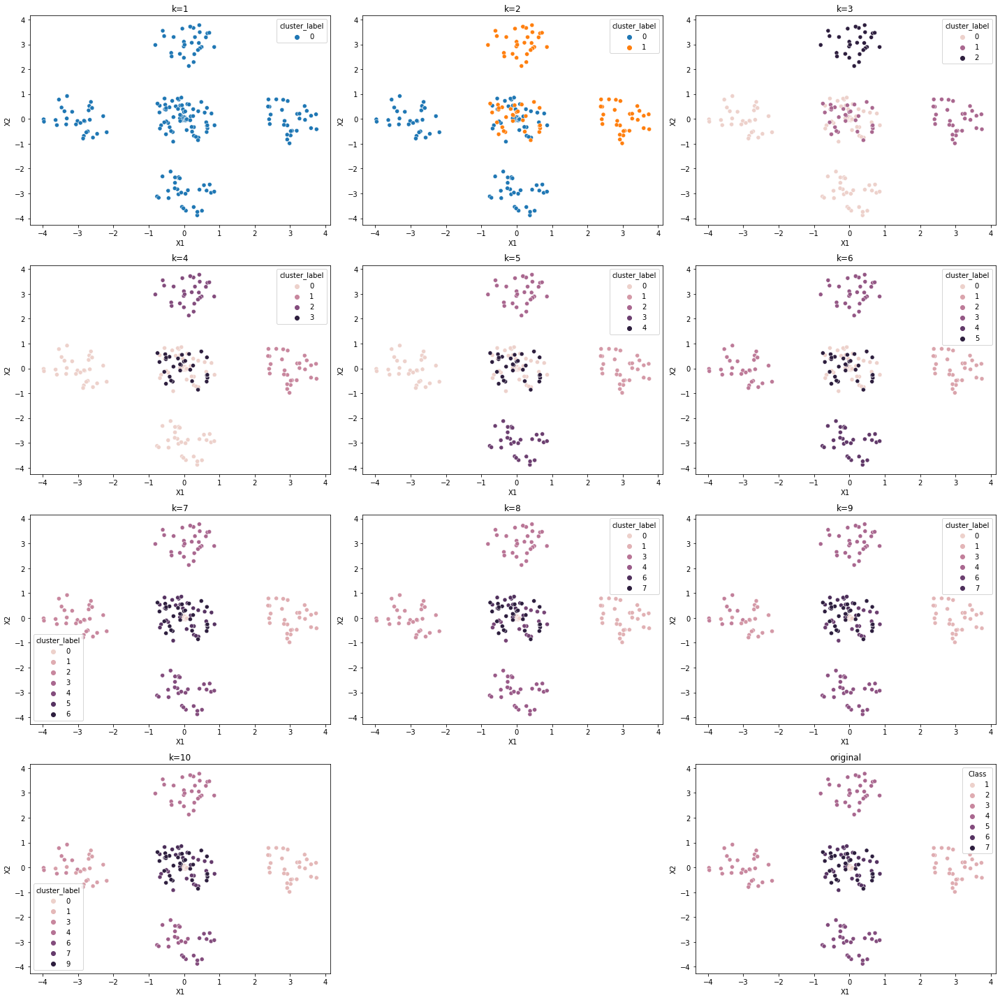

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,11):
    
    #Cutting the tree into clusters
    cluster_labels = cut_tree(mergings,n_clusters=i)
    cluster_labels=cluster_labels.reshape(-1, )
    df['cluster_label'] = cluster_labels
    
    #plotting 
    plt.subplot(4,3,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(4,3,12)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

We can see k = 7 have similar results as of original

In [ ]:
#so we will split into 7 categories
cluster_labels = cut_tree(mergings,n_clusters=7)
cluster_labels=cluster_labels.reshape(-1, )
df['cluster_label'] = cluster_labels
df

,X1,X2,X3,cluster_label
0,-0.063274,0.027734,0.022683,0
1,-0.000731,0.048211,0.069198,0
2,-0.060767,-0.009080,0.053085,0
3,0.013252,-0.011876,0.055324,0
4,-0.054508,-0.003813,0.001738,0
...,...,...,...,...
207,0.175738,-0.053478,-2.733752,6
208,0.396046,-0.858377,-3.126866,6
209,-0.406362,-0.334541,-2.885598,6
210,-0.299275,0.071281,-3.642585,6


#### K-Means clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df)
    
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 1785.7767864279167
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 1305.4078064051405
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 901.642397948212
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 550.7240557421219
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 261.6741842800862
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 106.14764659310868
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 98.67058007041967
-----------

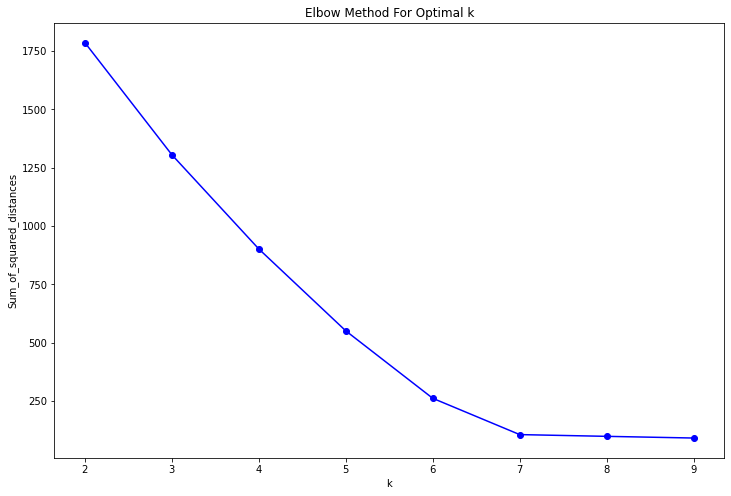

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bo-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this we can see,we can make cluster at 6 or 7

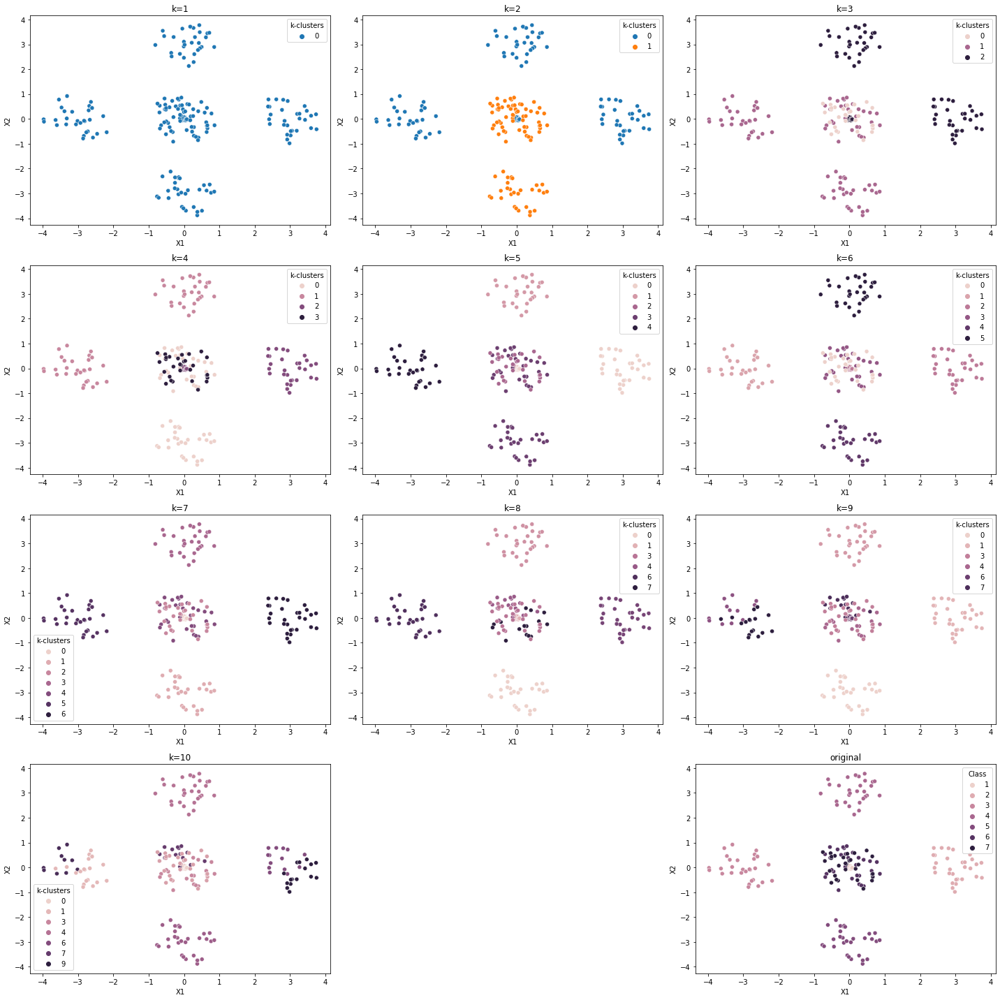

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,11):
    
    #Cutting the tree into clusters
    kmean = KMeans(n_clusters = i)
    kmean.fit(df.iloc[:,:-1])
    df['k-clusters'] = kmean.labels_
    
    #plotting 
    plt.subplot(4,3,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(4,3,12)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

cluster 7 is looking optimum

In [ ]:
#so we will split into 7 categories
kmean = KMeans(n_clusters=7)
kmean.fit(df.iloc[:,:-2])
df['k-clusters'] = kmean.labels_
df

,X1,X2,X3,cluster_label,k-clusters
0,-0.063274,0.027734,0.022683,0,2
1,-0.000731,0.048211,0.069198,0,2
2,-0.060767,-0.009080,0.053085,0,2
3,0.013252,-0.011876,0.055324,0,2
4,-0.054508,-0.003813,0.001738,0,2
...,...,...,...,...,...
207,0.175738,-0.053478,-2.733752,6,3
208,0.396046,-0.858377,-3.126866,6,3
209,-0.406362,-0.334541,-2.885598,6,3
210,-0.299275,0.071281,-3.642585,6,3


In [ ]:
df['original']=df1['Class']
df

,X1,X2,X3,cluster_label,k-clusters,original
0,-0.063274,0.027734,0.022683,0,2,1
1,-0.000731,0.048211,0.069198,0,2,1
2,-0.060767,-0.009080,0.053085,0,2,1
3,0.013252,-0.011876,0.055324,0,2,1
4,-0.054508,-0.003813,0.001738,0,2,1
...,...,...,...,...,...,...
207,0.175738,-0.053478,-2.733752,6,3,7
208,0.396046,-0.858377,-3.126866,6,3,7
209,-0.406362,-0.334541,-2.885598,6,3,7
210,-0.299275,0.071281,-3.642585,6,3,7


In [ ]:
df['original']=df['original']-1

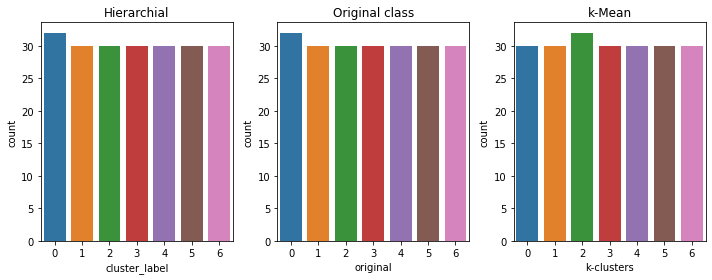

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,3,1)
sns.countplot(df['cluster_label'])
plt.title('Hierarchial')

plt.subplot(1,3,2)
sns.countplot(df['original'])
plt.title('Original class')


plt.subplot(1,3,3)
sns.countplot(df['k-clusters'])
plt.title('k-Mean')


plt.tight_layout()


from this we can see hierarchial predicted/ divided correctly than k-means

1.2 : External Validation

Techniques:
   - Classification accuracy
   - Purity
   - Precision
   - Recall
   - F-Measured
   - Jaccard
   - Rand index
   - Fowlkes Mallows
   - Hubert statistics
   - Entropy 
   - Mutual Information

https://drive.google.com/file/d/1GDHY6iojk0PASg1D5HGdyoCfPvVOZ68z/view?usp=sharing

Through above link math equations for validation metrics can be viewed

##### Rand index: Rand =T P + T N/M


In [ ]:
from sklearn import metrics

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Rand Index of')
print('Hierarchial clustering:',metrics.rand_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.rand_score(label_true, k_pred),2))

Rand Index of
Hierarchial clustering: 1.0
K_Means clustering: 1.0


#### Homogenity & Completeness

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Homogenity & Completeness of')
print('Hierarchial clustering, Homogenity:',metrics.homogeneity_score(label_true, h_pred))
print('Hierarchial clustering, completeness:',metrics.completeness_score(label_true, h_pred))

print('K_Means clustering,Homogenity:',round(metrics.homogeneity_score(label_true, k_pred),2))
print('K_Means clustering, completeness:',round(metrics.completeness_score(label_true, k_pred),2))



Homogenity & Completeness of
Hierarchial clustering, Homogenity: 1.0
Hierarchial clustering, completeness: 1.0
K_Means clustering,Homogenity: 1.0
K_Means clustering, completeness: 1.0


#### Fowlkes Mallows Score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Fowlkes Mallows of')
print('Hierarchial clustering:',metrics.fowlkes_mallows_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.fowlkes_mallows_score(label_true, k_pred),2))


Fowlkes Mallows of
Hierarchial clustering: 1.0
K_Means clustering: 1.0


#### Jaccard score J =T P /T P + F P + F N

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Jaccard score of')
print('Hierarchial clustering:',metrics.jaccard_score(label_true, h_pred,average='weighted'))
print('K_Means clustering:',round(metrics.jaccard_score(label_true, k_pred,average='weighted'),2))


Jaccard score of
Hierarchial clustering: 1.0
K_Means clustering: 0.14


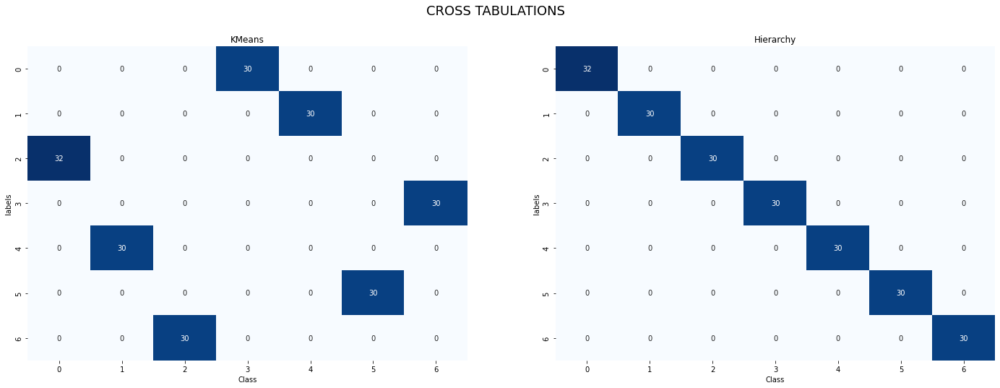

In [ ]:
h_pred = df['cluster_label']
k_pred = df['k-clusters']

# cross tabulation table for kmeans
df_k = pd.DataFrame({'labels':k_pred,"Class":df['original']})
ct1 = pd.crosstab(df_k['labels'],df_k['Class'])

# cross tabulation table for Hierarchy
df_h = pd.DataFrame({'labels':h_pred,"Class":df['original']})
ct2 = pd.crosstab(df_h['labels'],df_h['Class'])


plt.figure(figsize=(24,8))
plt.suptitle("CROSS TABULATIONS",fontsize=18)
plt.subplot(1,2,1)
plt.title("KMeans")
sns.heatmap(ct1,annot=True,cbar=False,cmap="Blues")

plt.subplot(1,2,2)
plt.title("Hierarchy")
sns.heatmap(ct2,annot=True,cbar=False,cmap="Blues")

plt.show()

We can see in hierarchy it is predicting correctly

In [ ]:
from sklearn.metrics.cluster import pair_confusion_matrix

In [ ]:
print('Hierarchial clustering:')
pair_confusion_matrix(label_true, h_pred)

Hierarchial clustering:


array([[38520,     0],
       [    0,  6212]])

In [ ]:
print('K_Means clustering:')
pair_confusion_matrix(label_true, k_pred)

K_Means clustering:


array([[38520,     0],
       [    0,  6212]])

In [ ]:
#Accuracy score

print('Accuracy score of  Hierarchial clustering:',metrics.accuracy_score(label_true, h_pred))
print('Accuracy score of K_Means clustering:',metrics.accuracy_score(label_true, k_pred))

Accuracy score of  Hierarchial clustering: 1.0
Accuracy score of K_Means clustering: 0.14150943396226415


precision : T P/T P + F P = TP/P
Recall : TP/TP+FN
F1-score : 1 + α/(1/P r +α/R)

In [ ]:
#Classification report
print('Classification report of  Hierarchial clustering:\n',metrics.classification_report(label_true, h_pred))
print('Classification report of K_Means clustering:\n',metrics.classification_report(label_true, k_pred))

Classification report of  Hierarchial clustering:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00        32
           1       1.00      1.00      1.00        30
           2       1.00      1.00      1.00        30
           3       1.00      1.00      1.00        30
           4       1.00      1.00      1.00        30
           5       1.00      1.00      1.00        30
           6       1.00      1.00      1.00        30

    accuracy                           1.00       212
   macro avg       1.00      1.00      1.00       212
weighted avg       1.00      1.00      1.00       212

Classification report of K_Means clustering:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00        32
           1       0.00      0.00      0.00        30
           2       0.00      0.00      0.00        30
           3       0.00      0.00      0.00        30
           4       0.00      0.00  

From above observation we cn conclude hierarchial clustering method is working well in this dataset with 100% accuracy

## Ploting the graph:

#### 1.3 : Plot of data points according to original class

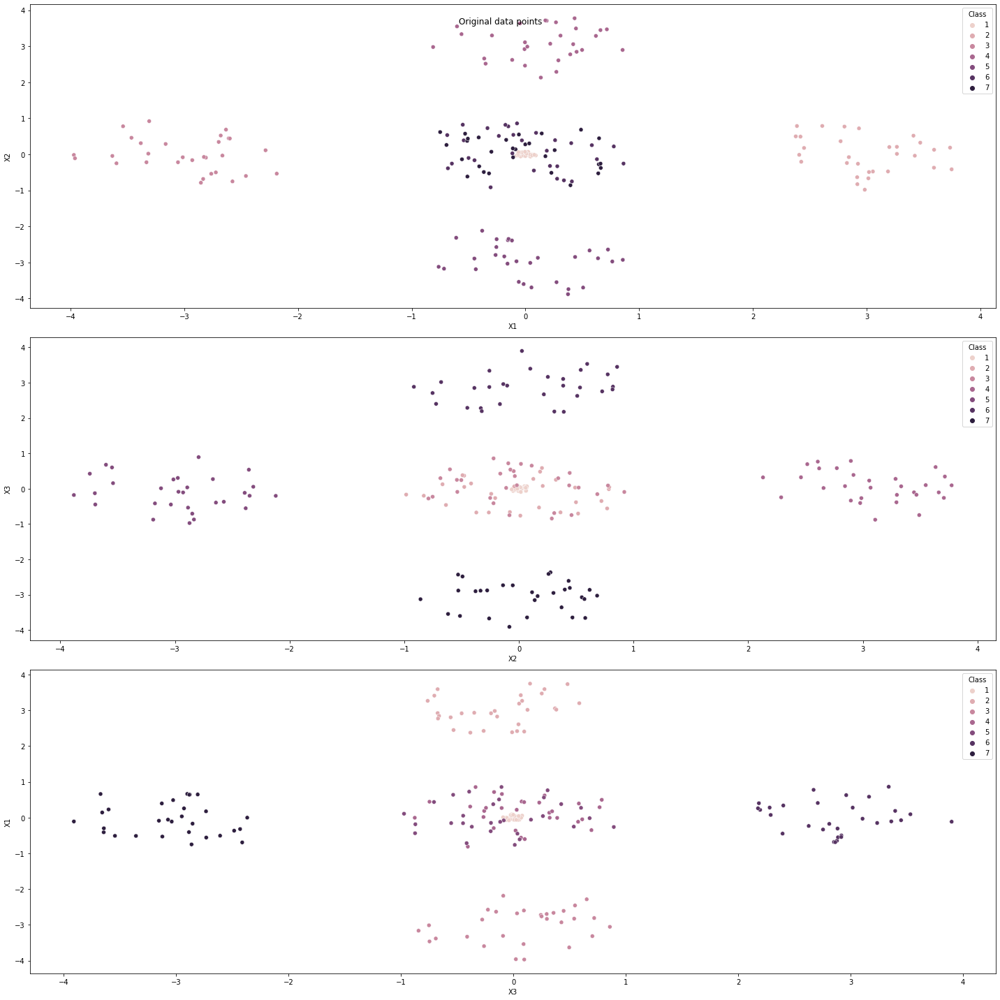

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df1,hue='Class')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df1,hue='Class')

plt.subplot(3,1,3)
sns.scatterplot('X3','X1',data=df1,hue='Class')

plt.tight_layout()

#### 1.4 : Plot of data points according to class by algorithm

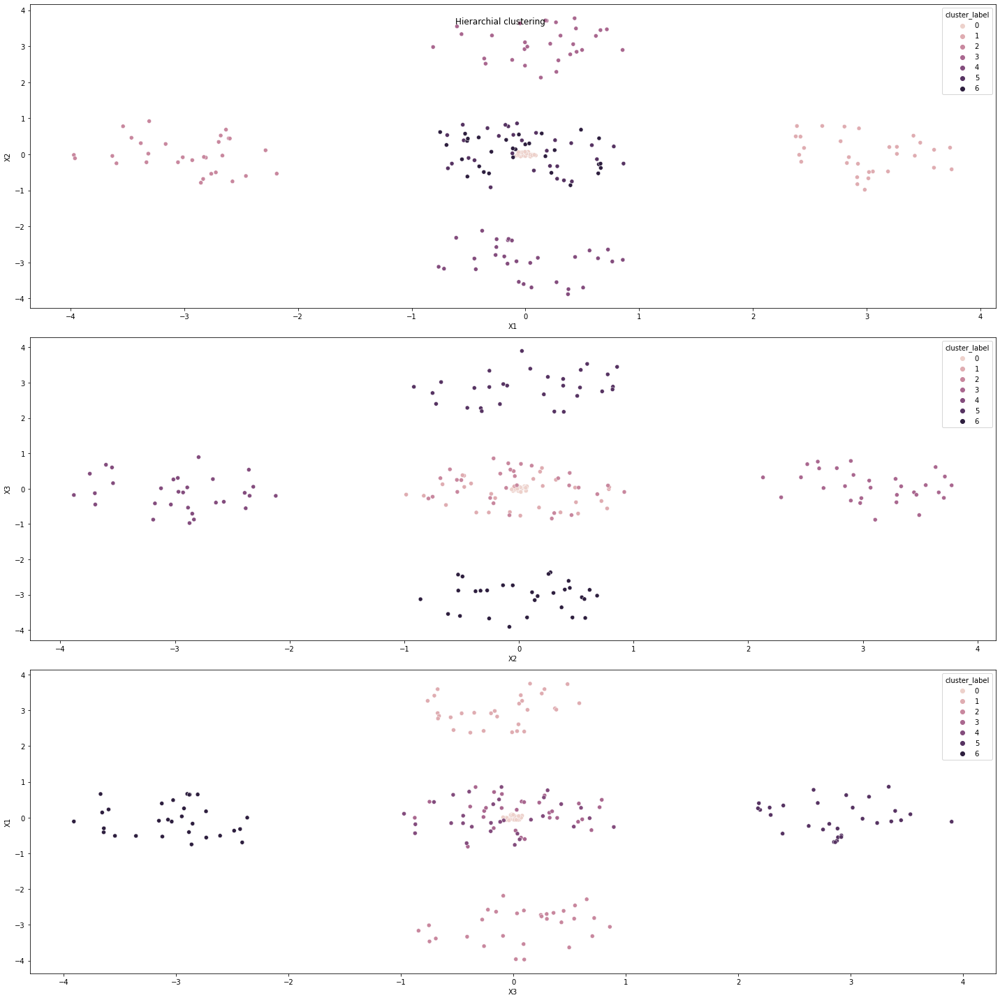

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Hierarchial clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='cluster_label')

plt.subplot(3,1,3)
sns.scatterplot('X3','X1',data=df,hue='cluster_label')

plt.tight_layout()

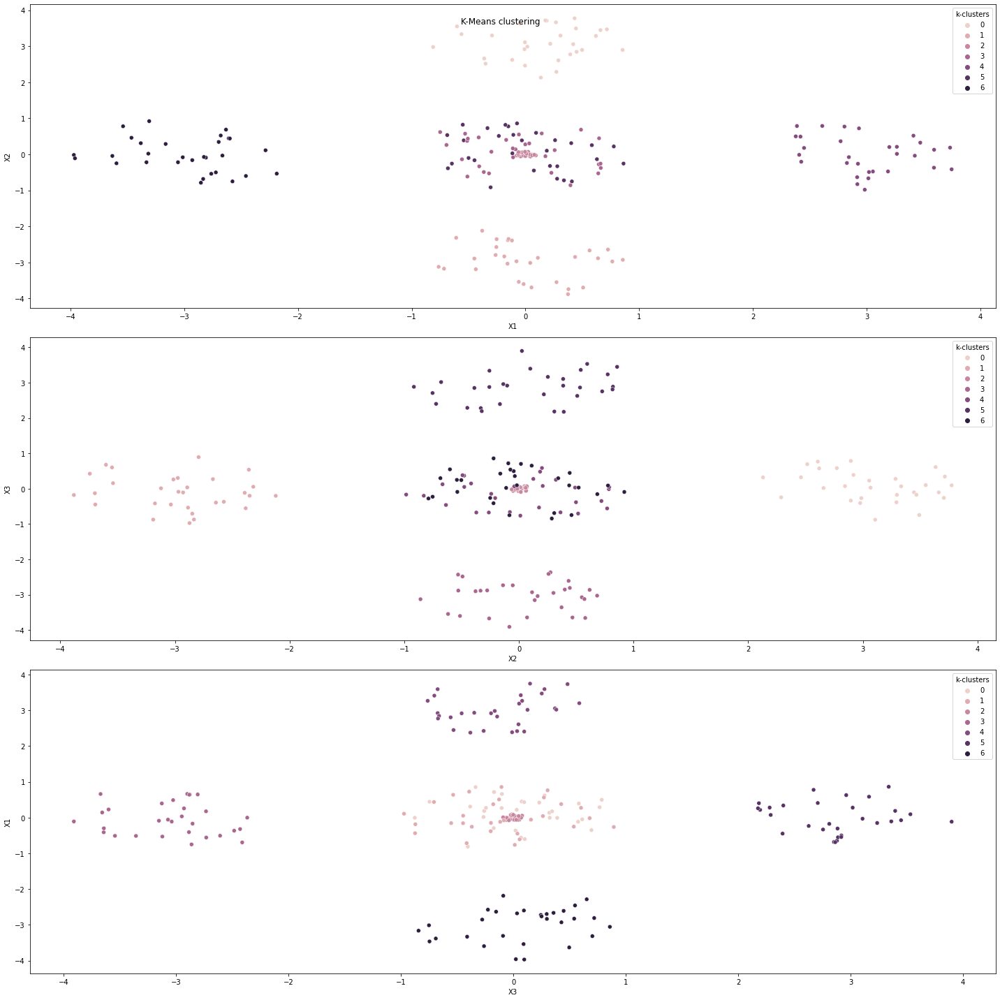

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('K-Means clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='k-clusters')

plt.subplot(3,1,3)
sns.scatterplot('X3','X1',data=df,hue='k-clusters')

plt.tight_layout()

# Task 1: Dataset2

In [ ]:
import pandas as pd
import numpy as np
from numpy import where
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [ ]:
from google.colab import files
up = files.upload()

Saving Data2.csv to Data2.csv


In [ ]:
#Importing the datasets
df1 = pd.read_csv('/content/Data2.csv')

In [ ]:
df1.head()

,Unnamed: 0,X,Y,C,Class
0,X1,3.277701,0.814082,0.326574,1
1,X2,0.387577,0.176780,0.888046,1
2,X3,0.268546,0.582963,0.080981,1
3,X4,2.031145,0.244597,0.643921,1
4,X5,0.188677,0.461280,0.496633,1


In [ ]:
#brief of data
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 404 entries, 0 to 403
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  404 non-null    object 
 1   X           404 non-null    float64
 2   Y           404 non-null    float64
 3   C           404 non-null    float64
 4   Class       404 non-null    int64  
dtypes: float64(3), int64(1), object(1)
memory usage: 15.9+ KB


## Cleaning data 

we can drop column Unnamed: 0

In [ ]:
df1.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
#Brief stats
df1.describe()

,X,Y,C,Class
count,404.000000,404.000000,404.000000,404.000000
mean,1.933463,1.810708,1.124684,1.772277
std,1.103075,1.485172,0.898426,0.855648
min,0.029780,0.004658,-0.151982,1.000000
25%,0.967144,0.532077,0.454854,1.000000
50%,1.727904,1.602773,0.786504,2.000000
75%,2.910134,2.756231,1.766672,3.000000
max,4.229498,5.385811,3.388138,4.000000


In [ ]:
#Skewness
df1.skew()

X        0.145023
Y        0.667939
C        0.876634
Class    0.550695
dtype: float64

skewness is in acceptable range

In [ ]:
#Checking the class column
df1['Class'].value_counts()

1    200
2    100
3    100
4      4
Name: Class, dtype: int64

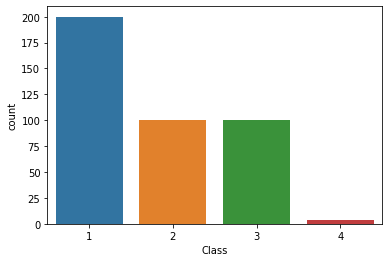

In [ ]:
#Seeing visually
sns.countplot(df1['Class'])

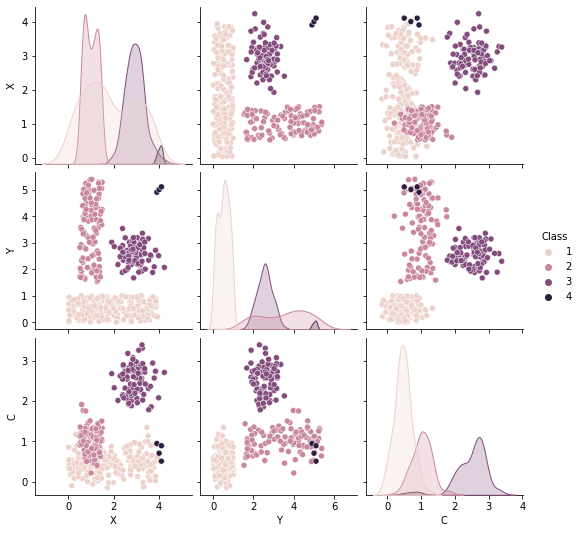

In [ ]:
#Viewing how the clusters are in original
sns.pairplot(df1,hue='Class')

## Task 1.1
- Cluster the dataset based on K-Means & Hierarchial 

making data ready for clustering

In [ ]:
df = df1.drop('Class',axis=1)
df.head()

,X,Y,C
0,3.277701,0.814082,0.326574
1,0.387577,0.176780,0.888046
2,0.268546,0.582963,0.080981
3,2.031145,0.244597,0.643921
4,0.188677,0.461280,0.496633


In [ ]:
df2 = df.to_numpy()
y=df1['Class']

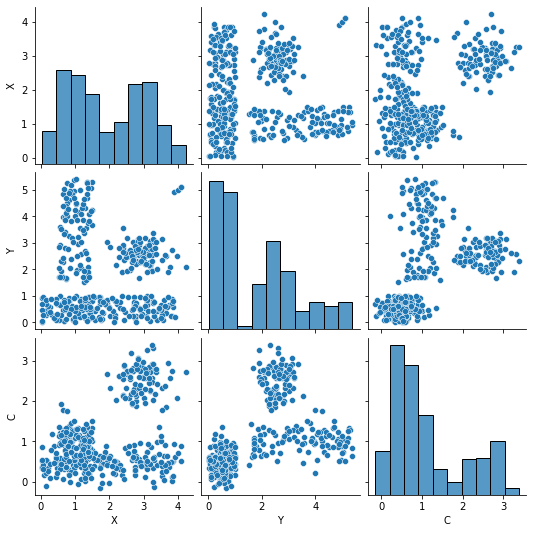

In [ ]:
sns.pairplot(df)

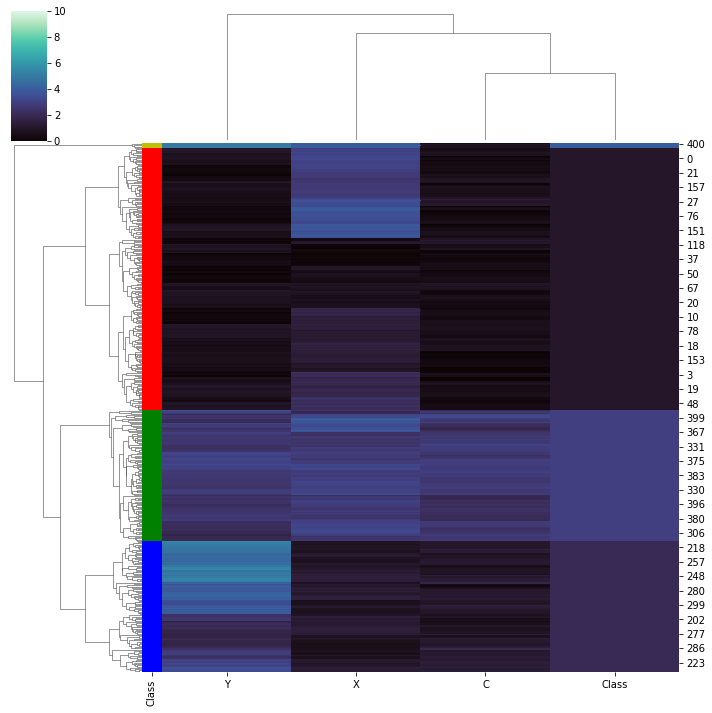

In [ ]:
ut = dict(zip(df1['Class'].unique(), "rbgyrbg"))
row_colors = df1['Class'].map(ut)
g = sns.clustermap(df1, row_colors=row_colors,cmap="mako", vmin=0, vmax=10)

#### Hierarchial clustering

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
df.head()

,X,Y,C
0,3.277701,0.814082,0.326574
1,0.387577,0.176780,0.888046
2,0.268546,0.582963,0.080981
3,2.031145,0.244597,0.643921
4,0.188677,0.461280,0.496633


Trying different linkage techniques

Single linkage

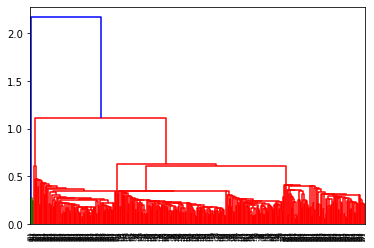

In [ ]:
#Single linkage
mergings = linkage(df,method='single',metric='euclidean')
dendrogram(mergings)
plt.show()

No better understanding

Complete linkage

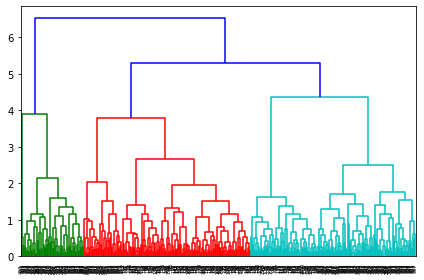

In [ ]:
#complete linkage
mergings = linkage(df,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 3

ward linkage

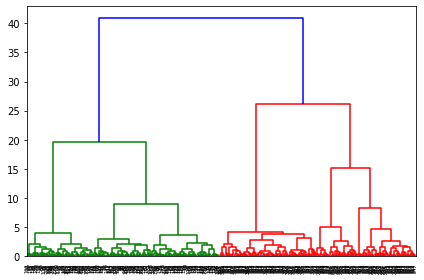

In [ ]:
mergings = linkage(df,method='ward',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

we can split into 4 categories

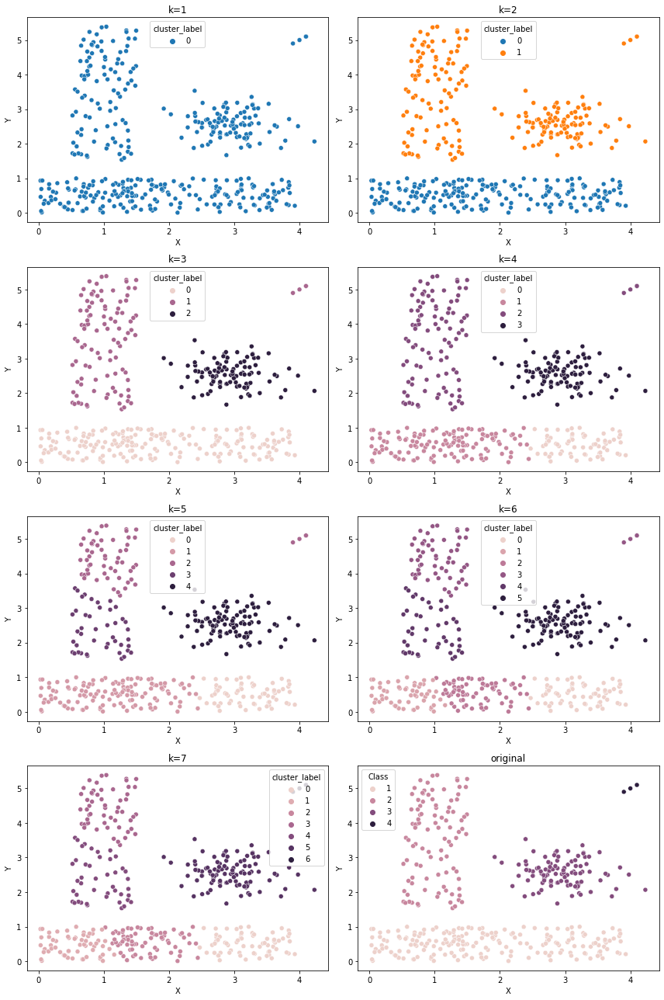

In [ ]:
plt.figure(figsize=(12,18))
for i in range(1,8):
    
    #Cutting the tree into clusters
    cluster_labels = cut_tree(mergings,n_clusters=i)
    cluster_labels=cluster_labels.reshape(-1, )
    df['cluster_label'] = cluster_labels
    
    #plotting 
    plt.subplot(4,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X','Y',data=df,hue='cluster_label')

plt.subplot(4,2,8)
plt.title('original')
sns.scatterplot('X','Y',data=df1,hue='Class')
plt.tight_layout()

We can see k = 3 have similar results as of original

In [ ]:
#so we will split into 4 categories
cluster_labels = cut_tree(mergings,n_clusters=4)
cluster_labels=cluster_labels.reshape(-1, )
df['cluster_label'] = cluster_labels
df

,X,Y,C,cluster_label
0,3.277701,0.814082,0.326574,0
1,0.387577,0.176780,0.888046,1
2,0.268546,0.582963,0.080981,1
3,2.031145,0.244597,0.643921,1
4,0.188677,0.461280,0.496633,1
...,...,...,...,...
399,3.248655,2.297291,3.388138,3
400,4.100000,5.100000,0.504558,2
401,3.900000,4.900000,0.941634,2
402,4.000000,5.000000,0.702123,2


#### K-Means clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df)
    
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 960.2381451832548
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 569.7527010136079
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 306.13431345572246
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 219.97243654925848
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 180.1403999408455
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 144.76503756727737
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 127.90825390751537
---------

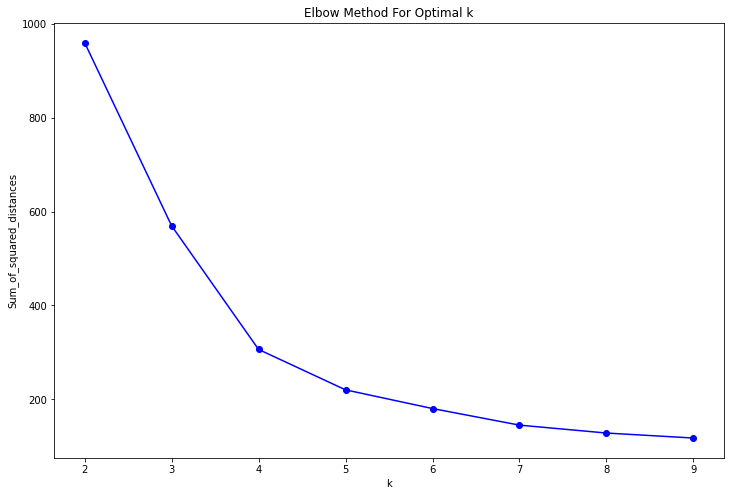

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bo-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this we can see,we can make cluster at 4

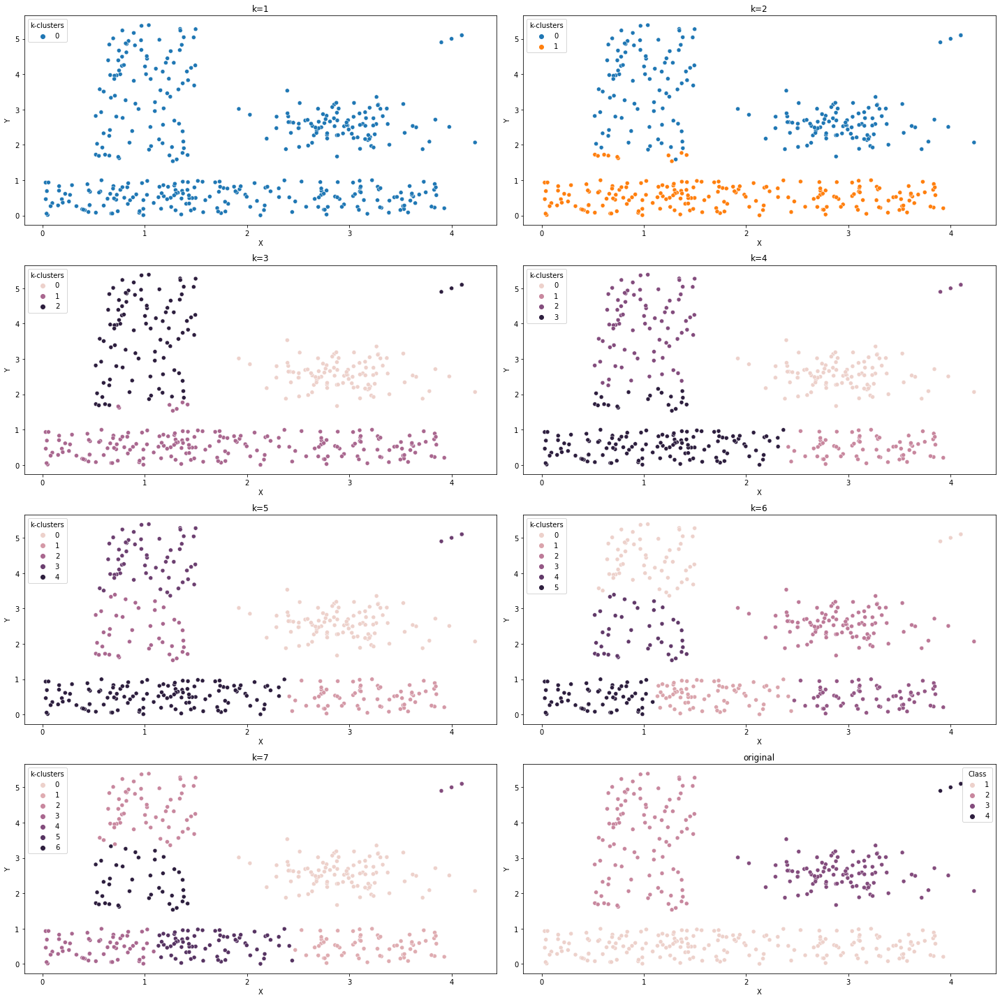

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,8):
    
    #Cutting the tree into clusters
    kmean = KMeans(n_clusters = i)
    kmean.fit(df.iloc[:,:-1])
    df['k-clusters'] = kmean.labels_
    
    #plotting 
    plt.subplot(4,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X','Y',data=df,hue='k-clusters')

plt.subplot(4,2,8)
plt.title('original')
sns.scatterplot('X','Y',data=df1,hue='Class')
plt.tight_layout()

cluster 4 is looking optimum

In [ ]:
#so we will split into 4 categories
kmean = KMeans(n_clusters=4)
kmean.fit(df.iloc[:,:-2])
df['k-clusters'] = kmean.labels_
df

,X,Y,C,cluster_label,k-clusters
0,3.277701,0.814082,0.326574,0,3
1,0.387577,0.176780,0.888046,1,1
2,0.268546,0.582963,0.080981,1,1
3,2.031145,0.244597,0.643921,1,3
4,0.188677,0.461280,0.496633,1,1
...,...,...,...,...,...
399,3.248655,2.297291,3.388138,3,2
400,4.100000,5.100000,0.504558,2,0
401,3.900000,4.900000,0.941634,2,0
402,4.000000,5.000000,0.702123,2,0


In [ ]:
df['original']=df1['Class']
df

,X,Y,C,cluster_label,k-clusters,original
0,3.277701,0.814082,0.326574,0,3,1
1,0.387577,0.176780,0.888046,1,1,1
2,0.268546,0.582963,0.080981,1,1,1
3,2.031145,0.244597,0.643921,1,3,1
4,0.188677,0.461280,0.496633,1,1,1
...,...,...,...,...,...,...
399,3.248655,2.297291,3.388138,3,2,3
400,4.100000,5.100000,0.504558,2,0,4
401,3.900000,4.900000,0.941634,2,0,4
402,4.000000,5.000000,0.702123,2,0,4


In [ ]:
df['original']=df['original']-1

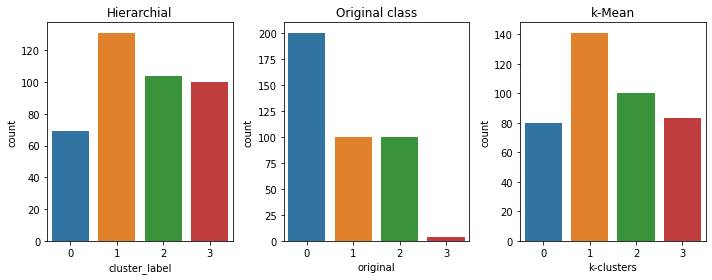

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,3,1)
sns.countplot(df['cluster_label'])
plt.title('Hierarchial')

plt.subplot(1,3,2)
sns.countplot(df['original'])
plt.title('Original class')


plt.subplot(1,3,3)
sns.countplot(df['k-clusters'])
plt.title('k-Mean')


plt.tight_layout()


from this we can see k-means predicted/ divided correctly than hierarchial

### External Validation

Techniques:
   - Classification accuracy
   - Purity
   - Precision
   - Recall
   - F-Measured
   - Jaccard
   - Rand index
   - Fowlkes Mallows
   - Hubert statistics
   - Entropy 
   - Mutual Information

https://drive.google.com/file/d/1GDHY6iojk0PASg1D5HGdyoCfPvVOZ68z/view?usp=sharing

Through above link math equations for validation metrics can be viewed

##### Rand index:

In [ ]:
from sklearn import metrics

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Rand Index of')
print('Hierarchial clustering:',metrics.rand_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.rand_score(label_true, k_pred),2))

Rand Index of
Hierarchial clustering: 0.8840503157015454
K_Means clustering: 0.82


#### Mutual Information

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Mutual Information of')
print('Hierarchial clustering:',metrics.adjusted_mutual_info_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.adjusted_mutual_info_score(label_true, k_pred),2))


Mutual Information of
Hierarchial clustering: 0.8510276117074034
K_Means clustering: 0.72


#### Homogenity & Completeness

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Homogenity & Completeness of')
print('Hierarchial clustering, Homogenity:',metrics.homogeneity_score(label_true, h_pred))
print('Hierarchial clustering, completeness:',metrics.completeness_score(label_true, h_pred))

print('K_Means clustering,Homogenity:',round(metrics.homogeneity_score(label_true, k_pred),2))
print('K_Means clustering, completeness:',round(metrics.completeness_score(label_true, k_pred),2))



Homogenity & Completeness of
Hierarchial clustering, Homogenity: 0.9613202401492158
Hierarchial clustering, completeness: 0.7658099355152417
K_Means clustering,Homogenity: 0.82
K_Means clustering, completeness: 0.65


#### Fowlkes Mallows Score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Fowlkes Mallows of')
print('Hierarchial clustering:',metrics.fowlkes_mallows_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.fowlkes_mallows_score(label_true, k_pred),2))


Fowlkes Mallows of
Hierarchial clustering: 0.8267843729687627
K_Means clustering: 0.72


#### Jaccard score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Jaccard score of')
print('Hierarchial clustering:',metrics.jaccard_score(label_true, h_pred,average='weighted'))
print('K_Means clustering:',round(metrics.jaccard_score(label_true, k_pred,average='weighted'),2))


Jaccard score of
Hierarchial clustering: 0.1707920792079208
K_Means clustering: 0.27


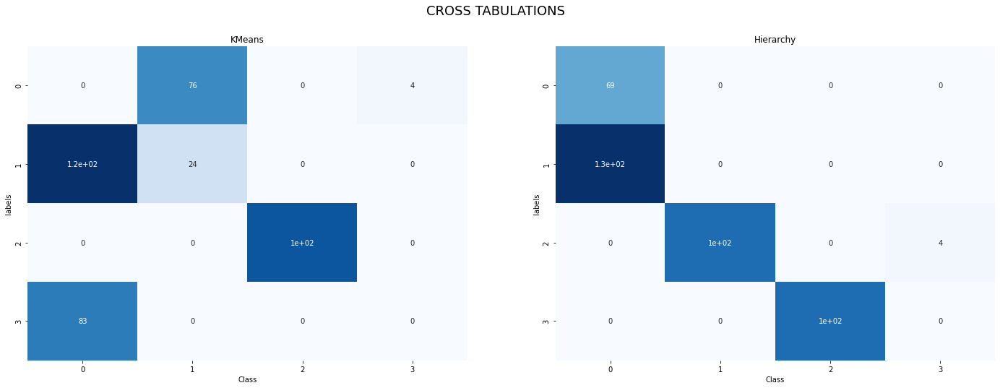

In [ ]:
h_pred = df['cluster_label']
k_pred = df['k-clusters']

# cross tabulation table for kmeans
df_k = pd.DataFrame({'labels':k_pred,"Class":df['original']})
ct1 = pd.crosstab(df_k['labels'],df_k['Class'])

# cross tabulation table for Hierarchy
df_h = pd.DataFrame({'labels':h_pred,"Class":df['original']})
ct2 = pd.crosstab(df_h['labels'],df_h['Class'])


plt.figure(figsize=(24,8))
plt.suptitle("CROSS TABULATIONS",fontsize=18)
plt.subplot(1,2,1)
plt.title("KMeans")
sns.heatmap(ct1,annot=True,cbar=False,cmap="Blues")

plt.subplot(1,2,2)
plt.title("Hierarchy")
sns.heatmap(ct2,annot=True,cbar=False,cmap="Blues")

plt.show()

We can see in hierarchy it is predicting correctly

In [ ]:
from sklearn.metrics.cluster import pair_confusion_matrix

In [ ]:
print('Hierarchial clustering:')
pair_confusion_matrix(label_true, h_pred)

Hierarchial clustering:


array([[102400,    800],
       [ 18078,  41534]])

In [ ]:
print('K_Means clustering:')
pair_confusion_matrix(label_true, k_pred)

K_Means clustering:


array([[96976,  6224],
       [23070, 36542]])

In [ ]:
#Accuracy score

print('Accuracy score of  Hierarchial clustering:',metrics.accuracy_score(label_true, h_pred))
print('Accuracy score of K_Means clustering:',metrics.accuracy_score(label_true, k_pred))

Accuracy score of  Hierarchial clustering: 0.1707920792079208
Accuracy score of K_Means clustering: 0.3069306930693069


In [ ]:
#Classification report
print('Classification report of  Hierarchial clustering:\n',metrics.classification_report(label_true, h_pred))
print('Classification report of K_Means clustering:\n',metrics.classification_report(label_true, k_pred))

Classification report of  Hierarchial clustering:
               precision    recall  f1-score   support

           0       1.00      0.34      0.51       200
           1       0.00      0.00      0.00       100
           2       0.00      0.00      0.00       100
           3       0.00      0.00      0.00         4

    accuracy                           0.17       404
   macro avg       0.25      0.09      0.13       404
weighted avg       0.50      0.17      0.25       404

Classification report of K_Means clustering:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       200
           1       0.17      0.24      0.20       100
           2       1.00      1.00      1.00       100
           3       0.00      0.00      0.00         4

    accuracy                           0.31       404
   macro avg       0.29      0.31      0.30       404
weighted avg       0.29      0.31      0.30       404



## Ploting the graph:

#### 1.3 : Plot of data points according to original class

In [ ]:
df.columns

Index(['X', 'Y', 'C', 'cluster_label', 'k-clusters', 'original'], dtype='object')

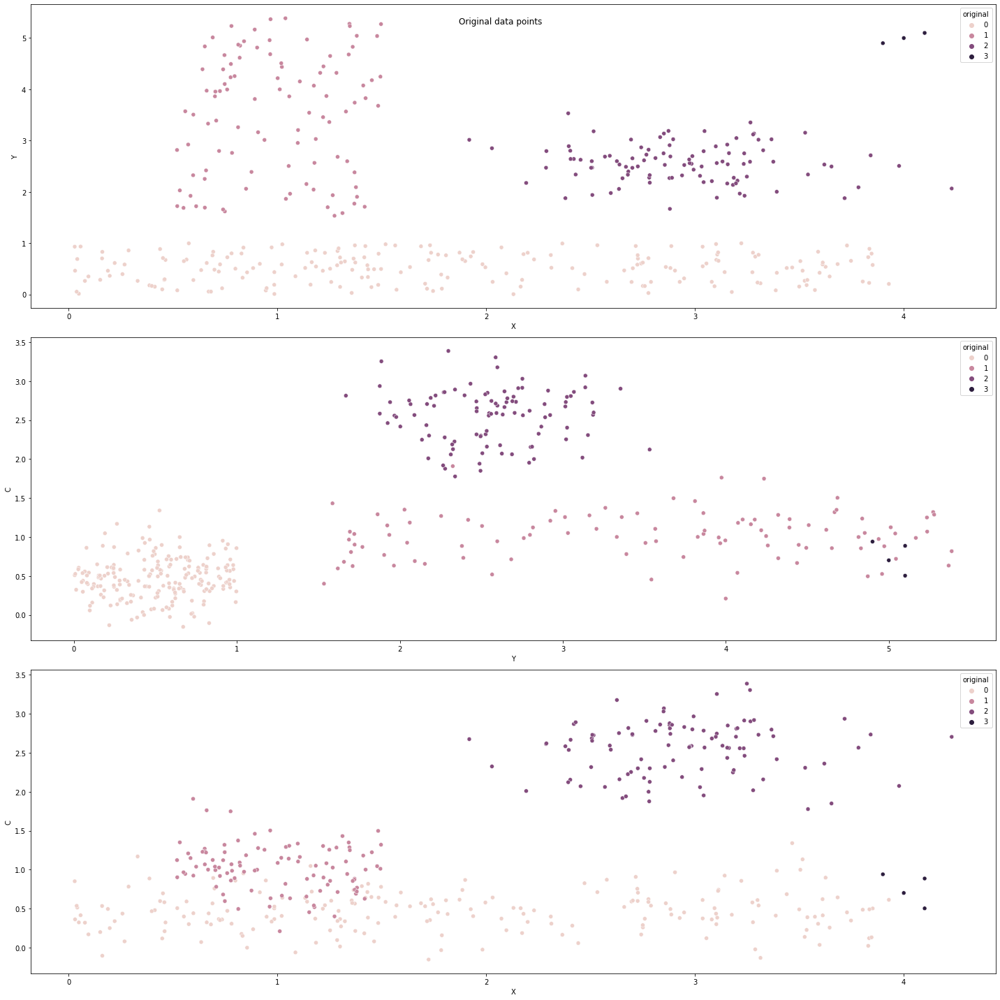

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

plt.subplot(3,1,1)
sns.scatterplot('X','Y',data=df,hue='original')

plt.subplot(3,1,2)
sns.scatterplot('Y','C',data=df,hue='original')

plt.subplot(3,1,3)
sns.scatterplot('X','C',data=df,hue='original')

plt.tight_layout()

#### 1.4 : Plot of data points according to class by algorithm

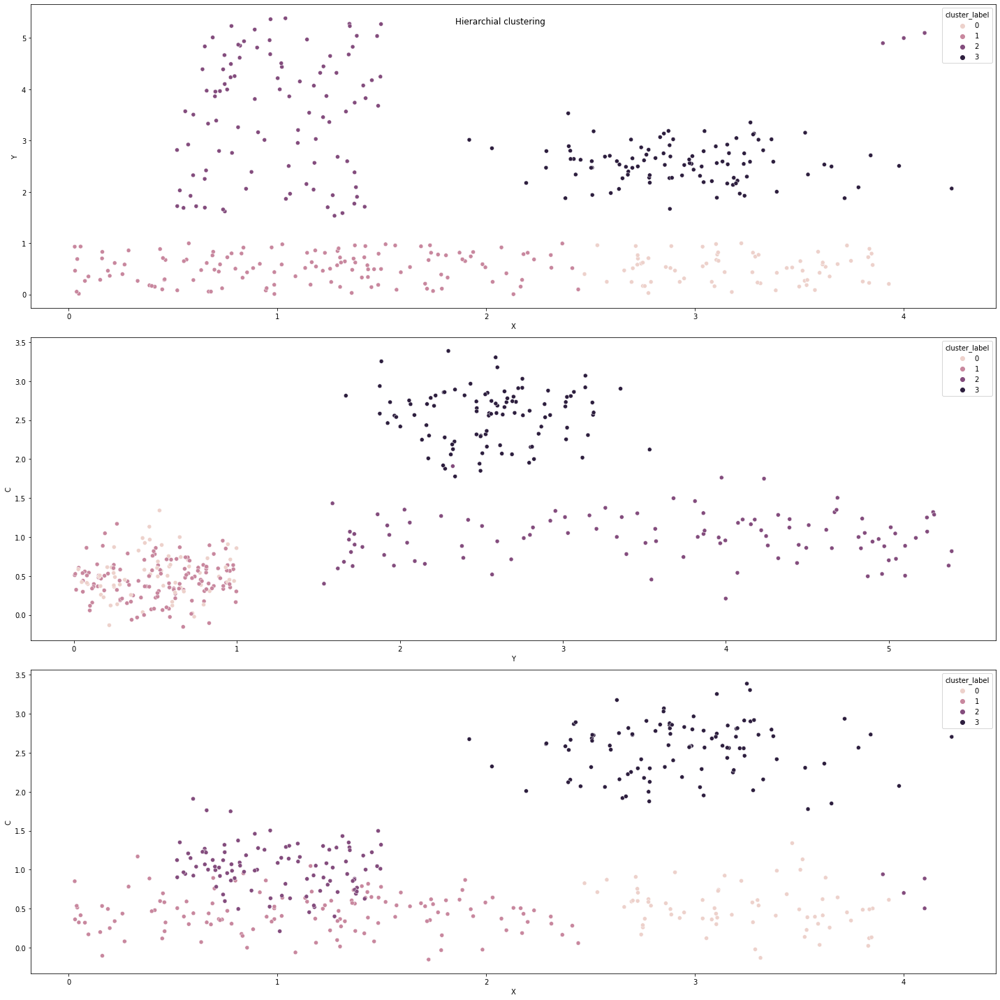

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Hierarchial clustering')

plt.subplot(3,1,1)
sns.scatterplot('X','Y',data=df,hue='cluster_label')

plt.subplot(3,1,2)
sns.scatterplot('Y','C',data=df,hue='cluster_label')

plt.subplot(3,1,3)
sns.scatterplot('X','C',data=df,hue='cluster_label')

plt.tight_layout()

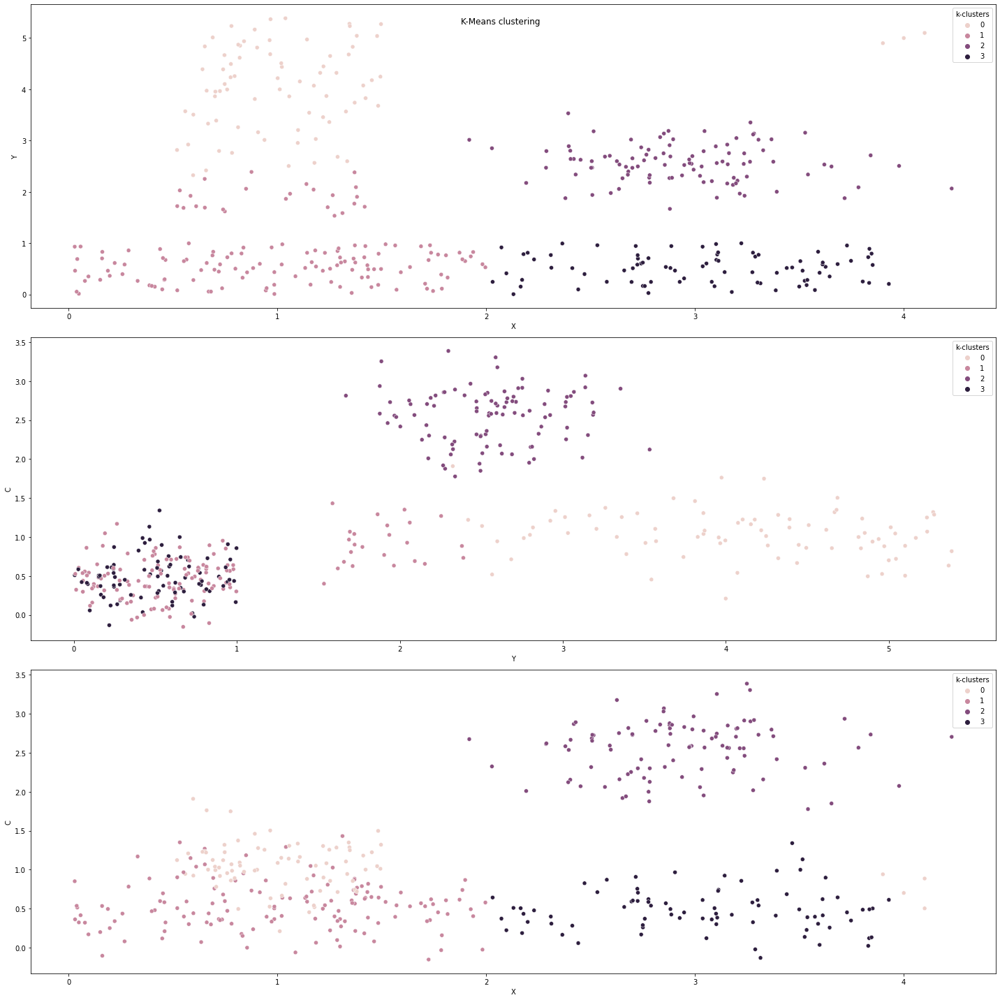

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('K-Means clustering')

plt.subplot(3,1,1)
sns.scatterplot('X','Y',data=df,hue='k-clusters')

plt.subplot(3,1,2)
sns.scatterplot('Y','C',data=df,hue='k-clusters')

plt.subplot(3,1,3)
sns.scatterplot('X','C',data=df,hue='k-clusters')

plt.tight_layout()

# Task 1 : Dataset3

In [ ]:
import pandas as pd
import numpy as np
from numpy import where
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [ ]:
from google.colab import files
up = files.upload()


Saving Data3.csv to Data3.csv


In [ ]:
#Importing the datasets
df1 = pd.read_csv('/content/Data3.csv')

In [ ]:
df1.head()

,Unnamed: 0,X1,X2,X3,Class
0,1,1.295428,0.050829,-0.385217,1
1,2,1.409178,-0.035191,-0.251980,1
2,3,1.096803,0.246365,-0.415011,1
3,4,1.463328,0.265354,-0.513488,1
4,5,1.603284,0.080577,-0.470257,1


In [ ]:
#brief of data
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  400 non-null    int64  
 1   X1          400 non-null    float64
 2   X2          400 non-null    float64
 3   X3          400 non-null    float64
 4   Class       400 non-null    int64  
dtypes: float64(3), int64(2)
memory usage: 15.8 KB


## Cleaning data 

we can drop column Unnamed: 0

In [ ]:
df1.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
#Brief stats
df1.describe()

,X1,X2,X3,Class
count,400.000000,400.000000,400.000000,400.000000
mean,0.116703,-0.065265,0.023340,2.500000
std,0.893028,0.890075,0.896590,1.119434
min,-1.481394,-2.080121,-1.341069,1.000000
25%,-0.496078,-0.719790,-0.622889,1.750000
50%,-0.036501,-0.036603,-0.246845,2.500000
75%,0.714768,0.568605,0.445541,3.250000
max,2.090848,1.991350,2.238607,4.000000


In [ ]:
#Skewness
df1.skew()

X1       0.505746
X2       0.008985
X3       0.745910
Class    0.000000
dtype: float64

skewness is in acceptable range

In [ ]:
#Checking the class column
df1['Class'].value_counts()

1    100
2    100
3    100
4    100
Name: Class, dtype: int64

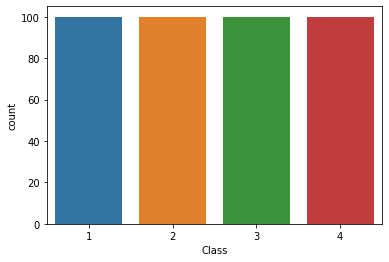

In [ ]:
#Seeing visually
sns.countplot(df1['Class'])

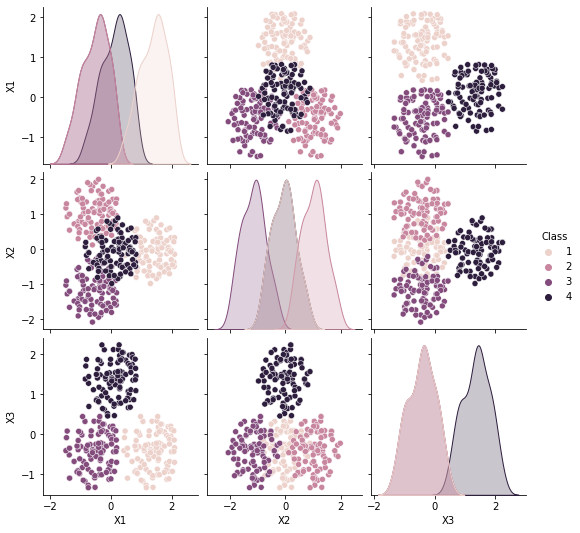

In [ ]:
#Viewing how the clusters are in original
sns.pairplot(df1,hue='Class')

## Task 1.1
- Cluster the dataset based on K-Means & Hierarchial 

making data ready for clustering

In [ ]:
df = df1.drop('Class',axis=1)
df.head()

,X1,X2,X3
0,1.295428,0.050829,-0.385217
1,1.409178,-0.035191,-0.251980
2,1.096803,0.246365,-0.415011
3,1.463328,0.265354,-0.513488
4,1.603284,0.080577,-0.470257


In [ ]:
df2 = df.to_numpy()
y=df1['Class']

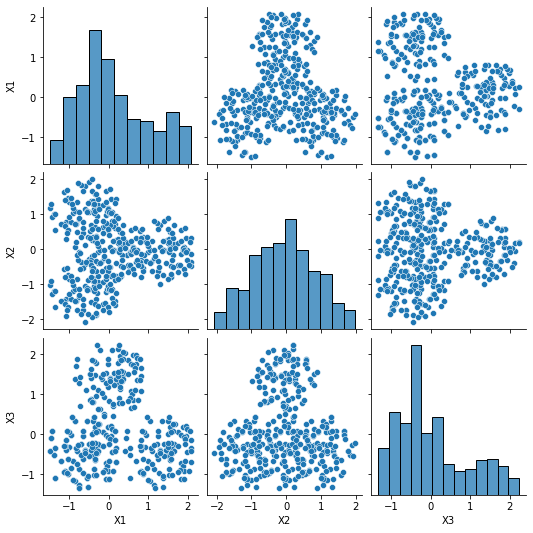

In [ ]:
sns.pairplot(df)

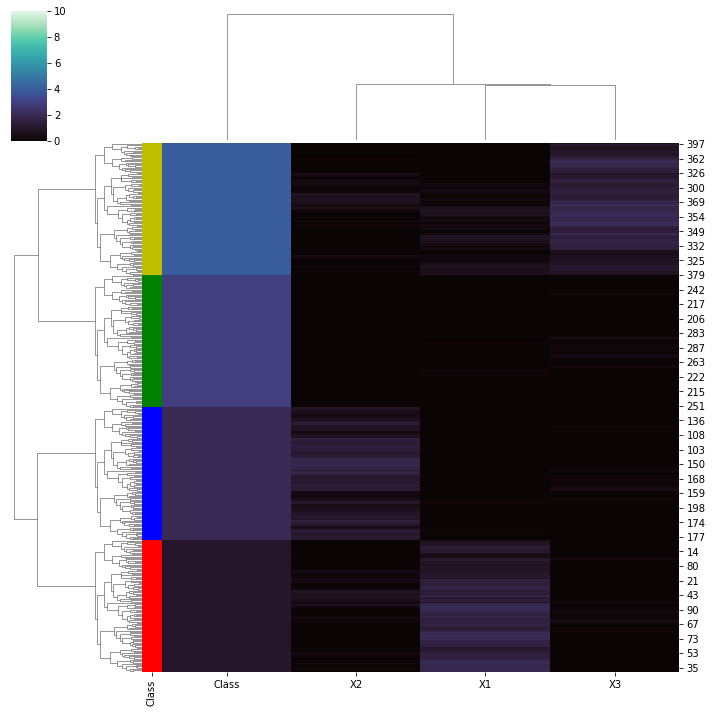

In [ ]:
ut = dict(zip(df1['Class'].unique(), "rbgyrbg"))
row_colors = df1['Class'].map(ut)
g = sns.clustermap(df1, row_colors=row_colors,cmap="mako", vmin=0, vmax=10)

#### Hierarchial clustering

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
df.head()

,X1,X2,X3
0,1.295428,0.050829,-0.385217
1,1.409178,-0.035191,-0.251980
2,1.096803,0.246365,-0.415011
3,1.463328,0.265354,-0.513488
4,1.603284,0.080577,-0.470257


Trying different linkage techniques

Single linkage

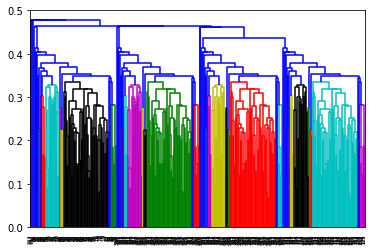

In [ ]:
#Single linkage
mergings = linkage(df,method='single',metric='euclidean')
dendrogram(mergings)
plt.show()

No better understanding

Complete linkage

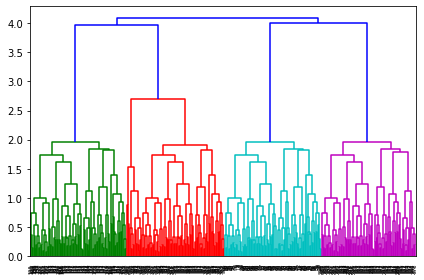

In [ ]:
#complete linkage
mergings = linkage(df,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 4

ward linkage

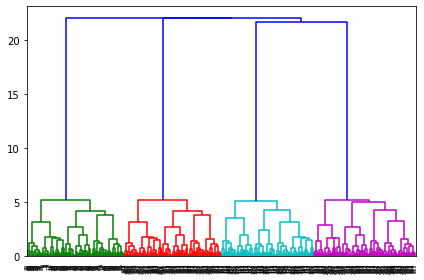

In [ ]:
mergings = linkage(df,method='ward',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

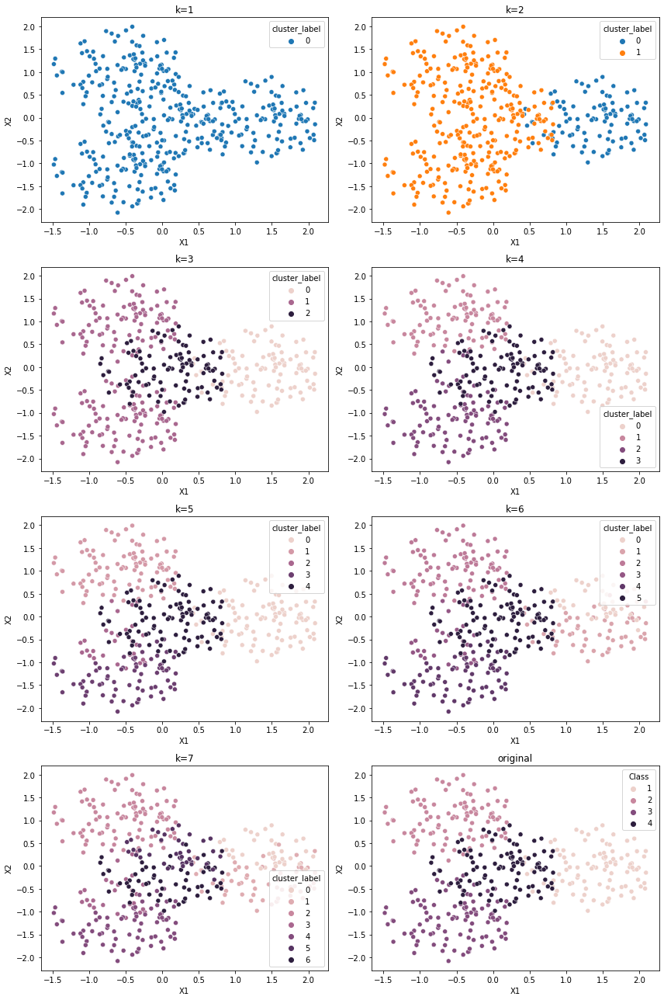

In [ ]:
plt.figure(figsize=(12,18))
for i in range(1,8):
    
    #Cutting the tree into clusters
    cluster_labels = cut_tree(mergings,n_clusters=i)
    cluster_labels=cluster_labels.reshape(-1, )
    df['cluster_label'] = cluster_labels
    
    #plotting 
    plt.subplot(4,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(4,2,8)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

We can see k = 4 have similar results as of original

In [ ]:
#so we will split into 4 categories
cluster_labels = cut_tree(mergings,n_clusters=4)
cluster_labels=cluster_labels.reshape(-1, )
df['cluster_label'] = cluster_labels
df

,X1,X2,X3,cluster_label
0,1.295428,0.050829,-0.385217,0
1,1.409178,-0.035191,-0.251980,0
2,1.096803,0.246365,-0.415011,0
3,1.463328,0.265354,-0.513488,0
4,1.603284,0.080577,-0.470257,0
...,...,...,...,...
395,0.795695,0.209456,1.880609,3
396,0.653127,-0.703156,1.549448,3
397,-0.726249,-0.103244,0.694300,3
398,0.808596,-0.492640,1.649370,3


#### K-Means clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df)
    
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 816.6603928382557
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 520.9238109751337
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 233.67682076892072
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 216.71833320880978
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 201.3317957668753
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 186.3866249686365
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 169.95188591582448
----------

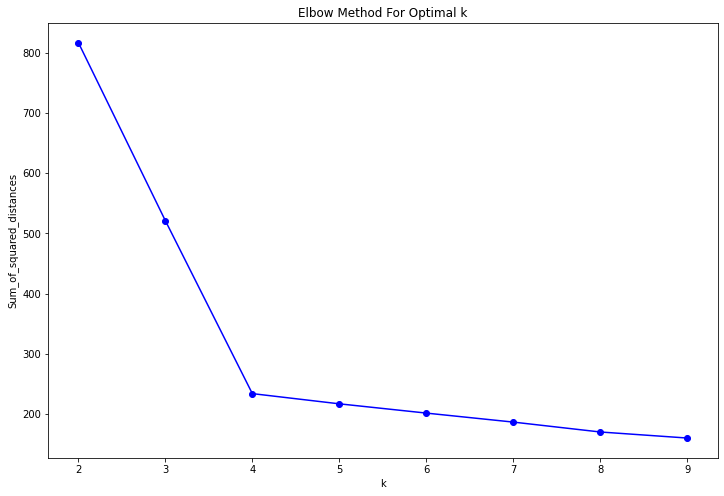

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bo-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this we can see,we can make cluster at 4

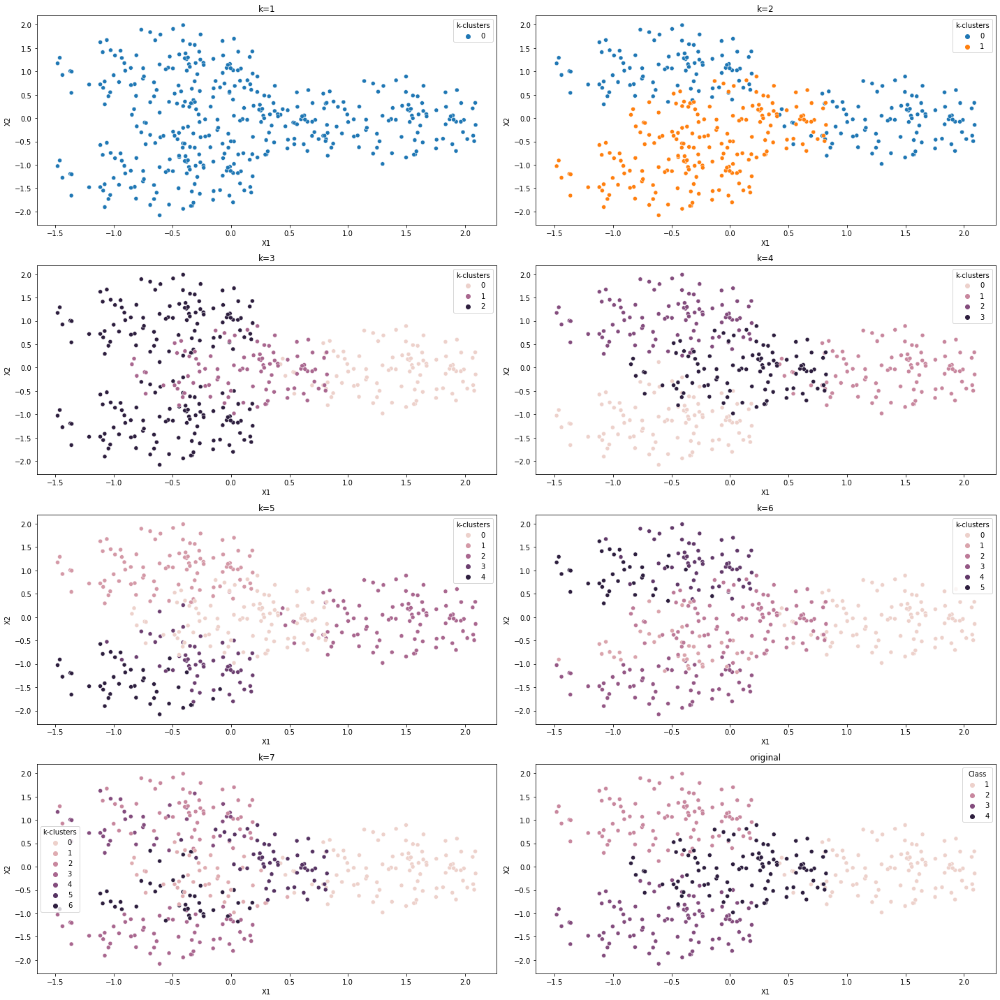

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,8):
    
    #Cutting the tree into clusters
    kmean = KMeans(n_clusters = i)
    kmean.fit(df.iloc[:,:-1])
    df['k-clusters'] = kmean.labels_
    
    #plotting 
    plt.subplot(4,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(4,2,8)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

cluster 4 is looking optimum

In [ ]:
#so we will split into 4 categories
kmean = KMeans(n_clusters=4)
kmean.fit(df.iloc[:,:-2])
df['k-clusters'] = kmean.labels_
df

,X1,X2,X3,cluster_label,k-clusters
0,1.295428,0.050829,-0.385217,0,1
1,1.409178,-0.035191,-0.251980,0,1
2,1.096803,0.246365,-0.415011,0,1
3,1.463328,0.265354,-0.513488,0,1
4,1.603284,0.080577,-0.470257,0,1
...,...,...,...,...,...
395,0.795695,0.209456,1.880609,3,3
396,0.653127,-0.703156,1.549448,3,3
397,-0.726249,-0.103244,0.694300,3,3
398,0.808596,-0.492640,1.649370,3,3


In [ ]:
df['original']=df1['Class']
df

,X1,X2,X3,cluster_label,k-clusters,original
0,1.295428,0.050829,-0.385217,0,1,1
1,1.409178,-0.035191,-0.251980,0,1,1
2,1.096803,0.246365,-0.415011,0,1,1
3,1.463328,0.265354,-0.513488,0,1,1
4,1.603284,0.080577,-0.470257,0,1,1
...,...,...,...,...,...,...
395,0.795695,0.209456,1.880609,3,3,4
396,0.653127,-0.703156,1.549448,3,3,4
397,-0.726249,-0.103244,0.694300,3,3,4
398,0.808596,-0.492640,1.649370,3,3,4


In [ ]:
df['original']=df['original']-1

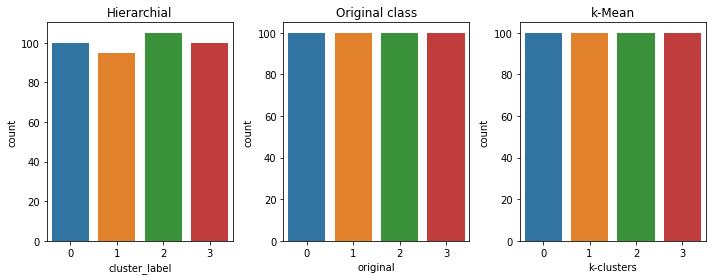

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,3,1)
sns.countplot(df['cluster_label'])
plt.title('Hierarchial')

plt.subplot(1,3,2)
sns.countplot(df['original'])
plt.title('Original class')


plt.subplot(1,3,3)
sns.countplot(df['k-clusters'])
plt.title('k-Mean')


plt.tight_layout()


from this we can see k-means predicted/ divided correctly than hierarchial

1.2 : External Validation

Techniques:
   - Classification accuracy
   - Purity
   - Precision
   - Recall
   - F-Measured
   - Jaccard
   - Rand index
   - Fowlkes Mallows
   - Hubert statistics
   - Entropy 
   - Mutual Information

https://drive.google.com/file/d/1GDHY6iojk0PASg1D5HGdyoCfPvVOZ68z/view?usp=sharing

Through above link math equations for validation metrics can be viewed

##### Rand index:

In [ ]:
from sklearn import metrics

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Rand Index of')
print('Hierarchial clustering:',metrics.rand_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.rand_score(label_true, k_pred),2))

Rand Index of
Hierarchial clustering: 0.9877819548872181
K_Means clustering: 1.0


#### Mutual Information

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Mutual Information of')
print('Hierarchial clustering:',metrics.adjusted_mutual_info_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.adjusted_mutual_info_score(label_true, k_pred),2))


Mutual Information of
Hierarchial clustering: 0.9636686786293006
K_Means clustering: 1.0


#### Homogenity & Completeness

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Homogenity & Completeness of')
print('Hierarchial clustering, Homogenity:',metrics.homogeneity_score(label_true, h_pred))
print('Hierarchial clustering, completeness:',metrics.completeness_score(label_true, h_pred))

print('K_Means clustering,Homogenity:',round(metrics.homogeneity_score(label_true, k_pred),2))
print('K_Means clustering, completeness:',round(metrics.completeness_score(label_true, k_pred),2))



Homogenity & Completeness of
Hierarchial clustering, Homogenity: 0.9637493501212084
Hierarchial clustering, completeness: 0.9641842263635518
K_Means clustering,Homogenity: 1.0
K_Means clustering, completeness: 1.0


#### Fowlkes Mallows Score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Fowlkes Mallows of')
print('Hierarchial clustering:',metrics.fowlkes_mallows_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.fowlkes_mallows_score(label_true, k_pred),2))


Fowlkes Mallows of
Hierarchial clustering: 0.9753945158961902
K_Means clustering: 1.0


#### Jaccard score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Jaccard score of')
print('Hierarchial clustering:',metrics.jaccard_score(label_true, h_pred,average='weighted'))
print('K_Means clustering:',round(metrics.jaccard_score(label_true, k_pred,average='weighted'),2))


Jaccard score of
Hierarchial clustering: 0.9755952380952381
K_Means clustering: 0.5


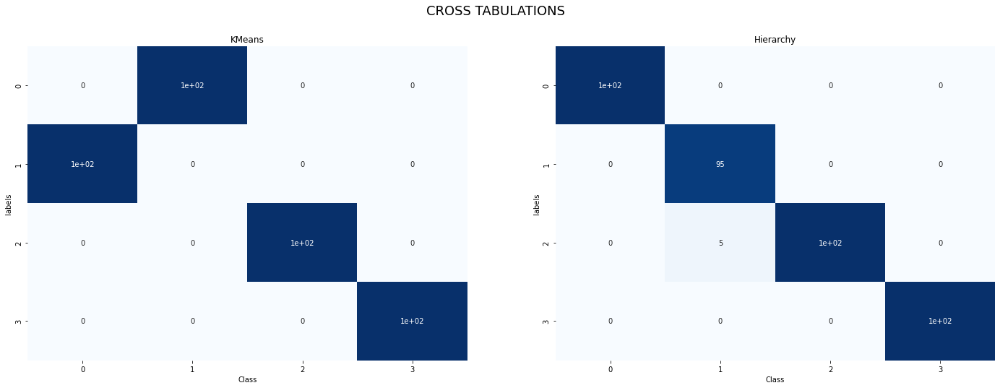

In [ ]:
h_pred = df['cluster_label']
k_pred = df['k-clusters']

# cross tabulation table for kmeans
df_k = pd.DataFrame({'labels':k_pred,"Class":df['original']})
ct1 = pd.crosstab(df_k['labels'],df_k['Class'])

# cross tabulation table for Hierarchy
df_h = pd.DataFrame({'labels':h_pred,"Class":df['original']})
ct2 = pd.crosstab(df_h['labels'],df_h['Class'])


plt.figure(figsize=(24,8))
plt.suptitle("CROSS TABULATIONS",fontsize=18)
plt.subplot(1,2,1)
plt.title("KMeans")
sns.heatmap(ct1,annot=True,cbar=False,cmap="Blues")

plt.subplot(1,2,2)
plt.title("Hierarchy")
sns.heatmap(ct2,annot=True,cbar=False,cmap="Blues")

plt.show()

We can see in hierarchy it is predicting correctly

In [ ]:
from sklearn.metrics.cluster import pair_confusion_matrix

In [ ]:
print('Hierarchial clustering:')
pair_confusion_matrix(label_true, h_pred)

Hierarchial clustering:


array([[119000,   1000],
       [   950,  38650]])

In [ ]:
print('K_Means clustering:')
pair_confusion_matrix(label_true, k_pred)

K_Means clustering:


array([[120000,      0],
       [     0,  39600]])

In [ ]:
#Accuracy score

print('Accuracy score of  Hierarchial clustering:',metrics.accuracy_score(label_true, h_pred))
print('Accuracy score of K_Means clustering:',metrics.accuracy_score(label_true, k_pred))

Accuracy score of  Hierarchial clustering: 0.9875
Accuracy score of K_Means clustering: 0.5


In [ ]:
#Classification report
print('Classification report of  Hierarchial clustering:\n',metrics.classification_report(label_true, h_pred))
print('Classification report of K_Means clustering:\n',metrics.classification_report(label_true, k_pred))

Classification report of  Hierarchial clustering:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       100
           1       1.00      0.95      0.97       100
           2       0.95      1.00      0.98       100
           3       1.00      1.00      1.00       100

    accuracy                           0.99       400
   macro avg       0.99      0.99      0.99       400
weighted avg       0.99      0.99      0.99       400

Classification report of K_Means clustering:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       100
           1       0.00      0.00      0.00       100
           2       1.00      1.00      1.00       100
           3       1.00      1.00      1.00       100

    accuracy                           0.50       400
   macro avg       0.50      0.50      0.50       400
weighted avg       0.50      0.50      0.50       400



From above observation we cn conclude K-Means clustering is working well

#### 1.3 : Plot of data points according to original class

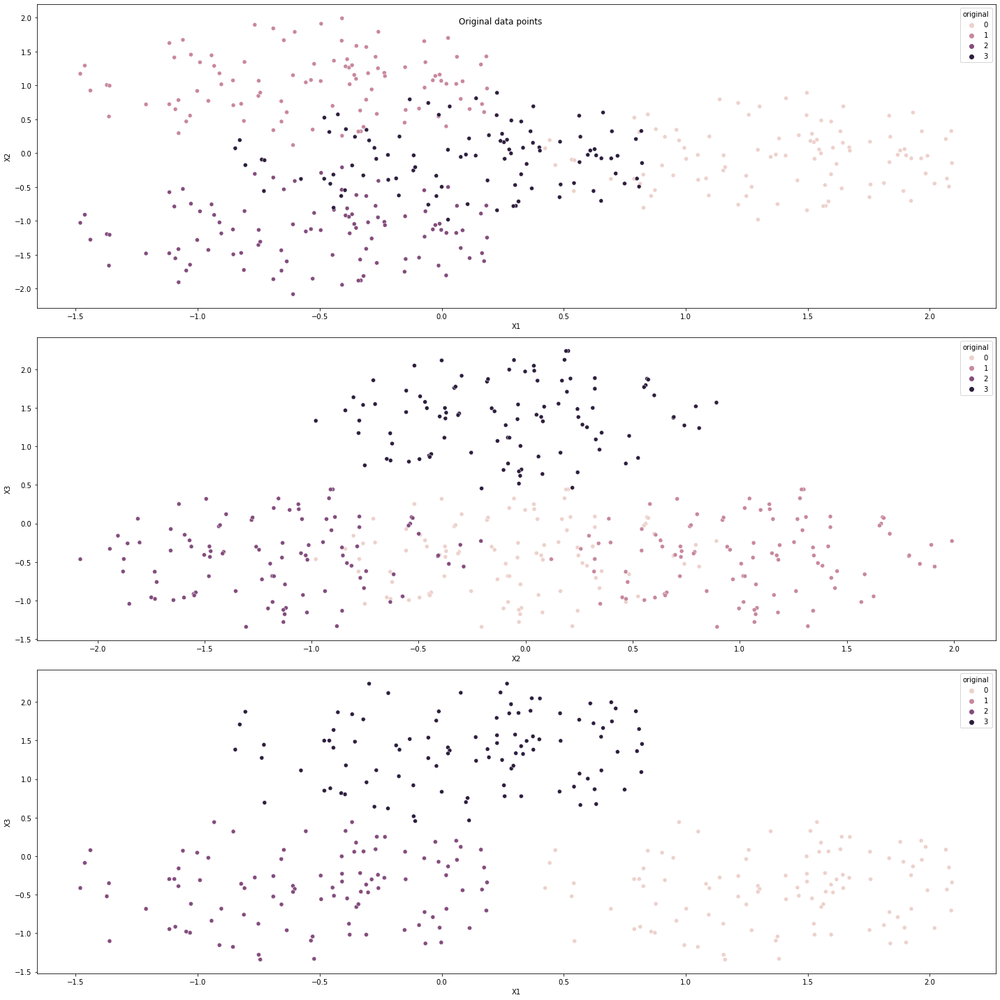

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='original')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='original')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='original')

plt.tight_layout()

#### 1.4 : Plot of data points according to class by algorithm

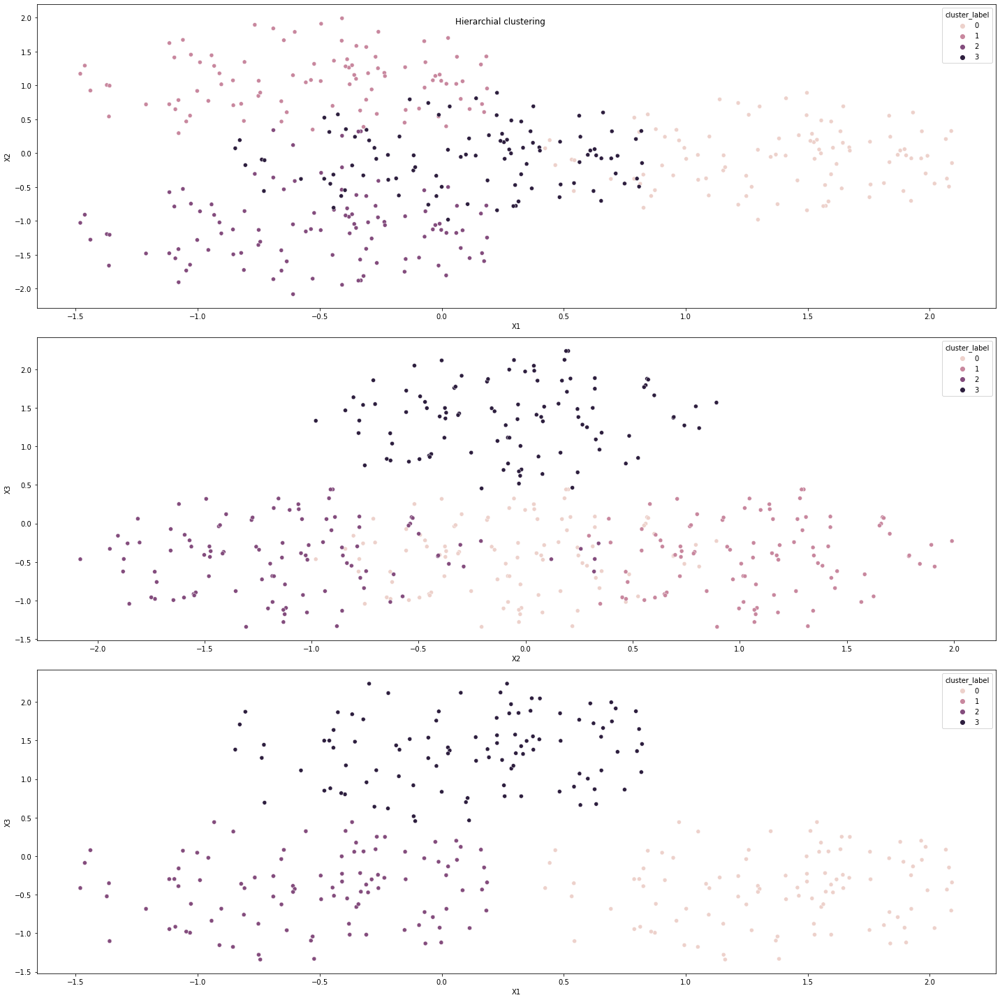

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Hierarchial clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='cluster_label')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='cluster_label')

plt.tight_layout()

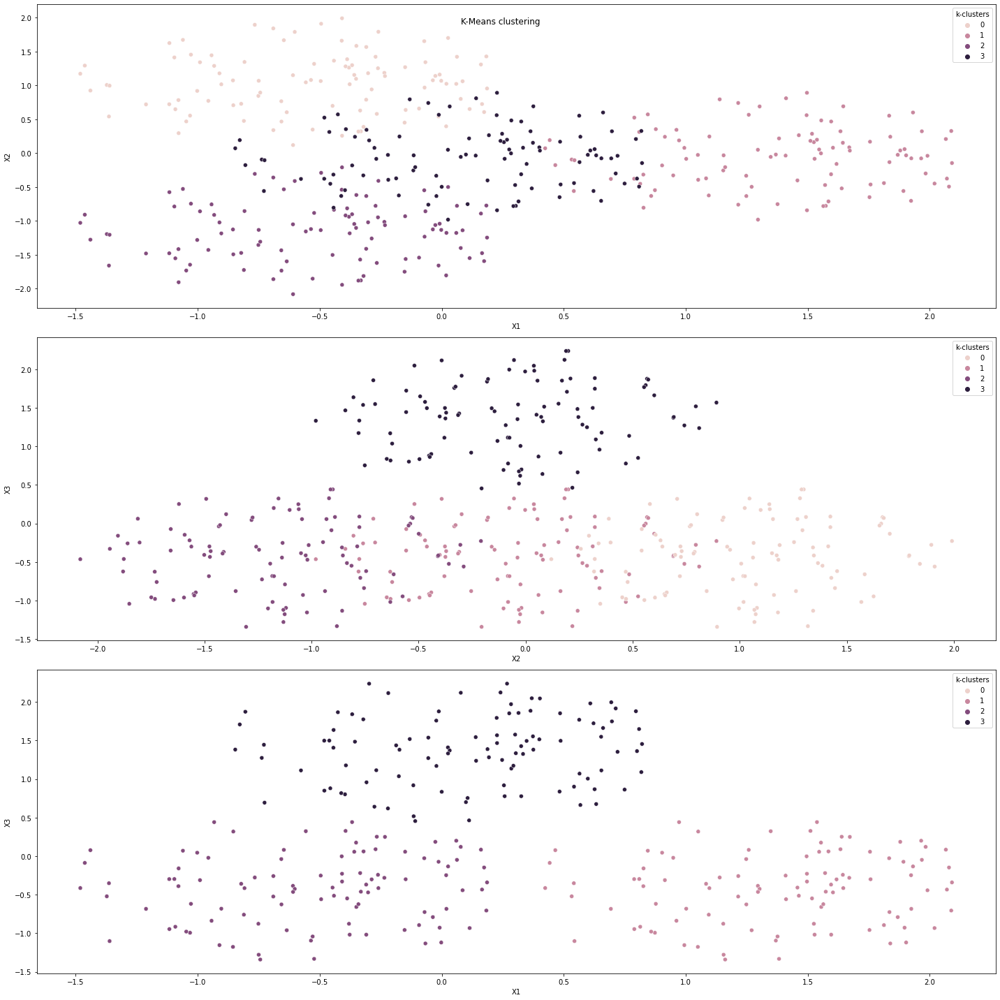

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('K-Means clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='k-clusters')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='k-clusters')

plt.tight_layout()

# Task 1 : Dataset4

In [ ]:
from google.colab import files
up = files.upload()


Saving Data4.csv to Data4 (1).csv


In [ ]:
#Importing the datasets
df1 = pd.read_csv('/content/Data4.csv')

In [ ]:
df1.head()

,Unnamed: 0,X1,X2,X3,Class
0,1,-0.4530,-0.891,0.02300,1
1,2,0.6530,-0.846,0.02110,1
2,3,0.3980,0.913,-0.00139,1
3,4,0.0952,1.050,0.00628,1
4,5,0.5240,-0.941,0.03780,1


In [ ]:
#brief of data
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  1000 non-null   int64  
 1   X1          1000 non-null   float64
 2   X2          1000 non-null   float64
 3   X3          1000 non-null   float64
 4   Class       1000 non-null   int64  
dtypes: float64(3), int64(2)
memory usage: 39.2 KB


## Cleaning data 

we can drop column Unnamed: 0

In [ ]:
df1.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
#Brief stats
df1.describe()

,X1,X2,X3,Class
count,1000.000000,1000.000000,1000.000000,1000.00000
mean,-0.007884,0.429842,-0.007884,1.50000
std,0.490354,0.875374,0.490354,0.50025
min,-1.070000,-1.080000,-1.070000,1.00000
25%,-0.083200,-0.181750,-0.083200,1.00000
50%,0.002615,0.426500,0.002615,1.50000
75%,0.081300,0.977000,0.081300,2.00000
max,1.070000,2.090000,1.070000,2.00000


In [ ]:
#Skewness
df1.skew()

X1      -0.048816
X2       0.089862
X3      -0.048816
Class    0.000000
dtype: float64

skewness is in acceptable range

In [ ]:
#Checking the class column
df1['Class'].value_counts()

1    500
2    500
Name: Class, dtype: int64

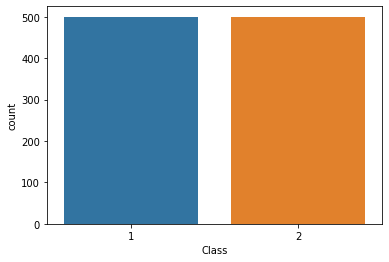

In [ ]:
#Seeing visually
sns.countplot(df1['Class'])

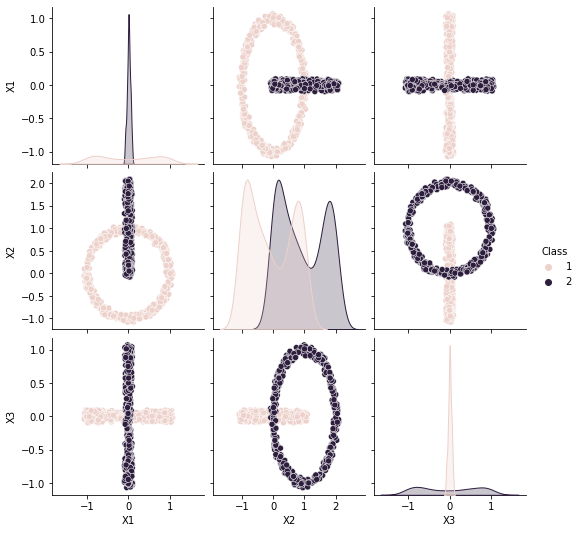

In [ ]:
#Viewing how the clusters are in original
sns.pairplot(df1,hue='Class')

## Task 1.1
- Cluster the dataset based on K-Means & Hierarchial 

making data ready for clustering

In [ ]:
df = df1.drop('Class',axis=1)
df.head()

,X1,X2,X3
0,-0.4530,-0.891,0.02300
1,0.6530,-0.846,0.02110
2,0.3980,0.913,-0.00139
3,0.0952,1.050,0.00628
4,0.5240,-0.941,0.03780


In [ ]:
df2 = df.to_numpy()
y=df1['Class']

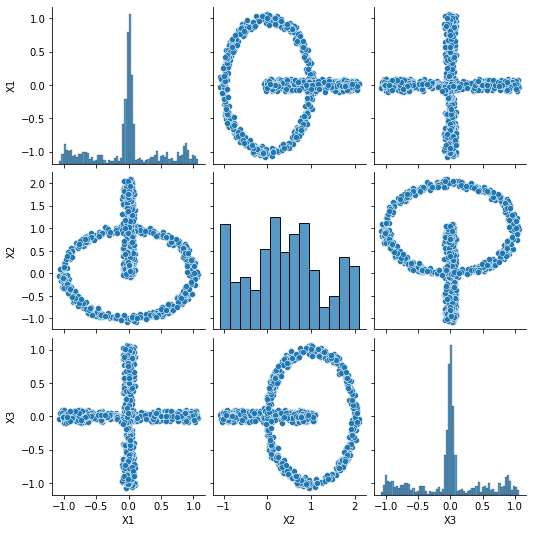

In [ ]:
sns.pairplot(df)

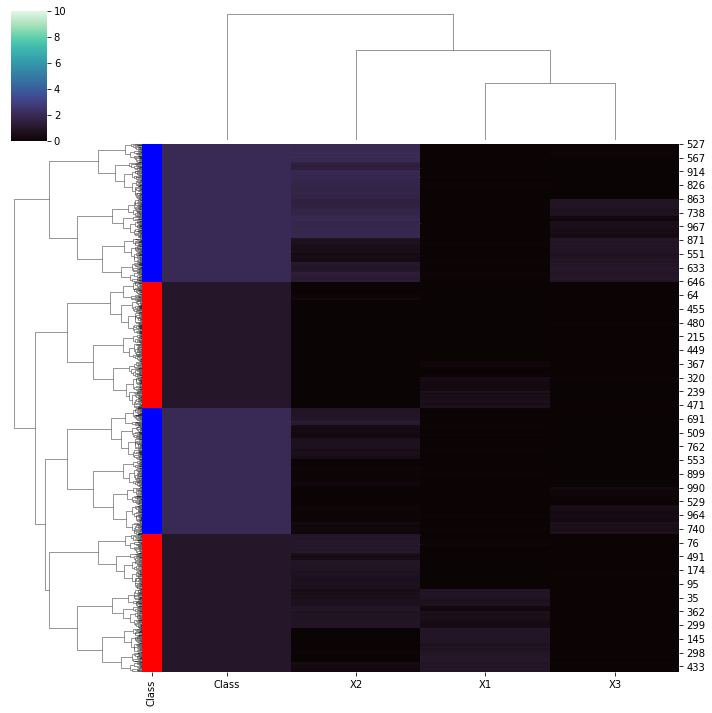

In [ ]:
ut = dict(zip(df1['Class'].unique(), "rbgyrbg"))
row_colors = df1['Class'].map(ut)
g = sns.clustermap(df1, row_colors=row_colors,cmap="mako", vmin=0, vmax=10)

#### Hierarchial clustering

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
df.head()

,X1,X2,X3
0,-0.4530,-0.891,0.02300
1,0.6530,-0.846,0.02110
2,0.3980,0.913,-0.00139
3,0.0952,1.050,0.00628
4,0.5240,-0.941,0.03780


Trying different linkage techniques

Single linkage

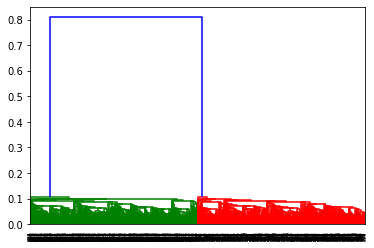

In [ ]:
#Single linkage
mergings = linkage(df,method='single',metric='euclidean')
dendrogram(mergings)
plt.show()

No better understanding

Complete linkage

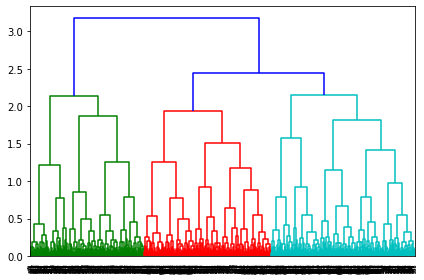

In [ ]:
#complete linkage
mergings = linkage(df,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 3

ward linkage

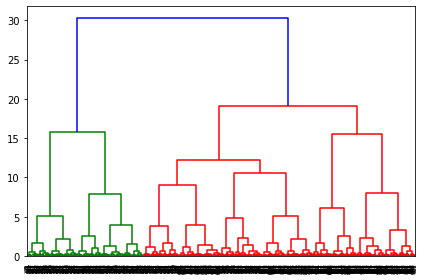

In [ ]:
mergings = linkage(df,method='ward',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 3

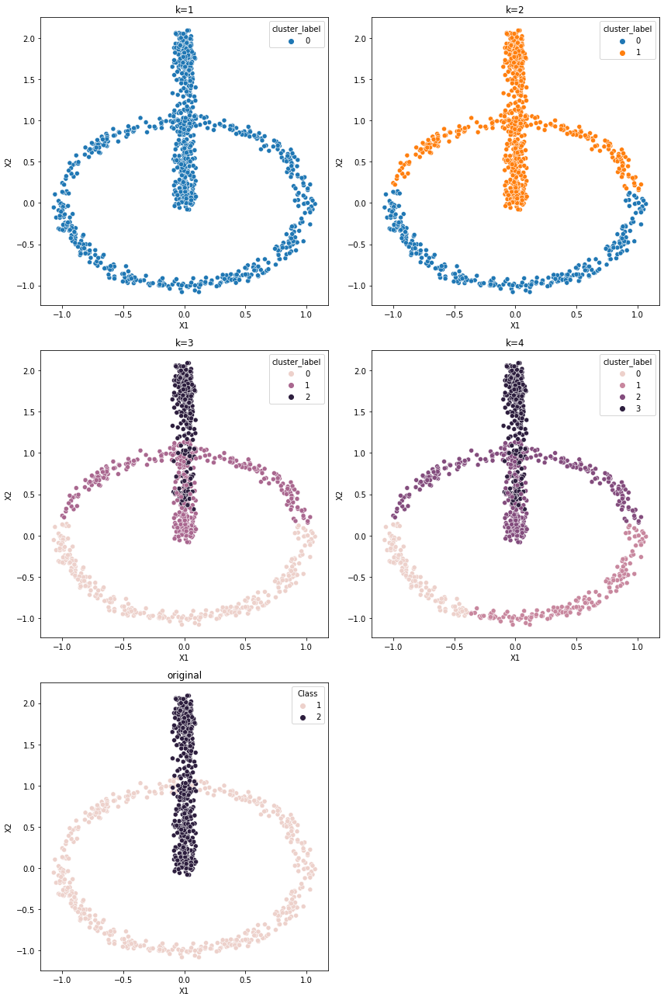

In [ ]:
plt.figure(figsize=(12,18))
for i in range(1,5):
    
    #Cutting the tree into clusters
    cluster_labels = cut_tree(mergings,n_clusters=i)
    cluster_labels=cluster_labels.reshape(-1, )
    df['cluster_label'] = cluster_labels
    
    #plotting 
    plt.subplot(3,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(3,2,5)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

We can see k = 2 have some similar results as of original

In [ ]:
#so we will split into 2 categories
cluster_labels = cut_tree(mergings,n_clusters=2)
cluster_labels=cluster_labels.reshape(-1, )
df['cluster_label'] = cluster_labels
df

,X1,X2,X3,cluster_label
0,-0.45300,-0.8910,0.02300,0
1,0.65300,-0.8460,0.02110,0
2,0.39800,0.9130,-0.00139,1
3,0.09520,1.0500,0.00628,1
4,0.52400,-0.9410,0.03780,0
...,...,...,...,...
995,0.01520,0.0531,-0.36100,1
996,0.05160,0.6910,0.87500,1
997,-0.00511,1.3900,-0.94700,1
998,-0.06710,0.7140,0.88100,1


#### K-Means clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df)
    
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 788.3190082875002
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 581.1866935075338
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 453.4728761466455
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 342.12416841206095
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 273.9846097679318
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 218.18990622356455
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 171.15891896612828
----------

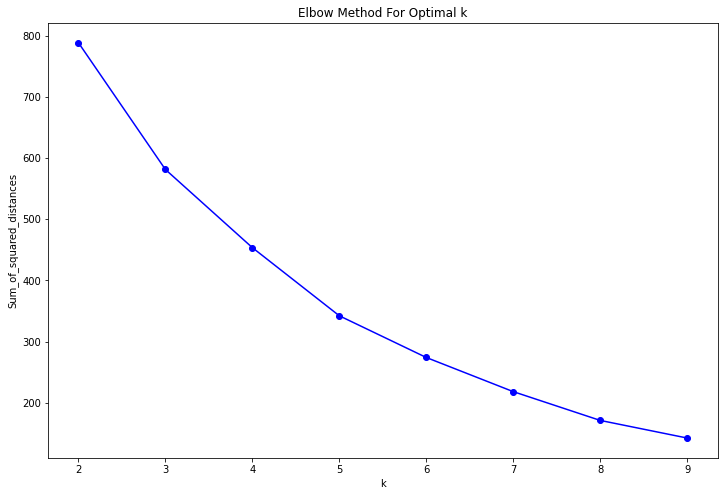

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bo-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this we can see,we can make cluster at 2

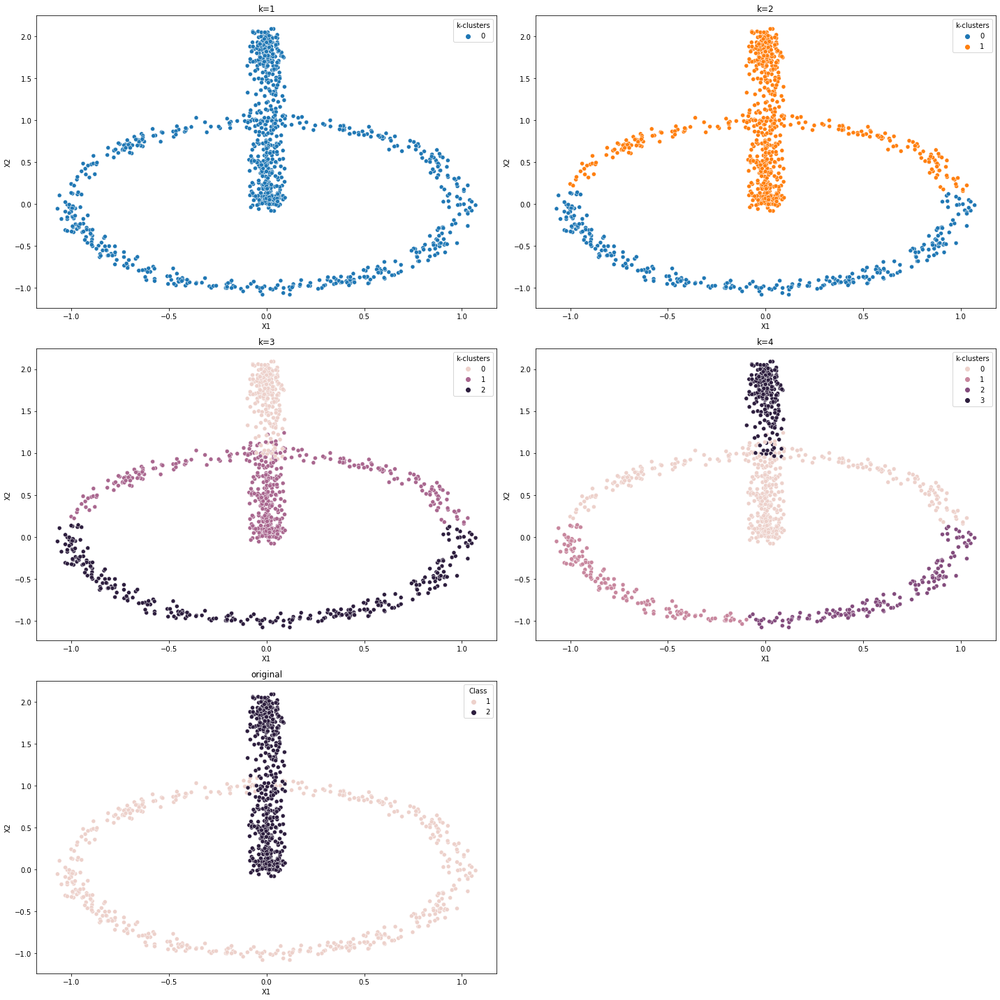

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,5):
    
    #Cutting the tree into clusters
    kmean = KMeans(n_clusters = i)
    kmean.fit(df.iloc[:,:-1])
    df['k-clusters'] = kmean.labels_
    
    #plotting 
    plt.subplot(3,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(3,2,5)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

cluster 4 is looking optimum

In [ ]:
#so we will split into 2 categories
kmean = KMeans(n_clusters=2)
kmean.fit(df.iloc[:,:-2])
df['k-clusters'] = kmean.labels_
df

,X1,X2,X3,cluster_label,k-clusters
0,-0.45300,-0.8910,0.02300,0,1
1,0.65300,-0.8460,0.02110,0,1
2,0.39800,0.9130,-0.00139,1,0
3,0.09520,1.0500,0.00628,1,0
4,0.52400,-0.9410,0.03780,0,1
...,...,...,...,...,...
995,0.01520,0.0531,-0.36100,1,1
996,0.05160,0.6910,0.87500,1,0
997,-0.00511,1.3900,-0.94700,1,0
998,-0.06710,0.7140,0.88100,1,0


In [ ]:
df['original']=df1['Class']
df

,X1,X2,X3,cluster_label,k-clusters,original
0,-0.45300,-0.8910,0.02300,0,1,1
1,0.65300,-0.8460,0.02110,0,1,1
2,0.39800,0.9130,-0.00139,1,0,1
3,0.09520,1.0500,0.00628,1,0,1
4,0.52400,-0.9410,0.03780,0,1,1
...,...,...,...,...,...,...
995,0.01520,0.0531,-0.36100,1,1,2
996,0.05160,0.6910,0.87500,1,0,2
997,-0.00511,1.3900,-0.94700,1,0,2
998,-0.06710,0.7140,0.88100,1,0,2


In [ ]:
df['original']=df['original']-1

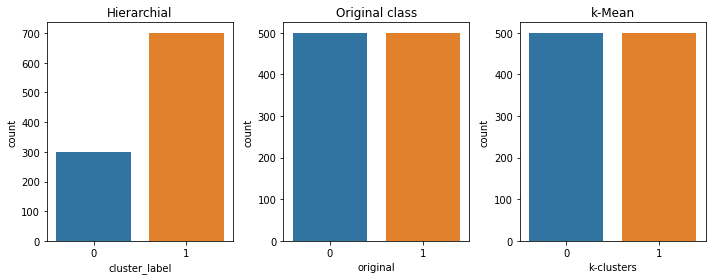

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,3,1)
sns.countplot(df['cluster_label'])
plt.title('Hierarchial')

plt.subplot(1,3,2)
sns.countplot(df['original'])
plt.title('Original class')


plt.subplot(1,3,3)
sns.countplot(df['k-clusters'])
plt.title('k-Mean')


plt.tight_layout()


from this we can see k-means predicted/ divided correctly than hierarchial

1.2 : External Validation

Techniques:
   - Classification accuracy
   - Purity
   - Precision
   - Recall
   - F-Measured
   - Jaccard
   - Rand index
   - Fowlkes Mallows
   - Hubert statistics
   - Entropy 
   - Mutual Information

https://drive.google.com/file/d/1GDHY6iojk0PASg1D5HGdyoCfPvVOZ68z/view?usp=sharing

Through above link math equations for validation metrics can be viewed

##### Rand index:

In [ ]:
from sklearn import metrics

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Rand Index of')
print('Hierarchial clustering:',metrics.rand_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.rand_score(label_true, k_pred),2))

Rand Index of
Hierarchial clustering: 0.6784804804804805
K_Means clustering: 0.55


#### Mutual Information

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Mutual Information of')
print('Hierarchial clustering:',metrics.adjusted_mutual_info_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.adjusted_mutual_info_score(label_true, k_pred),2))


Mutual Information of
Hierarchial clustering: 0.4186990239311776
K_Means clustering: 0.07


#### Homogenity & Completeness

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Homogenity & Completeness of')
print('Hierarchial clustering, Homogenity:',metrics.homogeneity_score(label_true, h_pred))
print('Hierarchial clustering, completeness:',metrics.completeness_score(label_true, h_pred))

print('K_Means clustering,Homogenity:',round(metrics.homogeneity_score(label_true, k_pred),2))
print('K_Means clustering, completeness:',round(metrics.completeness_score(label_true, k_pred),2))



Homogenity & Completeness of
Hierarchial clustering, Homogenity: 0.39401081781656166
Hierarchial clustering, completeness: 0.44770646104587775
K_Means clustering,Homogenity: 0.07
K_Means clustering, completeness: 0.07


#### Fowlkes Mallows Score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Fowlkes Mallows of')
print('Hierarchial clustering:',metrics.fowlkes_mallows_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.fowlkes_mallows_score(label_true, k_pred),2))


Fowlkes Mallows of
Hierarchial clustering: 0.7042423466085546
K_Means clustering: 0.55


#### Jaccard score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Jaccard score of')
print('Hierarchial clustering:',metrics.jaccard_score(label_true, h_pred,average='weighted'))
print('K_Means clustering:',round(metrics.jaccard_score(label_true, k_pred,average='weighted'),2))


Jaccard score of
Hierarchial clustering: 0.6556333808844509
K_Means clustering: 0.21


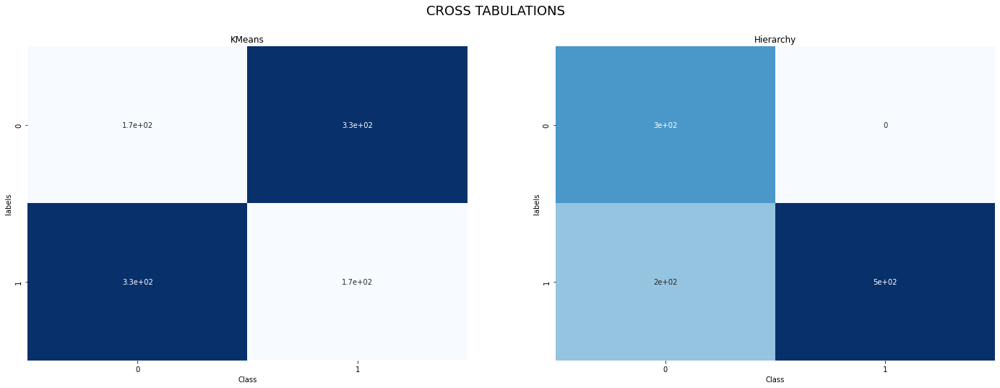

In [ ]:
h_pred = df['cluster_label']
k_pred = df['k-clusters']

# cross tabulation table for kmeans
df_k = pd.DataFrame({'labels':k_pred,"Class":df['original']})
ct1 = pd.crosstab(df_k['labels'],df_k['Class'])

# cross tabulation table for Hierarchy
df_h = pd.DataFrame({'labels':h_pred,"Class":df['original']})
ct2 = pd.crosstab(df_h['labels'],df_h['Class'])


plt.figure(figsize=(24,8))
plt.suptitle("CROSS TABULATIONS",fontsize=18)
plt.subplot(1,2,1)
plt.title("KMeans")
sns.heatmap(ct1,annot=True,cbar=False,cmap="Blues")

plt.subplot(1,2,2)
plt.title("Hierarchy")
sns.heatmap(ct2,annot=True,cbar=False,cmap="Blues")

plt.show()

We can see in hierarchy it is predicting correctly

In [ ]:
from sklearn.metrics.cluster import pair_confusion_matrix

In [ ]:
print('Hierarchial clustering:')
pair_confusion_matrix(label_true, h_pred)

Hierarchial clustering:


array([[299000, 201000],
       [120198, 378802]])

In [ ]:
print('K_Means clustering:')
pair_confusion_matrix(label_true, k_pred)

K_Means clustering:


array([[273716, 226284],
       [226284, 272716]])

In [ ]:
#Accuracy score

print('Accuracy score of  Hierarchial clustering:',metrics.accuracy_score(label_true, h_pred))
print('Accuracy score of K_Means clustering:',metrics.accuracy_score(label_true, k_pred))

Accuracy score of  Hierarchial clustering: 0.799
Accuracy score of K_Means clustering: 0.346


In [ ]:
#Classification report
print('Classification report of  Hierarchial clustering:\n',metrics.classification_report(label_true, h_pred))
print('Classification report of K_Means clustering:\n',metrics.classification_report(label_true, k_pred))

Classification report of  Hierarchial clustering:
               precision    recall  f1-score   support

           0       1.00      0.60      0.75       500
           1       0.71      1.00      0.83       500

    accuracy                           0.80      1000
   macro avg       0.86      0.80      0.79      1000
weighted avg       0.86      0.80      0.79      1000

Classification report of K_Means clustering:
               precision    recall  f1-score   support

           0       0.35      0.35      0.35       500
           1       0.35      0.35      0.35       500

    accuracy                           0.35      1000
   macro avg       0.35      0.35      0.35      1000
weighted avg       0.35      0.35      0.35      1000



From above observation we cn conclude Hierarchial clustering is working well

#### 1.3 : Plot of data points according to original class

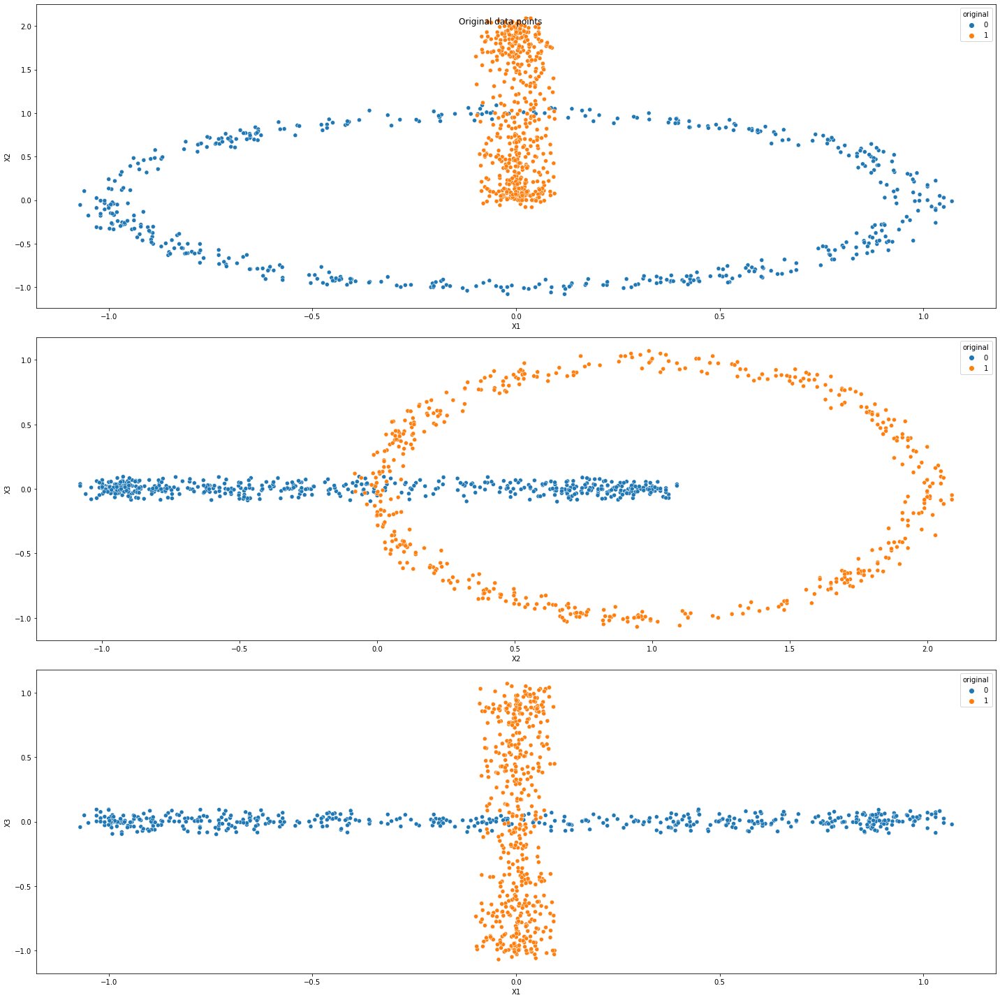

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='original')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='original')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='original')

plt.tight_layout()

#### 1.4 : Plot of data points according to class by algorithm

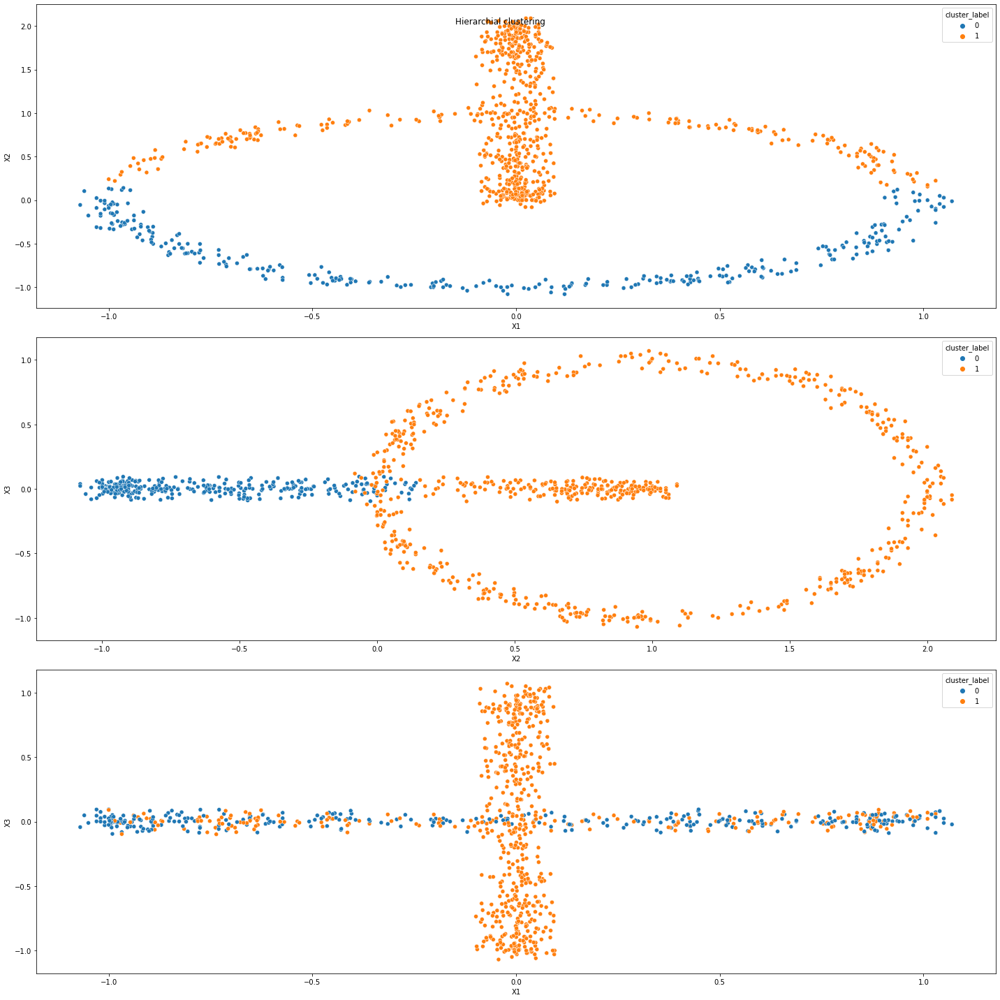

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Hierarchial clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='cluster_label')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='cluster_label')

plt.tight_layout()

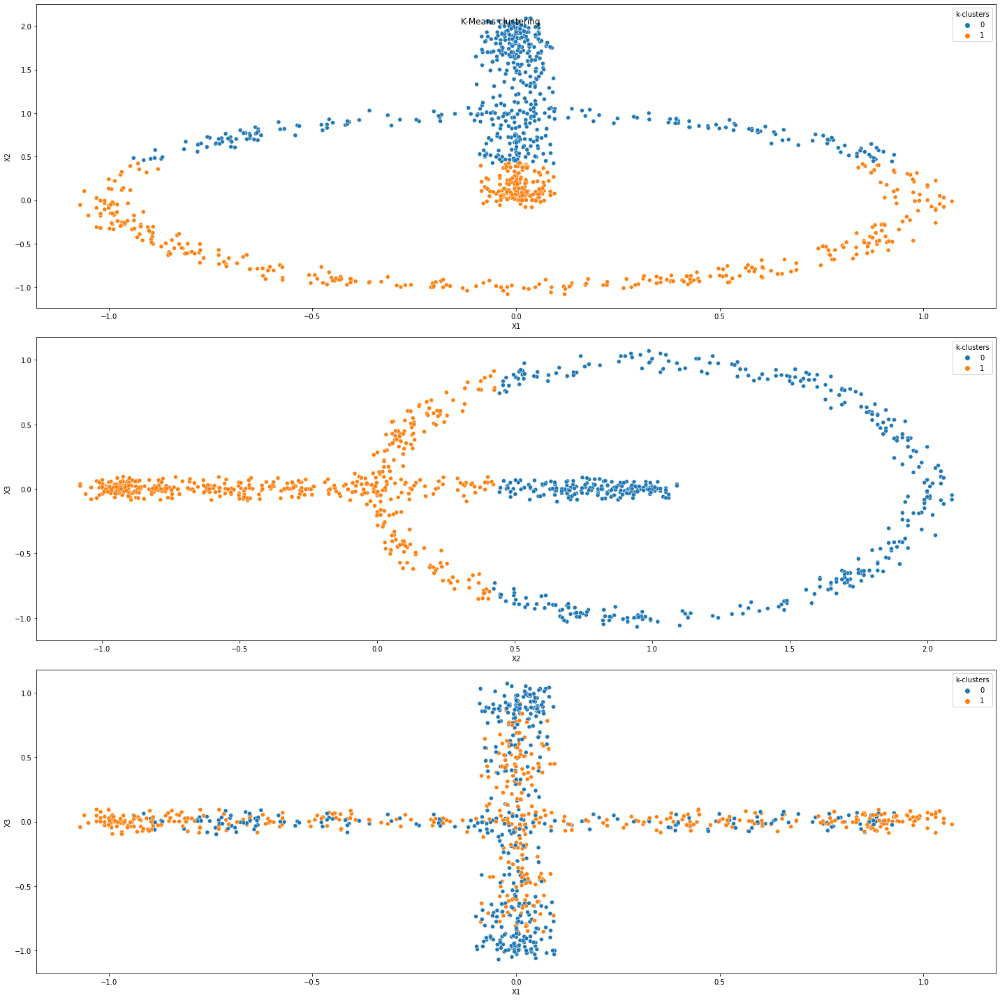

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('K-Means clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='k-clusters')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='k-clusters')

plt.tight_layout()

# Task 1 : Dataset5

In [ ]:
import pandas as pd
import numpy as np
from numpy import where
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [ ]:
from google.colab import files
up = files.upload()

Saving Data5.csv to Data5.csv


In [ ]:
#Importing the datasets
df1 = pd.read_csv('/content/Data5.csv')

In [ ]:
df1.head()

,Unnamed: 0,X1,X2,X3,Class
0,1,-4.822490,-50.402170,4.020861,1
1,2,-44.460120,20.964670,-11.492060,1
2,3,50.001020,0.780748,9.134460,1
3,4,-41.699080,-22.310060,16.314120,1
4,5,4.425242,-4.666664,50.223740,1


In [ ]:
#brief of data
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800 entries, 0 to 799
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  800 non-null    int64  
 1   X1          800 non-null    float64
 2   X2          800 non-null    float64
 3   X3          800 non-null    float64
 4   Class       800 non-null    int64  
dtypes: float64(3), int64(2)
memory usage: 31.4 KB


## Cleaning data 

we can drop column Unnamed: 0

In [ ]:
df1.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
#Brief stats
df1.describe()

,X1,X2,X3,Class
count,800.000000,800.000000,800.000000,800.000000
mean,-0.611640,-0.921962,0.824385,1.500000
std,18.771445,18.472153,23.941496,0.500313
min,-49.464740,-50.461010,-50.592120,1.000000
25%,-4.443038,-4.950855,-4.424578,1.000000
50%,0.109752,-0.407613,0.537025,1.500000
75%,4.713370,3.885574,6.120185,2.000000
max,50.001020,50.598880,50.585700,2.000000


In [ ]:
#Skewness
df1.skew()

X1      -0.077022
X2       0.012124
X3      -0.057201
Class    0.000000
dtype: float64

skewness is in acceptable range

In [ ]:
#Checking the class column
df1['Class'].value_counts()

1    400
2    400
Name: Class, dtype: int64

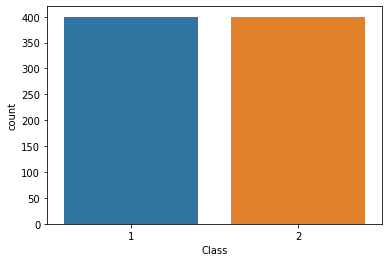

In [ ]:
#Seeing visually
sns.countplot(df1['Class'])

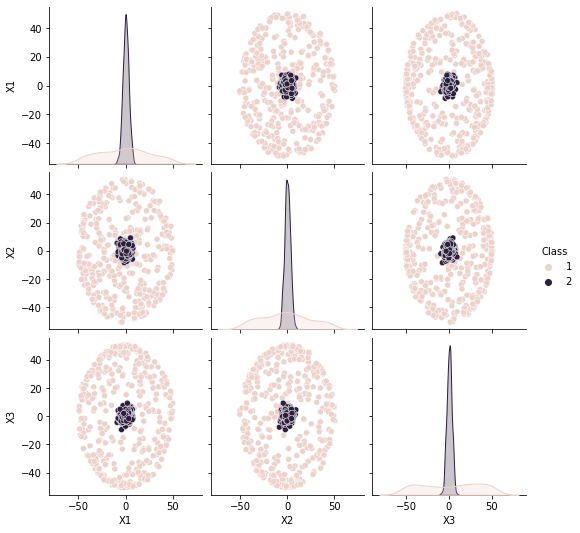

In [ ]:
#Viewing how the clusters are in original
sns.pairplot(df1,hue='Class')

## Task 1.1
- Cluster the dataset based on K-Means & Hierarchial 

making data ready for clustering

In [ ]:
df = df1.drop('Class',axis=1)
df.head()

,X1,X2,X3
0,-4.822490,-50.402170,4.020861
1,-44.460120,20.964670,-11.492060
2,50.001020,0.780748,9.134460
3,-41.699080,-22.310060,16.314120
4,4.425242,-4.666664,50.223740


In [ ]:
df2 = df.to_numpy()
y=df1['Class']

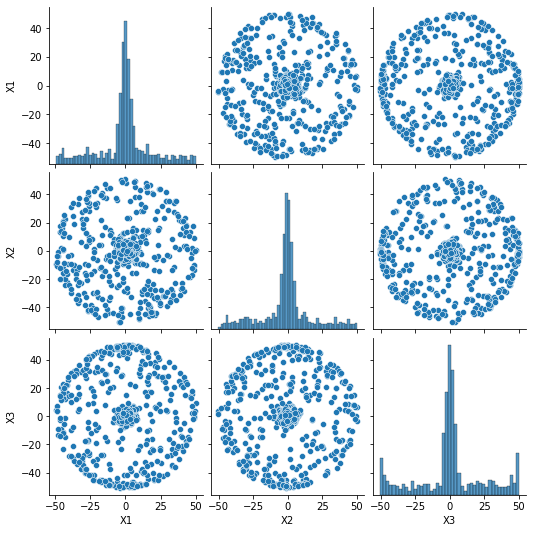

In [ ]:
sns.pairplot(df)

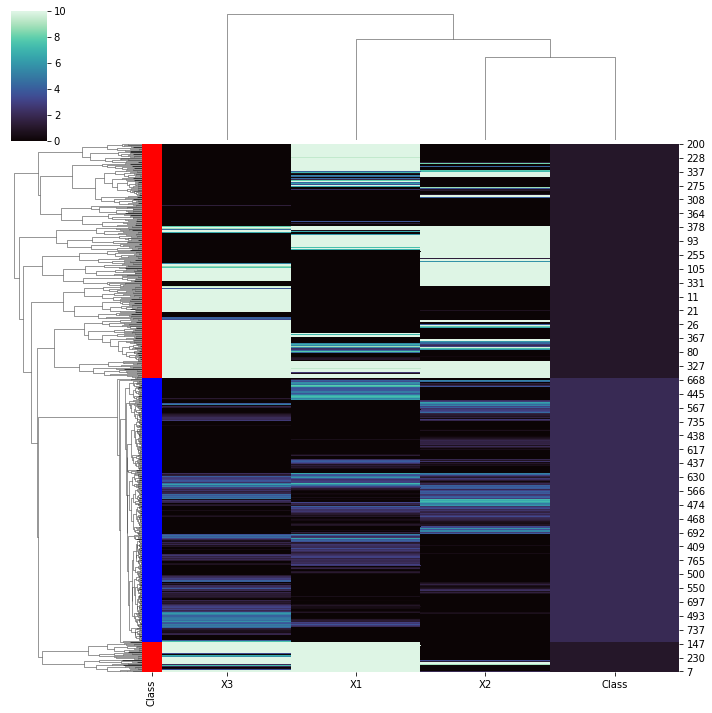

In [ ]:
ut = dict(zip(df1['Class'].unique(), "rbgyrbg"))
row_colors = df1['Class'].map(ut)
g = sns.clustermap(df1, row_colors=row_colors,cmap="mako", vmin=0, vmax=10)

#### Hierarchial clustering

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
df.head()

,X1,X2,X3
0,-4.822490,-50.402170,4.020861
1,-44.460120,20.964670,-11.492060
2,50.001020,0.780748,9.134460
3,-41.699080,-22.310060,16.314120
4,4.425242,-4.666664,50.223740


Trying different linkage techniques

Single linkage

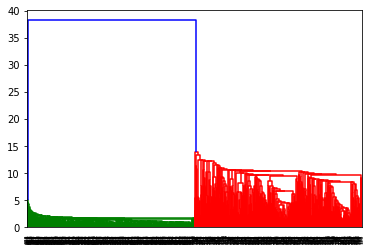

In [ ]:
#Single linkage
mergings = linkage(df,method='single',metric='euclidean')
dendrogram(mergings)
plt.show()

No better understanding

Complete linkage

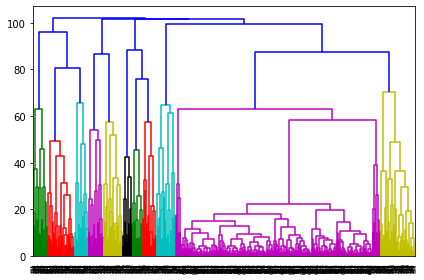

In [ ]:
#complete linkage
mergings = linkage(df,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 6

ward linkage

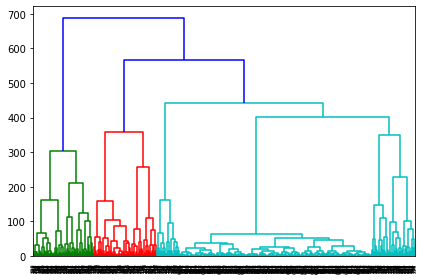

In [ ]:
mergings = linkage(df,method='ward',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 2

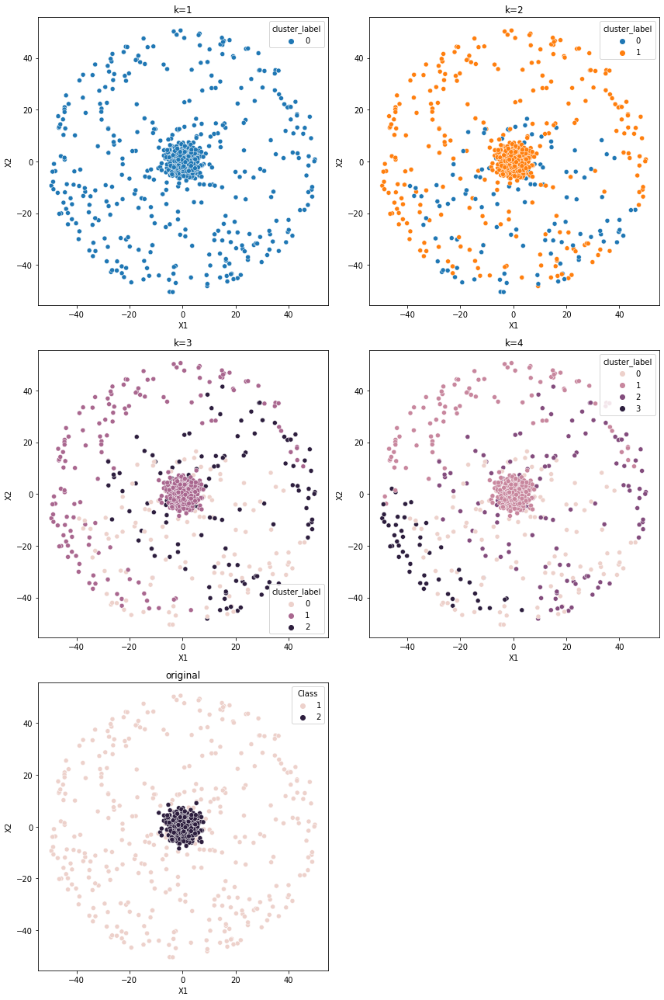

In [ ]:
plt.figure(figsize=(12,18))
for i in range(1,5):
    
    #Cutting the tree into clusters
    cluster_labels = cut_tree(mergings,n_clusters=i)
    cluster_labels=cluster_labels.reshape(-1, )
    df['cluster_label'] = cluster_labels
    
    #plotting 
    plt.subplot(3,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(3,2,5)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

We can see k = 2 have some similar results as of original

In [ ]:
#so we will split into 2 categories
cluster_labels = cut_tree(mergings,n_clusters=2)
cluster_labels=cluster_labels.reshape(-1, )
df['cluster_label'] = cluster_labels
df

,X1,X2,X3,cluster_label
0,-4.822490,-50.402170,4.020861,0
1,-44.460120,20.964670,-11.492060,1
2,50.001020,0.780748,9.134460,1
3,-41.699080,-22.310060,16.314120,1
4,4.425242,-4.666664,50.223740,1
...,...,...,...,...
795,-1.531027,0.681636,0.543271,1
796,0.500754,-1.848209,0.605654,1
797,1.089574,-0.246493,-3.355758,1
798,-1.907717,4.964502,2.098423,1


#### K-Means clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df)
    
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 754186.6786519347
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 582395.696966518
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 486731.9913802097
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 397163.1707832299
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 322793.39468408865
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 263431.0608991025
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 234983.43457971865
------------

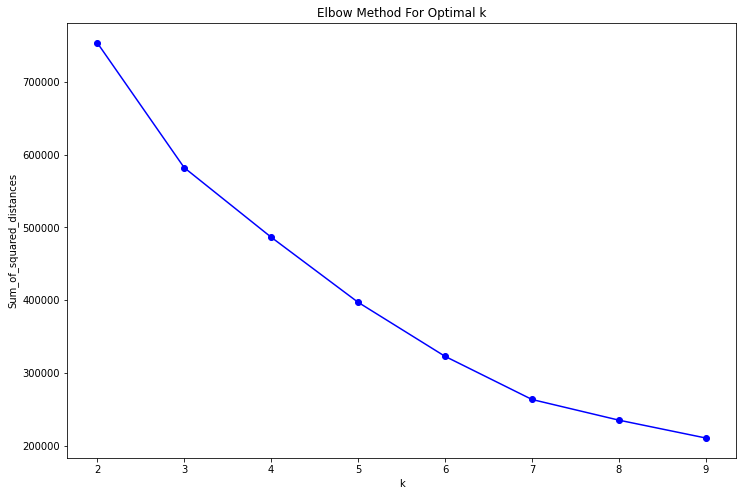

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bo-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this we can see,we can make cluster at 2 or 3

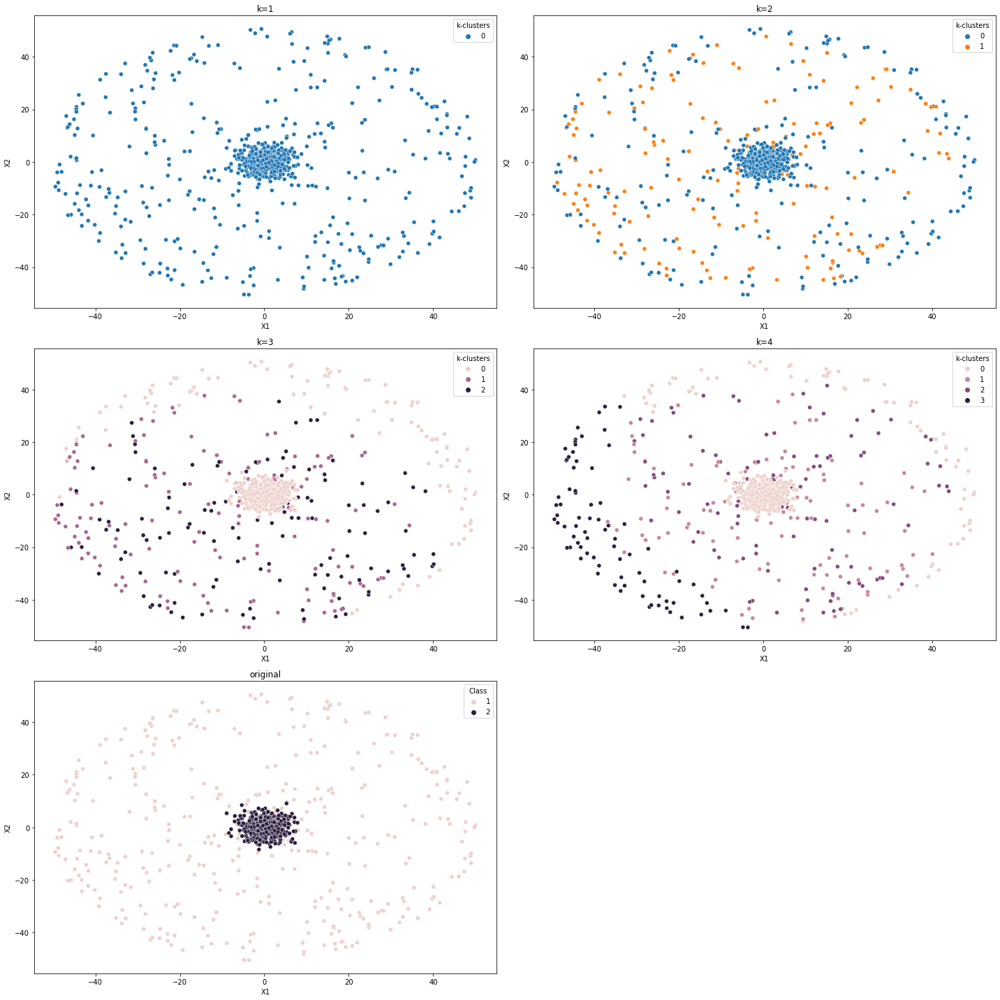

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,5):
    
    #Cutting the tree into clusters
    kmean = KMeans(n_clusters = i)
    kmean.fit(df.iloc[:,:-1])
    df['k-clusters'] = kmean.labels_
    
    #plotting 
    plt.subplot(3,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(3,2,5)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

cluster 2 is looking optimum

In [ ]:
#so we will split into 2 categories
kmean = KMeans(n_clusters=2)
kmean.fit(df.iloc[:,:-2])
df['k-clusters'] = kmean.labels_
df

,X1,X2,X3,cluster_label,k-clusters
0,-4.822490,-50.402170,4.020861,0,0
1,-44.460120,20.964670,-11.492060,1,0
2,50.001020,0.780748,9.134460,1,0
3,-41.699080,-22.310060,16.314120,1,1
4,4.425242,-4.666664,50.223740,1,1
...,...,...,...,...,...
795,-1.531027,0.681636,0.543271,1,0
796,0.500754,-1.848209,0.605654,1,0
797,1.089574,-0.246493,-3.355758,1,0
798,-1.907717,4.964502,2.098423,1,0


In [ ]:
df['original']=df1['Class']
df

,X1,X2,X3,cluster_label,k-clusters,original
0,-4.822490,-50.402170,4.020861,0,0,1
1,-44.460120,20.964670,-11.492060,1,0,1
2,50.001020,0.780748,9.134460,1,0,1
3,-41.699080,-22.310060,16.314120,1,1,1
4,4.425242,-4.666664,50.223740,1,1,1
...,...,...,...,...,...,...
795,-1.531027,0.681636,0.543271,1,0,2
796,0.500754,-1.848209,0.605654,1,0,2
797,1.089574,-0.246493,-3.355758,1,0,2
798,-1.907717,4.964502,2.098423,1,0,2


In [ ]:
df['original']=df['original']-1

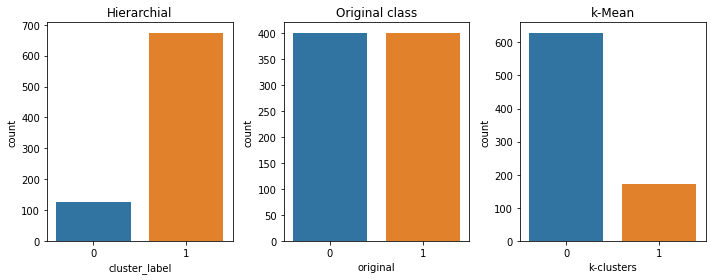

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,3,1)
sns.countplot(df['cluster_label'])
plt.title('Hierarchial')

plt.subplot(1,3,2)
sns.countplot(df['original'])
plt.title('Original class')


plt.subplot(1,3,3)
sns.countplot(df['k-clusters'])
plt.title('k-Mean')


plt.tight_layout()


from this we can see k-means predicted/ divided correctly than hierarchial

**1.2: External Validation**

Techniques:
   - Classification accuracy
   - Purity
   - Precision
   - Recall
   - F-Measured
   - Jaccard
   - Rand index
   - Fowlkes Mallows
   - Hubert statistics
   - Entropy 
   - Mutual Information

https://drive.google.com/file/d/1GDHY6iojk0PASg1D5HGdyoCfPvVOZ68z/view?usp=sharing

Through above link math equations for validation metrics can be viewed

##### Rand index:

In [ ]:
from sklearn import metrics

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Rand Index of')
print('Hierarchial clustering:',metrics.rand_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.rand_score(label_true, k_pred),2))

Rand Index of
Hierarchial clustering: 0.5490488110137672
K_Means clustering: 0.59


#### Mutual Information

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Mutual Information of')
print('Hierarchial clustering:',metrics.adjusted_mutual_info_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.adjusted_mutual_info_score(label_true, k_pred),2))


Mutual Information of
Hierarchial clustering: 0.21882677576382492
K_Means clustering: 0.29


#### Homogenity & Completeness

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Homogenity & Completeness of')
print('Hierarchial clustering, Homogenity:',metrics.homogeneity_score(label_true, h_pred))
print('Hierarchial clustering, completeness:',metrics.completeness_score(label_true, h_pred))

print('K_Means clustering,Homogenity:',round(metrics.homogeneity_score(label_true, k_pred),2))
print('K_Means clustering, completeness:',round(metrics.completeness_score(label_true, k_pred),2))



Homogenity & Completeness of
Hierarchial clustering, Homogenity: 0.17886455515562594
Hierarchial clustering, completeness: 0.2846824090289758
K_Means clustering,Homogenity: 0.26
K_Means clustering, completeness: 0.34


#### Fowlkes Mallows Score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Fowlkes Mallows of')
print('Hierarchial clustering:',metrics.fowlkes_mallows_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.fowlkes_mallows_score(label_true, k_pred),2))


Fowlkes Mallows of
Hierarchial clustering: 0.6462836986049043
K_Means clustering: 0.65


#### Jaccard score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Jaccard score of')
print('Hierarchial clustering:',metrics.jaccard_score(label_true, h_pred,average='weighted'))
print('K_Means clustering:',round(metrics.jaccard_score(label_true, k_pred,average='weighted'),2))


Jaccard score of
Hierarchial clustering: 0.45423590504451034
K_Means clustering: 0.14


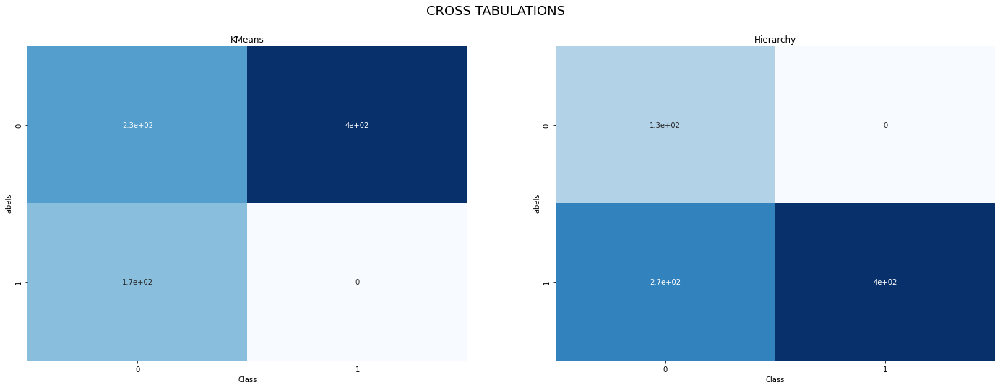

In [ ]:
h_pred = df['cluster_label']
k_pred = df['k-clusters']

# cross tabulation table for kmeans
df_k = pd.DataFrame({'labels':k_pred,"Class":df['original']})
ct1 = pd.crosstab(df_k['labels'],df_k['Class'])

# cross tabulation table for Hierarchy
df_h = pd.DataFrame({'labels':h_pred,"Class":df['original']})
ct2 = pd.crosstab(df_h['labels'],df_h['Class'])


plt.figure(figsize=(24,8))
plt.suptitle("CROSS TABULATIONS",fontsize=18)
plt.subplot(1,2,1)
plt.title("KMeans")
sns.heatmap(ct1,annot=True,cbar=False,cmap="Blues")

plt.subplot(1,2,2)
plt.title("Hierarchy")
sns.heatmap(ct2,annot=True,cbar=False,cmap="Blues")

plt.show()

We can see in hierarchy it is predicting correctly

In [ ]:
from sklearn.metrics.cluster import pair_confusion_matrix

In [ ]:
print('Hierarchial clustering:')
pair_confusion_matrix(label_true, h_pred)

Hierarchial clustering:


array([[100800, 219200],
       [ 69048, 250152]])

In [ ]:
print('K_Means clustering:')
pair_confusion_matrix(label_true, k_pred)

K_Means clustering:


array([[136800, 183200],
       [ 78318, 240882]])

In [ ]:
#Accuracy score

print('Accuracy score of  Hierarchial clustering:',metrics.accuracy_score(label_true, h_pred))
print('Accuracy score of K_Means clustering:',metrics.accuracy_score(label_true, k_pred))

Accuracy score of  Hierarchial clustering: 0.6575
Accuracy score of K_Means clustering: 0.28625


In [ ]:
#Classification report
print('Classification report of  Hierarchial clustering:\n',metrics.classification_report(label_true, h_pred))
print('Classification report of K_Means clustering:\n',metrics.classification_report(label_true, k_pred))

Classification report of  Hierarchial clustering:
               precision    recall  f1-score   support

           0       1.00      0.32      0.48       400
           1       0.59      1.00      0.74       400

    accuracy                           0.66       800
   macro avg       0.80      0.66      0.61       800
weighted avg       0.80      0.66      0.61       800

Classification report of K_Means clustering:
               precision    recall  f1-score   support

           0       0.36      0.57      0.45       400
           1       0.00      0.00      0.00       400

    accuracy                           0.29       800
   macro avg       0.18      0.29      0.22       800
weighted avg       0.18      0.29      0.22       800



From above observation we cn conclude K-Means is working well

#### 1.3 : Plot of data points according to original class

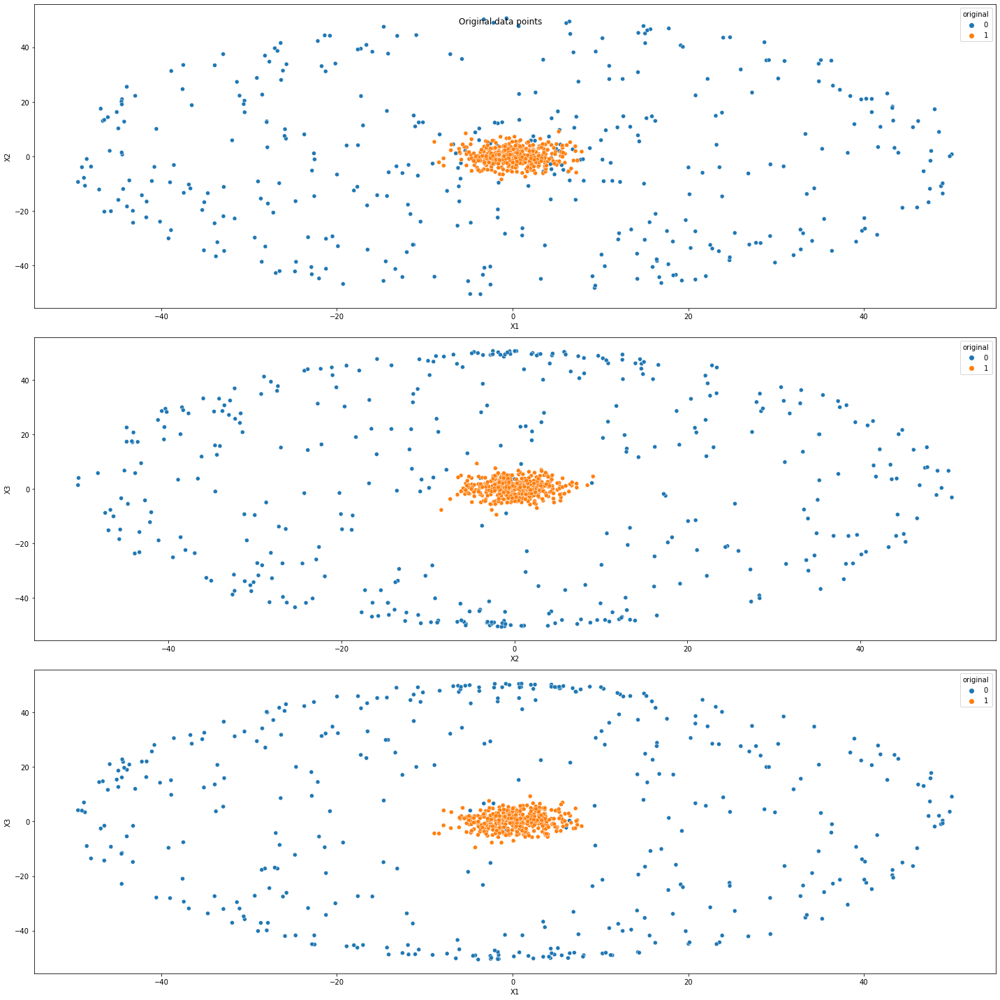

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='original')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='original')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='original')

plt.tight_layout()

#### 1.4 : Plot of data points according to class by algorithm

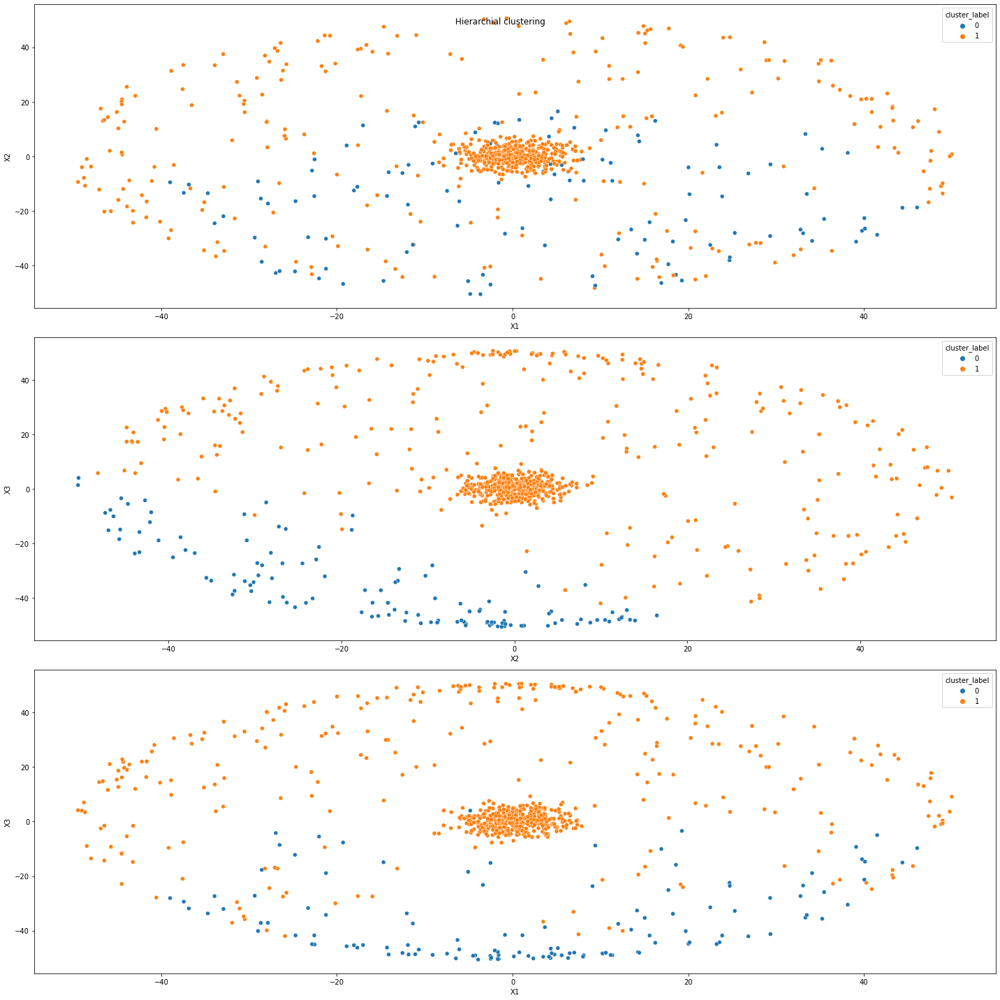

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Hierarchial clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='cluster_label')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='cluster_label')

plt.tight_layout()

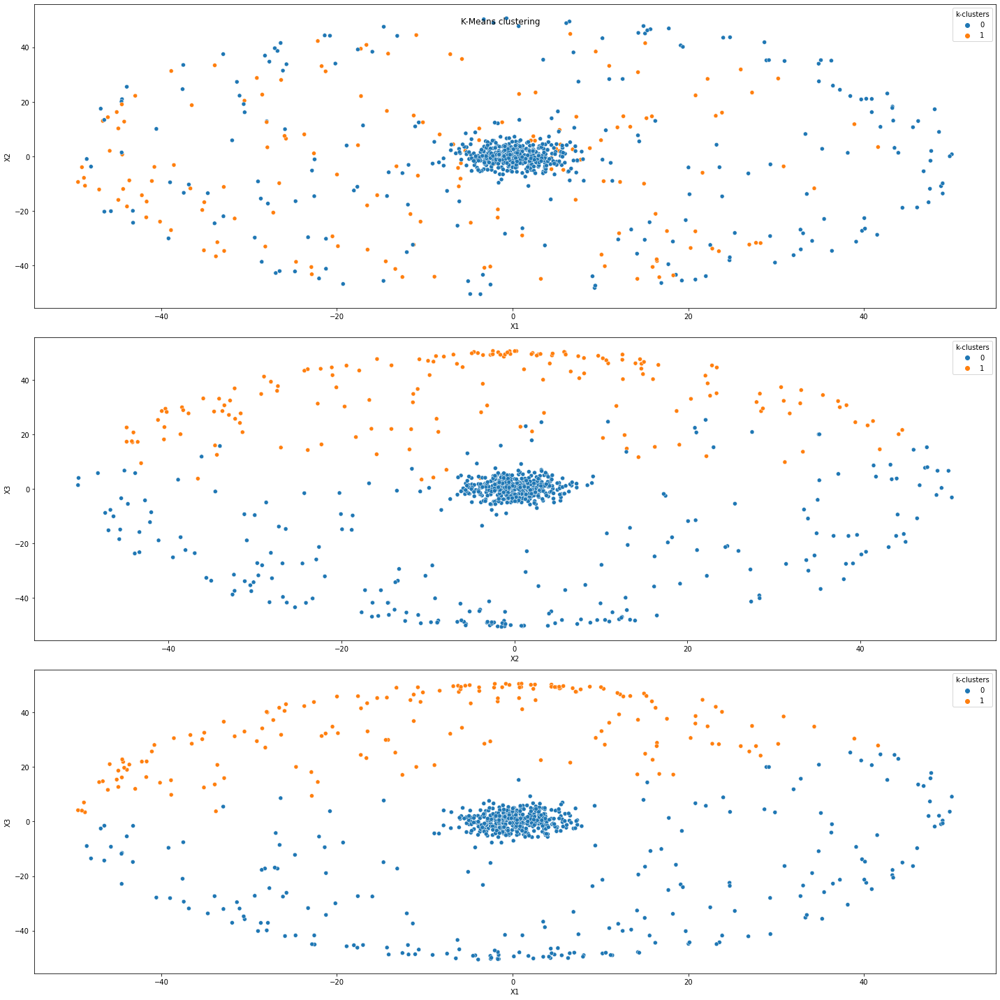

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('K-Means clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='k-clusters')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='k-clusters')

plt.tight_layout()

# Task 1 : Dataset6

In [ ]:
import pandas as pd
import numpy as np
from numpy import where
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [ ]:
from google.colab import files
up = files.upload()

Saving Data6.csv to Data6.csv


In [ ]:
#Importing the datasets
df1 = pd.read_csv('/content/Data6.csv')

In [ ]:
df1.head()

,Unnamed: 0,X1,X2,Class
0,1,1.388261,2.076096,1
1,2,2.177247,3.102304,1
2,3,0.378645,5.307610,1
3,4,3.681732,1.622681,1
4,5,2.462861,2.777897,1


In [ ]:
#brief of data
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4096 entries, 0 to 4095
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  4096 non-null   int64  
 1   X1          4096 non-null   float64
 2   X2          4096 non-null   float64
 3   Class       4096 non-null   int64  
dtypes: float64(2), int64(2)
memory usage: 128.1 KB


## Cleaning data 

we can drop column Unnamed: 0

In [ ]:
df1.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
#Brief stats
df1.describe()

,X1,X2,Class
count,4096.000000,4096.000000,4096.000000
mean,1.279324,1.714045,1.500000
std,1.454175,1.732789,0.500061
min,-3.075178,-3.298857,1.000000
25%,0.276844,0.371124,1.000000
50%,1.156726,1.494928,1.500000
75%,2.190571,2.983782,2.000000
max,6.728720,7.793648,2.000000


In [ ]:
#Skewness
df1.skew()

X1       0.336847
X2       0.368642
Class    0.000000
dtype: float64

skewness is in acceptable range

In [ ]:
#Checking the class column
df1['Class'].value_counts()

1    2048
2    2048
Name: Class, dtype: int64

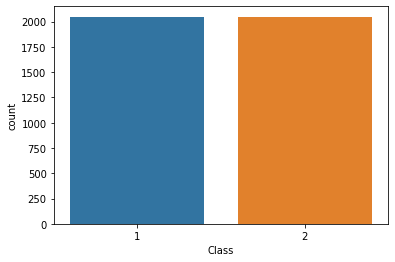

In [ ]:
#Seeing visually
sns.countplot(df1['Class'])

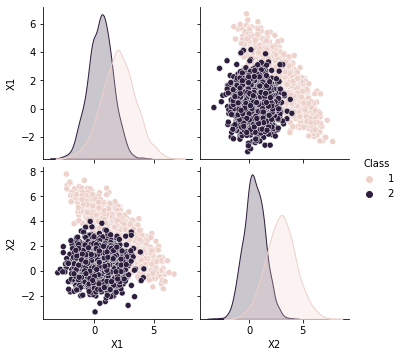

In [ ]:
#Viewing how the clusters are in original
sns.pairplot(df1,hue='Class')

## Task 1.1
- Cluster the dataset based on K-Means & Hierarchial 

making data ready for clustering

In [ ]:
df = df1.drop('Class',axis=1)
df.head()

,X1,X2
0,1.388261,2.076096
1,2.177247,3.102304
2,0.378645,5.307610
3,3.681732,1.622681
4,2.462861,2.777897


In [ ]:
df2 = df.to_numpy()
y=df1['Class']

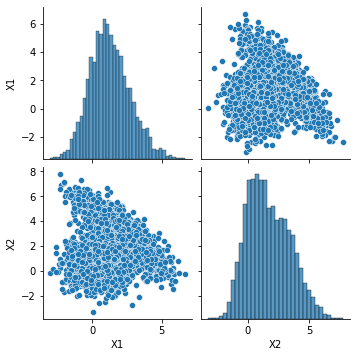

In [ ]:
sns.pairplot(df)

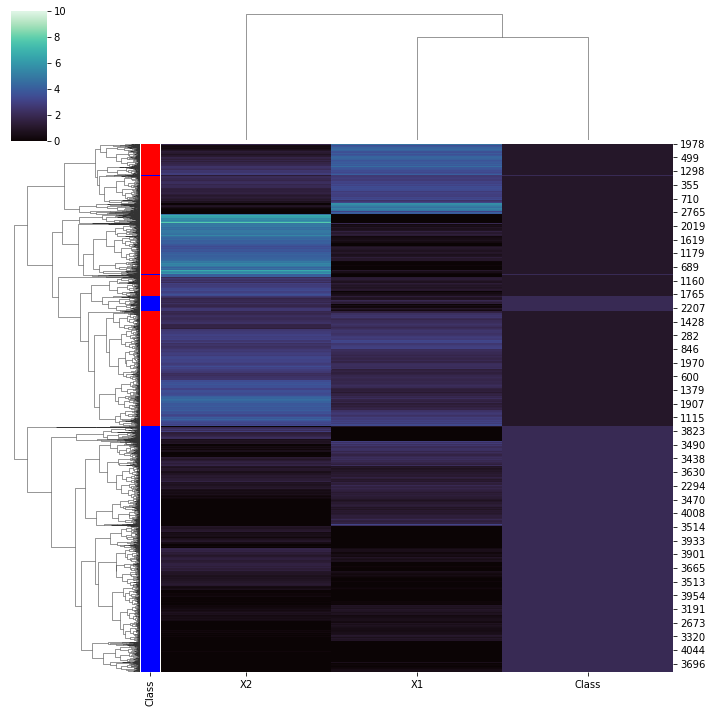

In [ ]:
ut = dict(zip(df1['Class'].unique(), "rbgyrbg"))
row_colors = df1['Class'].map(ut)
g = sns.clustermap(df1, row_colors=row_colors,cmap="mako", vmin=0, vmax=10)

#### Hierarchial clustering

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
df.head()

,X1,X2
0,1.388261,2.076096
1,2.177247,3.102304
2,0.378645,5.307610
3,3.681732,1.622681
4,2.462861,2.777897


Trying different linkage techniques

Single linkage

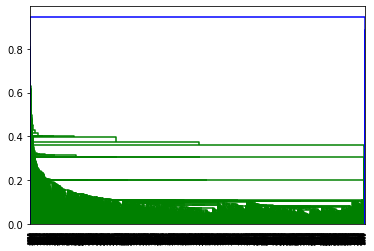

In [ ]:
#Single linkage
mergings = linkage(df,method='single',metric='euclidean')
dendrogram(mergings)
plt.show()

No better understanding

Complete linkage

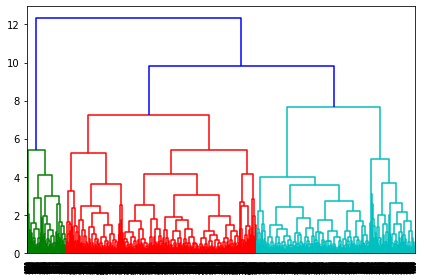

In [ ]:
#complete linkage
mergings = linkage(df,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 3

ward linkage

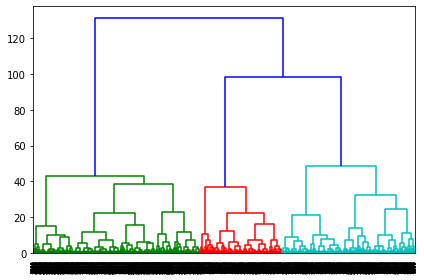

In [ ]:
mergings = linkage(df,method='ward',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 2

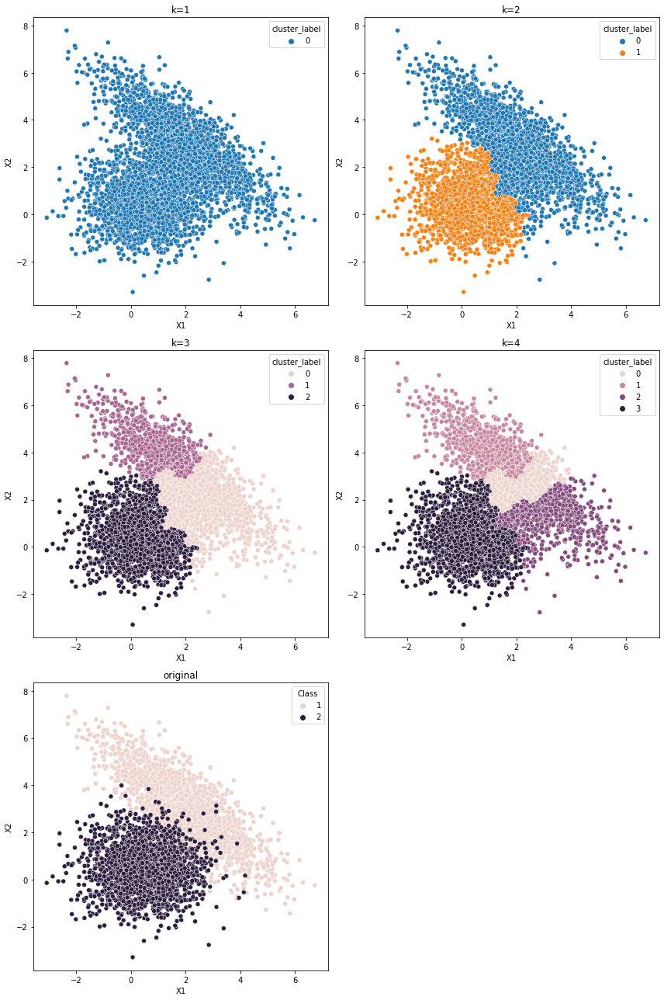

In [ ]:
plt.figure(figsize=(12,18))
for i in range(1,5):
    
    #Cutting the tree into clusters
    cluster_labels = cut_tree(mergings,n_clusters=i)
    cluster_labels=cluster_labels.reshape(-1, )
    df['cluster_label'] = cluster_labels
    
    #plotting 
    plt.subplot(3,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(3,2,5)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

We can see k = 2 have some similar results as of original

In [ ]:
#so we will split into 2 categories
cluster_labels = cut_tree(mergings,n_clusters=2)
cluster_labels=cluster_labels.reshape(-1, )
df['cluster_label'] = cluster_labels
df

,X1,X2,cluster_label
0,1.388261,2.076096,0
1,2.177247,3.102304,0
2,0.378645,5.307610,0
3,3.681732,1.622681,0
4,2.462861,2.777897,0
...,...,...,...
4091,0.909687,0.375763,1
4092,2.698381,0.511262,0
4093,1.078797,1.526153,1
4094,1.974889,-0.649343,1


#### K-Means clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df)
    
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 11996.981487671503
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 7218.134323832069
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 5768.511312659693
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 4677.673781099094
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 3958.1345520182076
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 3432.5164125670944
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 3031.3416082867907
---------

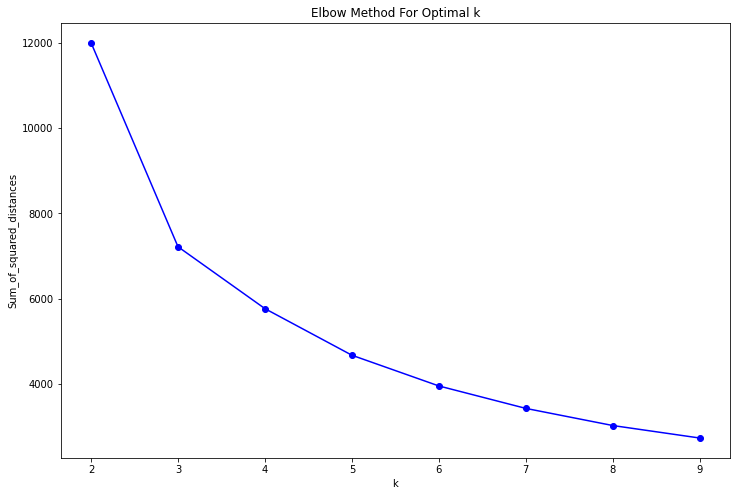

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bo-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this we can see,we can make cluster at 2 or 3

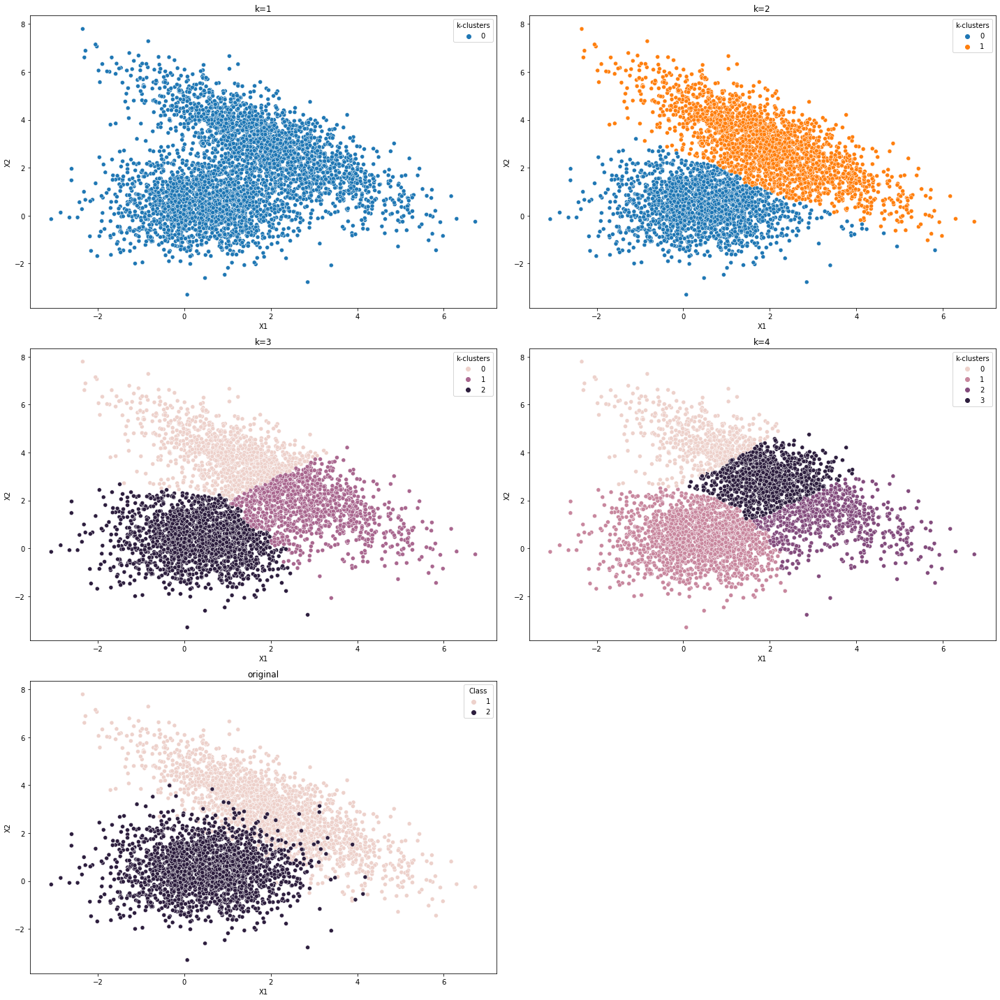

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,5):
    
    #Cutting the tree into clusters
    kmean = KMeans(n_clusters = i)
    kmean.fit(df.iloc[:,:-1])
    df['k-clusters'] = kmean.labels_
    
    #plotting 
    plt.subplot(3,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(3,2,5)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

cluster 2 is looking optimum

In [ ]:
#so we will split into 2 categories
kmean = KMeans(n_clusters=2)
kmean.fit(df.iloc[:,:-2])
df['k-clusters'] = kmean.labels_
df

,X1,X2,cluster_label,k-clusters
0,1.388261,2.076096,0,0
1,2.177247,3.102304,0,0
2,0.378645,5.307610,0,0
3,3.681732,1.622681,0,0
4,2.462861,2.777897,0,0
...,...,...,...,...
4091,0.909687,0.375763,1,1
4092,2.698381,0.511262,0,1
4093,1.078797,1.526153,1,1
4094,1.974889,-0.649343,1,1


In [ ]:
df['original']=df1['Class']
df

,X1,X2,cluster_label,k-clusters,original
0,1.388261,2.076096,0,0,1
1,2.177247,3.102304,0,0,1
2,0.378645,5.307610,0,0,1
3,3.681732,1.622681,0,0,1
4,2.462861,2.777897,0,0,1
...,...,...,...,...,...
4091,0.909687,0.375763,1,1,2
4092,2.698381,0.511262,0,1,2
4093,1.078797,1.526153,1,1,2
4094,1.974889,-0.649343,1,1,2


In [ ]:
df['original']=df['original']-1

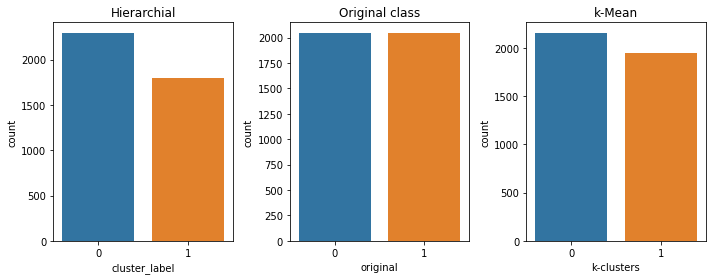

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,3,1)
sns.countplot(df['cluster_label'])
plt.title('Hierarchial')

plt.subplot(1,3,2)
sns.countplot(df['original'])
plt.title('Original class')


plt.subplot(1,3,3)
sns.countplot(df['k-clusters'])
plt.title('k-Mean')


plt.tight_layout()


from this we can see k-means predicted/ divided correctly than hierarchial

1.2 : External Validation

Techniques:
   - Classification accuracy
   - Purity
   - Precision
   - Recall
   - F-Measured
   - Jaccard
   - Rand index
   - Fowlkes Mallows
   - Hubert statistics
   - Entropy 
   - Mutual Information

https://drive.google.com/file/d/1GDHY6iojk0PASg1D5HGdyoCfPvVOZ68z/view?usp=sharing

Through above link math equations for validation metrics can be viewed

##### Rand index:

In [ ]:
from sklearn import metrics

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Rand Index of')
print('Hierarchial clustering:',metrics.rand_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.rand_score(label_true, k_pred),2))

Rand Index of
Hierarchial clustering: 0.8592261904761904
K_Means clustering: 0.91


#### Mutual Information

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Mutual Information of')
print('Hierarchial clustering:',metrics.adjusted_mutual_info_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.adjusted_mutual_info_score(label_true, k_pred),2))


Mutual Information of
Hierarchial clustering: 0.6469161701126437
K_Means clustering: 0.73


#### Homogenity & Completeness

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Homogenity & Completeness of')
print('Hierarchial clustering, Homogenity:',metrics.homogeneity_score(label_true, h_pred))
print('Hierarchial clustering, completeness:',metrics.completeness_score(label_true, h_pred))

print('K_Means clustering,Homogenity:',round(metrics.homogeneity_score(label_true, k_pred),2))
print('K_Means clustering, completeness:',round(metrics.completeness_score(label_true, k_pred),2))



Homogenity & Completeness of
Hierarchial clustering, Homogenity: 0.6435485467984433
Hierarchial clustering, completeness: 0.6504456282980872
K_Means clustering,Homogenity: 0.73
K_Means clustering, completeness: 0.73


#### Fowlkes Mallows Score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Fowlkes Mallows of')
print('Hierarchial clustering:',metrics.fowlkes_mallows_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.fowlkes_mallows_score(label_true, k_pred),2))


Fowlkes Mallows of
Hierarchial clustering: 0.8602399807978651
K_Means clustering: 0.91


#### Jaccard score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Jaccard score of')
print('Hierarchial clustering:',metrics.jaccard_score(label_true, h_pred,average='weighted'))
print('K_Means clustering:',round(metrics.jaccard_score(label_true, k_pred,average='weighted'),2))


Jaccard score of
Hierarchial clustering: 0.8579896907216495
K_Means clustering: 0.91


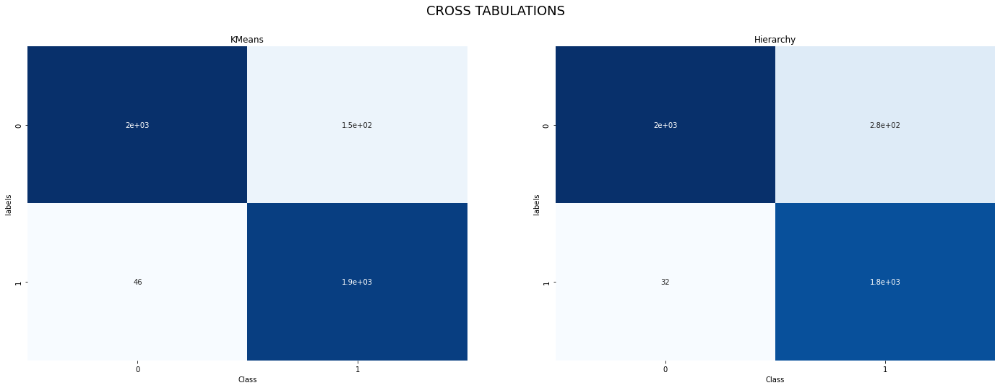

In [ ]:
h_pred = df['cluster_label']
k_pred = df['k-clusters']

# cross tabulation table for kmeans
df_k = pd.DataFrame({'labels':k_pred,"Class":df['original']})
ct1 = pd.crosstab(df_k['labels'],df_k['Class'])

# cross tabulation table for Hierarchy
df_h = pd.DataFrame({'labels':h_pred,"Class":df['original']})
ct2 = pd.crosstab(df_h['labels'],df_h['Class'])


plt.figure(figsize=(24,8))
plt.suptitle("CROSS TABULATIONS",fontsize=18)
plt.subplot(1,2,1)
plt.title("KMeans")
sns.heatmap(ct1,annot=True,cbar=False,cmap="Blues")

plt.subplot(1,2,2)
plt.title("Hierarchy")
sns.heatmap(ct2,annot=True,cbar=False,cmap="Blues")

plt.show()

In [ ]:
from sklearn.metrics.cluster import pair_confusion_matrix

In [ ]:
print('Hierarchial clustering:')
pair_confusion_matrix(label_true, h_pred)

Hierarchial clustering:


array([[7146496, 1242112],
       [1119104, 7265408]])

In [ ]:
print('K_Means clustering:')
pair_confusion_matrix(label_true, k_pred)

K_Means clustering:


array([[7601656,  786952],
       [ 764054, 7620458]])

In [ ]:
#Accuracy score

print('Accuracy score of  Hierarchial clustering:',metrics.accuracy_score(label_true, h_pred))
print('Accuracy score of K_Means clustering:',metrics.accuracy_score(label_true, k_pred))

Accuracy score of  Hierarchial clustering: 0.923828125
Accuracy score of K_Means clustering: 0.951416015625


In [ ]:
#Classification report
print('Classification report of  Hierarchial clustering:\n',metrics.classification_report(label_true, h_pred))
print('Classification report of K_Means clustering:\n',metrics.classification_report(label_true, k_pred))

Classification report of  Hierarchial clustering:
               precision    recall  f1-score   support

           0       0.88      0.98      0.93      2048
           1       0.98      0.86      0.92      2048

    accuracy                           0.92      4096
   macro avg       0.93      0.92      0.92      4096
weighted avg       0.93      0.92      0.92      4096

Classification report of K_Means clustering:
               precision    recall  f1-score   support

           0       0.93      0.98      0.95      2048
           1       0.98      0.93      0.95      2048

    accuracy                           0.95      4096
   macro avg       0.95      0.95      0.95      4096
weighted avg       0.95      0.95      0.95      4096



From above observation we can conclude K-Means is working well

#### 1.3 : Plot of data points according to original class

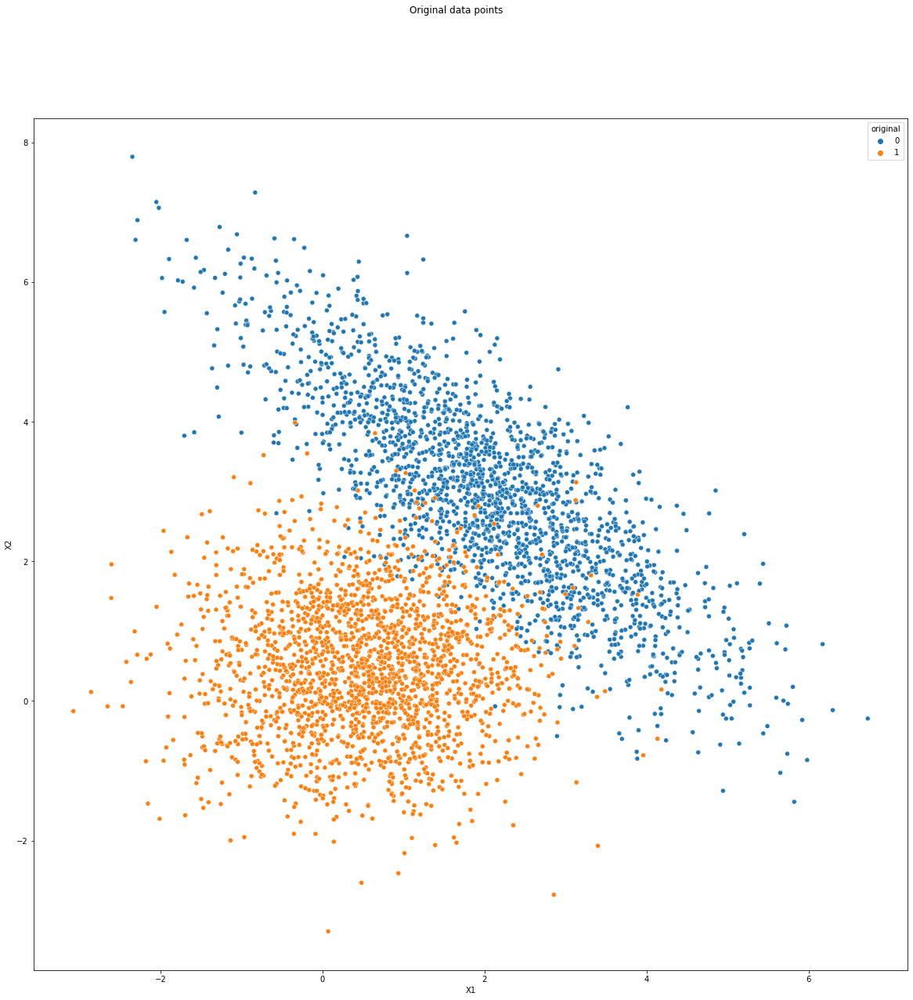

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

sns.scatterplot('X1','X2',data=df,hue='original')


#### 1.4 : Plot of data points according to class by algorithm

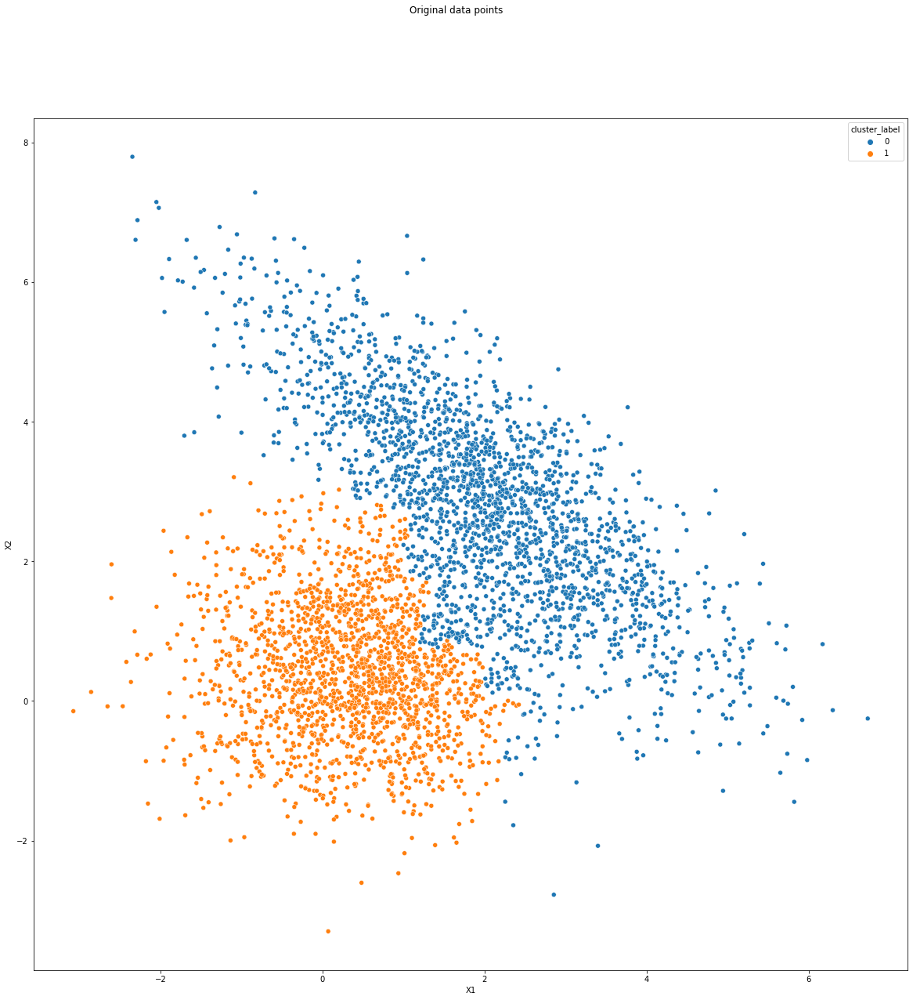

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

sns.scatterplot('X1','X2',data=df,hue='cluster_label')


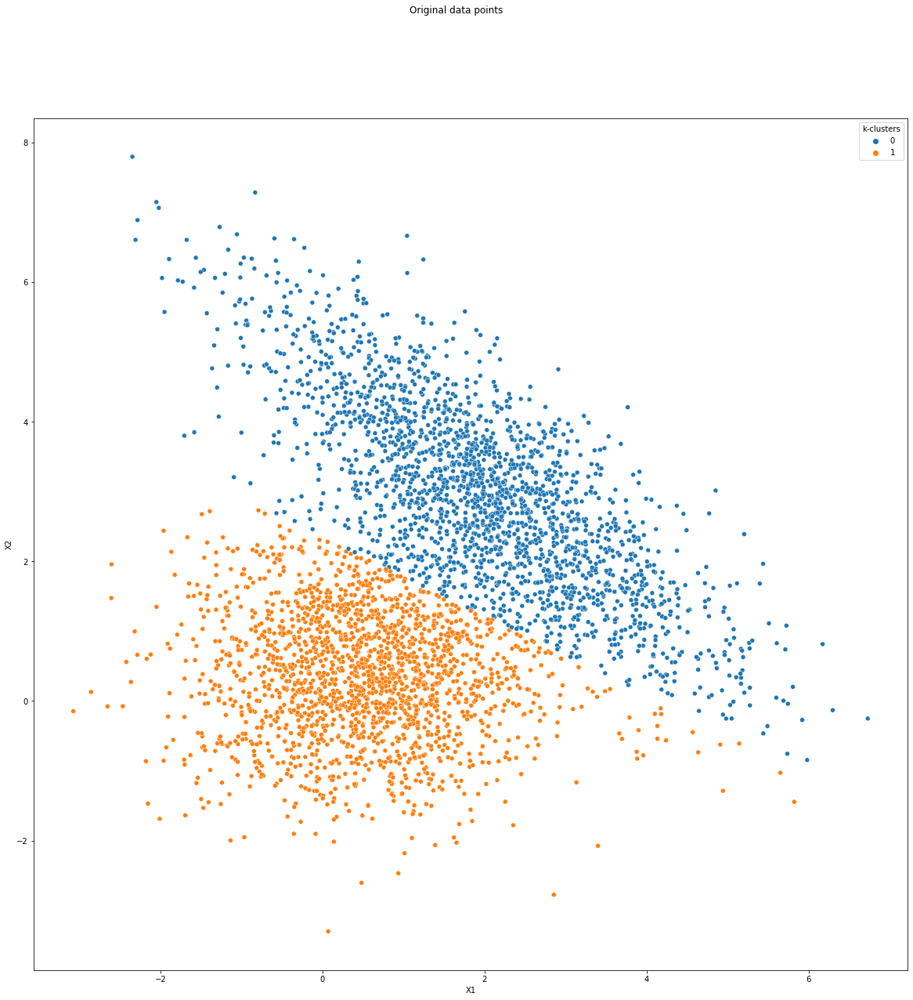

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

sns.scatterplot('X1','X2',data=df,hue='k-clusters')


# Task 1 : Dataset7

In [ ]:
import pandas as pd
import numpy as np
from numpy import where
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [ ]:
from google.colab import files
up = files.upload()


Saving Data7.csv to Data7.csv


In [ ]:
#Importing the datasets
df1 = pd.read_csv('/content/Data7.csv')

In [ ]:
df1.head()

,Unnamed: 0,X1,X2,Class
0,1,-3.000000,-3.000000,5
1,2,-3.000000,3.000000,4
2,3,3.000000,-3.000000,6
3,4,3.000000,3.000000,3
4,5,-0.417091,0.114782,1


In [ ]:
#brief of data
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 770 entries, 0 to 769
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  770 non-null    int64  
 1   X1          770 non-null    float64
 2   X2          770 non-null    float64
 3   Class       770 non-null    int64  
dtypes: float64(2), int64(2)
memory usage: 24.2 KB


## Cleaning data 

we can drop column Unnamed: 0

In [ ]:
df1.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
#Brief stats
df1.describe()

,X1,X2,Class
count,770.000000,770.000000,770.000000
mean,0.015556,0.006572,1.525974
std,0.961348,0.950428,0.636943
min,-3.050000,-3.050000,1.000000
25%,-0.394639,-0.368391,1.000000
50%,0.000048,-0.021113,1.000000
75%,0.395799,0.369805,2.000000
max,3.050000,3.050000,6.000000


In [ ]:
#Skewness
df1.skew()

X1       0.021258
X2       0.036602
Class    2.172964
dtype: float64

skewness is in acceptable range

In [ ]:
#Checking the class column
df1['Class'].value_counts()

1    395
2    363
5      3
4      3
6      3
3      3
Name: Class, dtype: int64

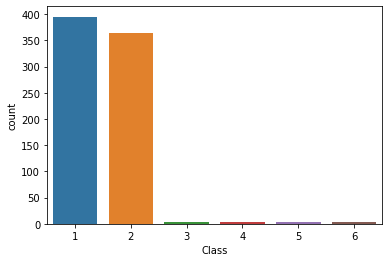

In [ ]:
#Seeing visually
sns.countplot(df1['Class'])

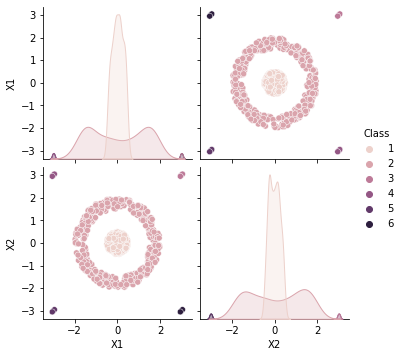

In [ ]:
#Viewing how the clusters are in original
sns.pairplot(df1,hue='Class')

## Task 1.1
- Cluster the dataset based on K-Means & Hierarchial 

making data ready for clustering

In [ ]:
df = df1.drop('Class',axis=1)
df.head()

,X1,X2
0,-3.000000,-3.000000
1,-3.000000,3.000000
2,3.000000,-3.000000
3,3.000000,3.000000
4,-0.417091,0.114782


In [ ]:
df2 = df.to_numpy()
y=df1['Class']

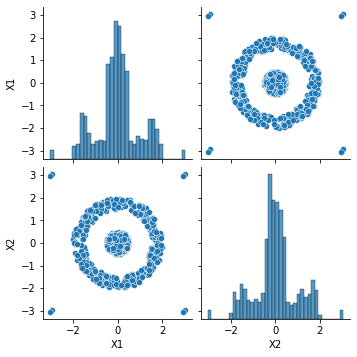

In [ ]:
sns.pairplot(df)

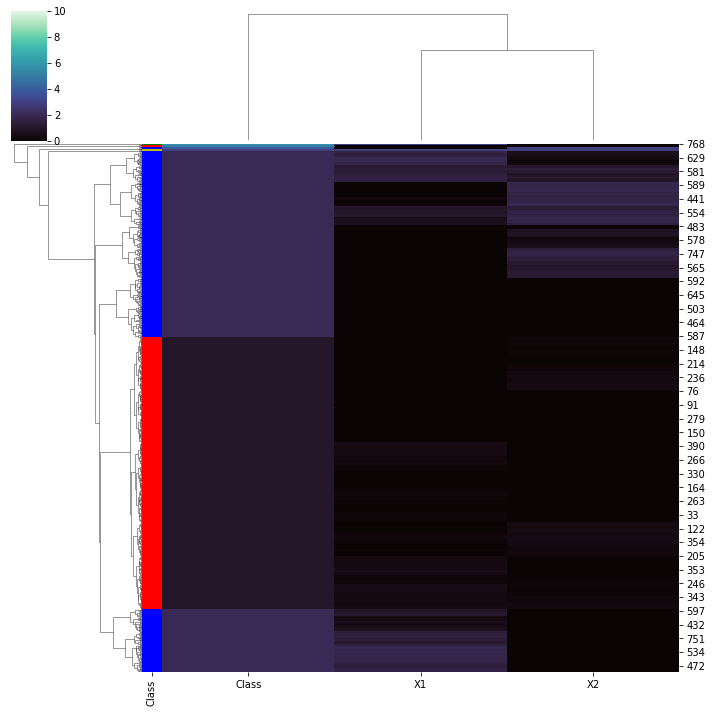

In [ ]:
ut = dict(zip(df1['Class'].unique(), "rbgyrbg"))
row_colors = df1['Class'].map(ut)
g = sns.clustermap(df1, row_colors=row_colors,cmap="mako", vmin=0, vmax=10)

#### Hierarchial clustering

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
df.head()

,X1,X2
0,-3.000000,-3.000000
1,-3.000000,3.000000
2,3.000000,-3.000000
3,3.000000,3.000000
4,-0.417091,0.114782


Trying different linkage techniques

Single linkage

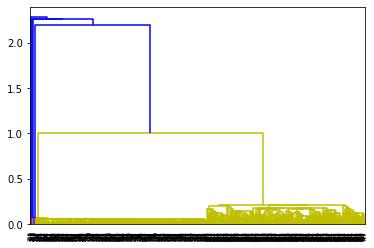

In [ ]:
#Single linkage
mergings = linkage(df,method='single',metric='euclidean')
dendrogram(mergings)
plt.show()

No better understanding

Complete linkage

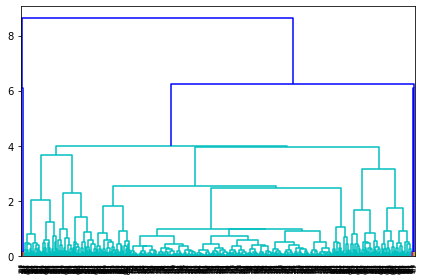

In [ ]:
#complete linkage
mergings = linkage(df,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 3

ward linkage

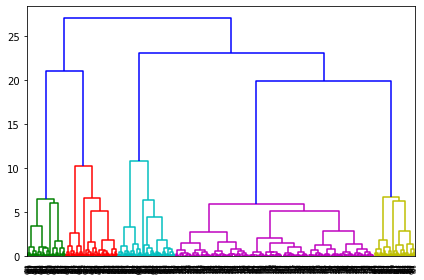

In [ ]:
mergings = linkage(df,method='ward',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 5

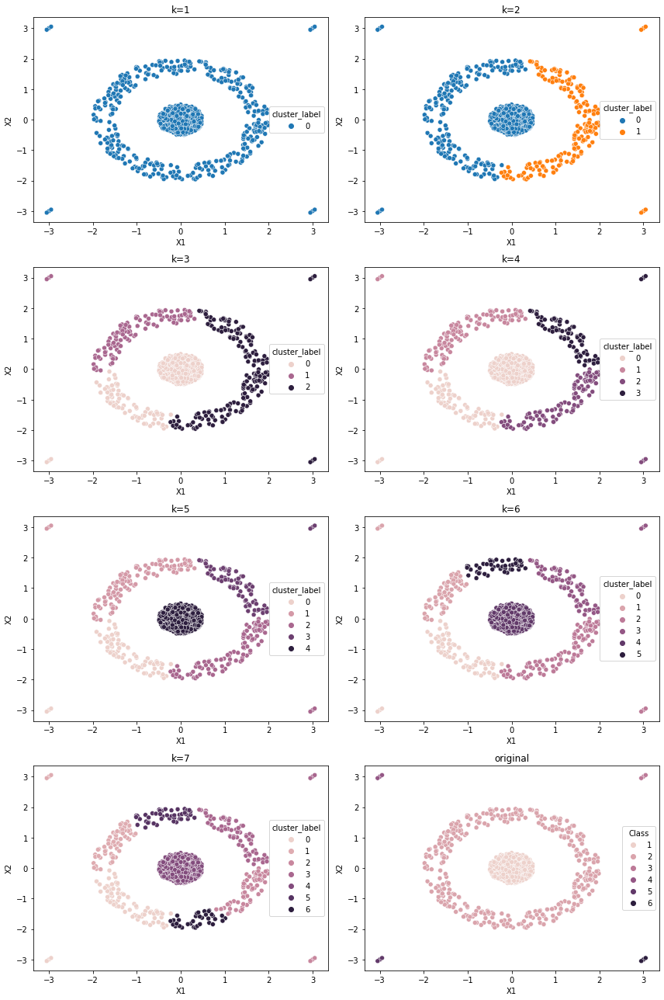

In [ ]:
plt.figure(figsize=(12,18))
for i in range(1,8):
    
    #Cutting the tree into clusters
    cluster_labels = cut_tree(mergings,n_clusters=i)
    cluster_labels=cluster_labels.reshape(-1, )
    df['cluster_label'] = cluster_labels
    
    #plotting 
    plt.subplot(4,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(4,2,8)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

splitting into 6

In [ ]:
#so we will split into 6 categories
cluster_labels = cut_tree(mergings,n_clusters=6)
cluster_labels=cluster_labels.reshape(-1, )
df['cluster_label'] = cluster_labels
df

,X1,X2,cluster_label
0,-3.000000,-3.000000,0
1,-3.000000,3.000000,1
2,3.000000,-3.000000,2
3,3.000000,3.000000,3
4,-0.417091,0.114782,4
...,...,...,...
765,-1.604434,-1.118861,0
766,-3.050000,-3.050000,0
767,-3.050000,2.950000,1
768,2.950000,-3.050000,2


#### K-Means clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df)
    
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 1522.852142854621
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 930.3638666290983
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 675.8878995573111
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 466.9867406514357
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 294.60368372119694
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 238.87524875587468
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 214.50849395254085
----------

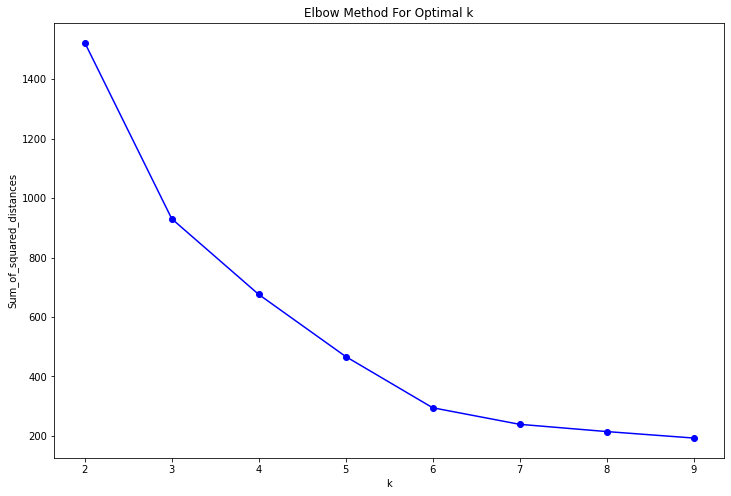

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bo-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this we can see,we can make cluster at 6

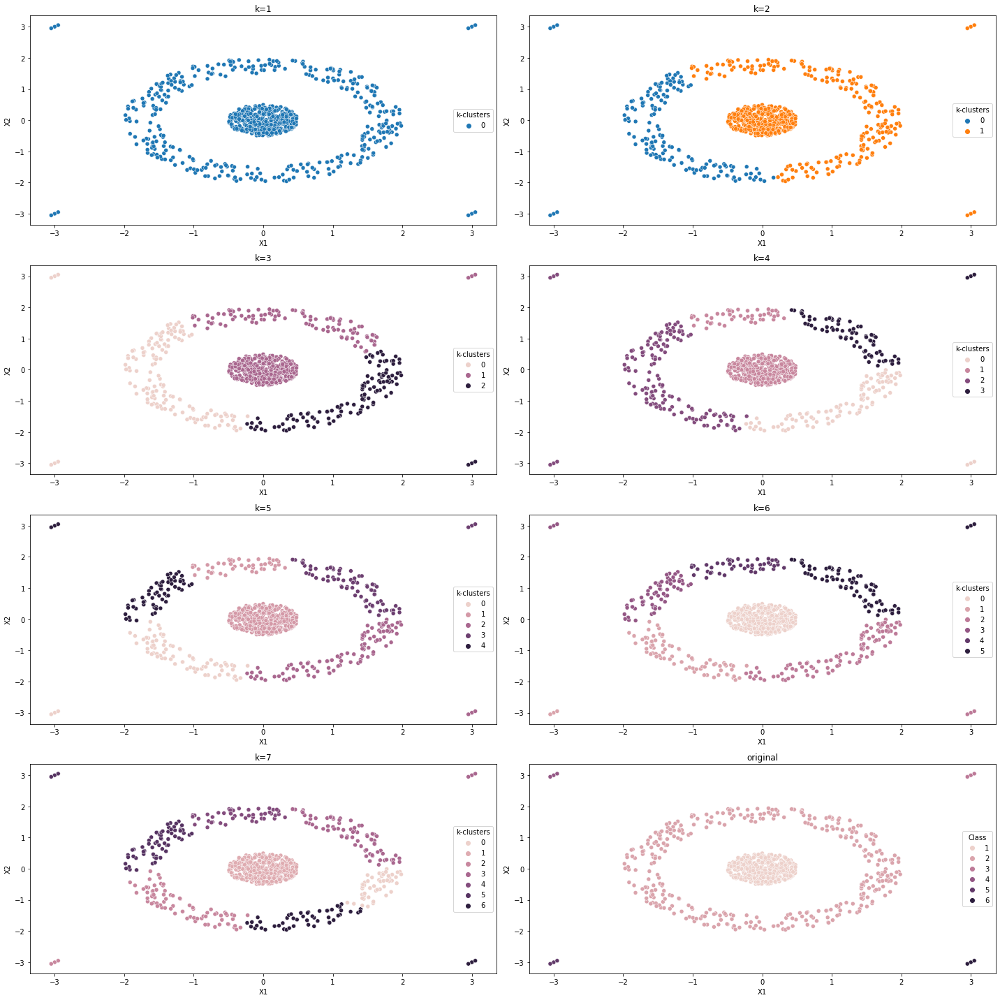

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,8):
    
    #Cutting the tree into clusters
    kmean = KMeans(n_clusters = i)
    kmean.fit(df.iloc[:,:-1])
    df['k-clusters'] = kmean.labels_
    
    #plotting 
    plt.subplot(4,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(4,2,8)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

In [ ]:
#so we will split into 6 categories
kmean = KMeans(n_clusters=6)
kmean.fit(df.iloc[:,:-2])
df['k-clusters'] = kmean.labels_
df

,X1,X2,cluster_label,k-clusters
0,-3.000000,-3.000000,0,2
1,-3.000000,3.000000,1,1
2,3.000000,-3.000000,2,0
3,3.000000,3.000000,3,3
4,-0.417091,0.114782,4,5
...,...,...,...,...
765,-1.604434,-1.118861,0,2
766,-3.050000,-3.050000,0,2
767,-3.050000,2.950000,1,1
768,2.950000,-3.050000,2,0


In [ ]:
df['original']=df1['Class']
df

,X1,X2,cluster_label,k-clusters,original
0,-3.000000,-3.000000,0,2,5
1,-3.000000,3.000000,1,1,4
2,3.000000,-3.000000,2,0,6
3,3.000000,3.000000,3,3,3
4,-0.417091,0.114782,4,5,1
...,...,...,...,...,...
765,-1.604434,-1.118861,0,2,2
766,-3.050000,-3.050000,0,2,5
767,-3.050000,2.950000,1,1,4
768,2.950000,-3.050000,2,0,6


In [ ]:
df['original']=df['original']-1

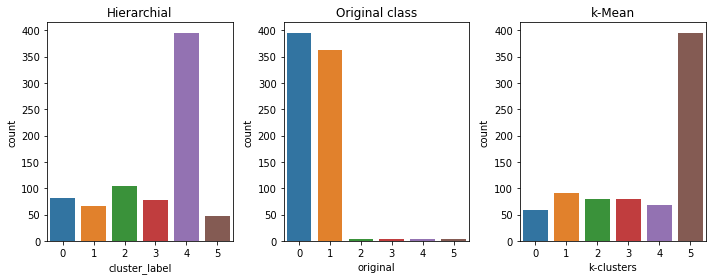

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,3,1)
sns.countplot(df['cluster_label'])
plt.title('Hierarchial')

plt.subplot(1,3,2)
sns.countplot(df['original'])
plt.title('Original class')


plt.subplot(1,3,3)
sns.countplot(df['k-clusters'])
plt.title('k-Mean')


plt.tight_layout()


1.2 External Validation

Techniques:
   - Classification accuracy
   - Purity
   - Precision
   - Recall
   - F-Measured
   - Jaccard
   - Rand index
   - Fowlkes Mallows
   - Hubert statistics
   - Entropy 
   - Mutual Information

https://drive.google.com/file/d/1GDHY6iojk0PASg1D5HGdyoCfPvVOZ68z/view?usp=sharing


Through above link math equations for validation metrics can be viewed

##### Rand index:

In [ ]:
from sklearn import metrics

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Rand Index of')
print('Hierarchial clustering:',metrics.rand_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.rand_score(label_true, k_pred),2))

Rand Index of
Hierarchial clustering: 0.8214479928394103
K_Means clustering: 0.82


#### Mutual Information

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Mutual Information of')
print('Hierarchial clustering:',metrics.adjusted_mutual_info_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.adjusted_mutual_info_score(label_true, k_pred),2))


Mutual Information of
Hierarchial clustering: 0.6337179256190634
K_Means clustering: 0.63


#### Homogenity & Completeness

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Homogenity & Completeness of')
print('Hierarchial clustering, Homogenity:',metrics.homogeneity_score(label_true, h_pred))
print('Hierarchial clustering, completeness:',metrics.completeness_score(label_true, h_pred))

print('K_Means clustering,Homogenity:',round(metrics.homogeneity_score(label_true, k_pred),2))
print('K_Means clustering, completeness:',round(metrics.completeness_score(label_true, k_pred),2))



Homogenity & Completeness of
Hierarchial clustering, Homogenity: 0.9149463419453023
Hierarchial clustering, completeness: 0.49051748652292504
K_Means clustering,Homogenity: 0.92
K_Means clustering, completeness: 0.49


#### Fowlkes Mallows Score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Fowlkes Mallows of')
print('Hierarchial clustering:',metrics.fowlkes_mallows_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.fowlkes_mallows_score(label_true, k_pred),2))


Fowlkes Mallows of
Hierarchial clustering: 0.7948341762290656
K_Means clustering: 0.79


#### Jaccard score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Jaccard score of')
print('Hierarchial clustering:',metrics.jaccard_score(label_true, h_pred,average='weighted'))
print('K_Means clustering:',round(metrics.jaccard_score(label_true, k_pred,average='weighted'),2))


Jaccard score of
Hierarchial clustering: 0.08114754098360656
K_Means clustering: 0.11


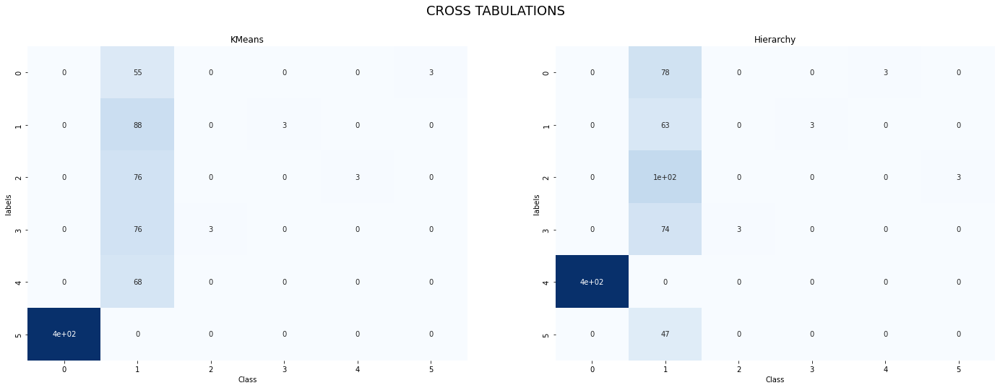

In [ ]:
h_pred = df['cluster_label']
k_pred = df['k-clusters']

# cross tabulation table for kmeans
df_k = pd.DataFrame({'labels':k_pred,"Class":df['original']})
ct1 = pd.crosstab(df_k['labels'],df_k['Class'])

# cross tabulation table for Hierarchy
df_h = pd.DataFrame({'labels':h_pred,"Class":df['original']})
ct2 = pd.crosstab(df_h['labels'],df_h['Class'])


plt.figure(figsize=(24,8))
plt.suptitle("CROSS TABULATIONS",fontsize=18)
plt.subplot(1,2,1)
plt.title("KMeans")
sns.heatmap(ct1,annot=True,cbar=False,cmap="Blues")

plt.subplot(1,2,2)
plt.title("Hierarchy")
sns.heatmap(ct2,annot=True,cbar=False,cmap="Blues")

plt.show()

In [ ]:
from sklearn.metrics.cluster import pair_confusion_matrix

In [ ]:
print('Hierarchial clustering:')
pair_confusion_matrix(label_true, h_pred)

Hierarchial clustering:


array([[303174,   1896],
       [103830, 183230]])

In [ ]:
print('K_Means clustering:')
pair_confusion_matrix(label_true, k_pred)

K_Means clustering:


array([[303300,   1770],
       [104824, 182236]])

In [ ]:
#Accuracy score

print('Accuracy score of  Hierarchial clustering:',metrics.accuracy_score(label_true, h_pred))
print('Accuracy score of K_Means clustering:',metrics.accuracy_score(label_true, k_pred))

Accuracy score of  Hierarchial clustering: 0.08181818181818182
Accuracy score of K_Means clustering: 0.11428571428571428


In [ ]:
#Classification report
print('Classification report of  Hierarchial clustering:\n',metrics.classification_report(label_true, h_pred))
print('Classification report of K_Means clustering:\n',metrics.classification_report(label_true, k_pred))

Classification report of  Hierarchial clustering:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       395
           1       0.95      0.17      0.29       363
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         3
           4       0.00      0.00      0.00         3
           5       0.00      0.00      0.00         3

    accuracy                           0.08       770
   macro avg       0.16      0.03      0.05       770
weighted avg       0.45      0.08      0.14       770

Classification report of K_Means clustering:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       395
           1       0.97      0.24      0.39       363
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         3
           4       0.00      0.00      0.00         3
           5       0.00      0.00  

#### 1.3 : Plot of data points according to original class

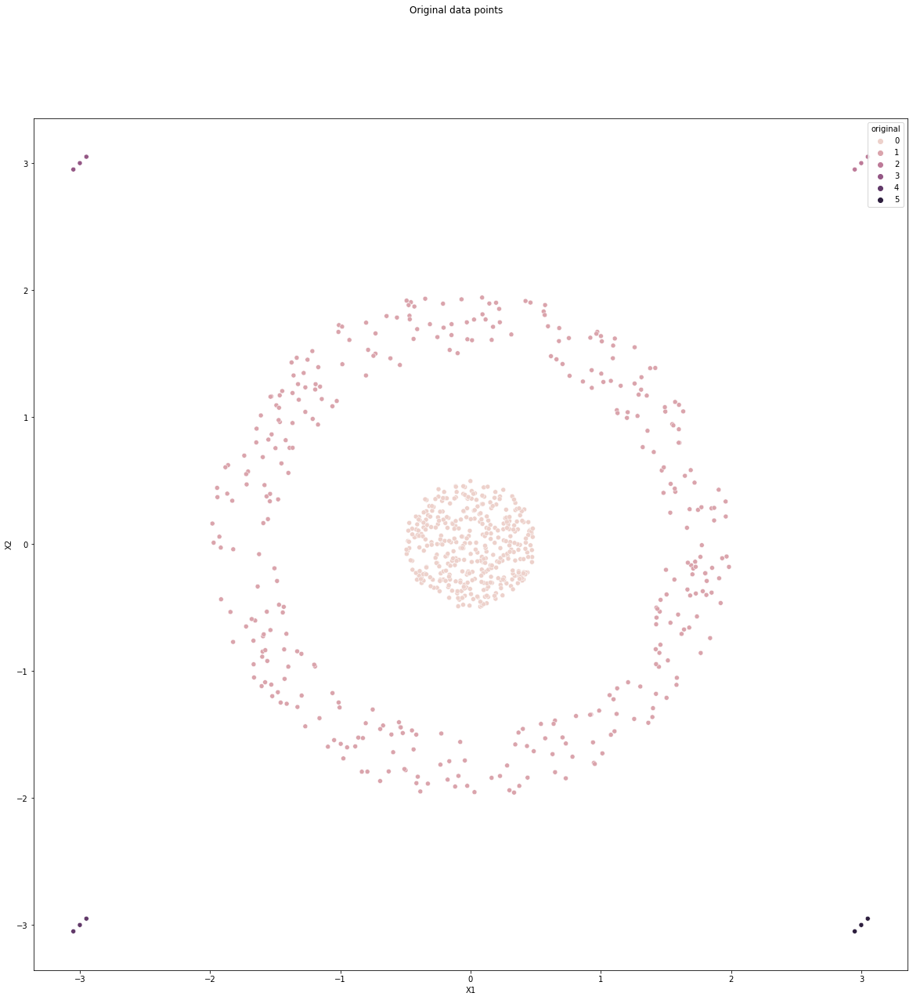

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

sns.scatterplot('X1','X2',data=df,hue='original')


#### 1.4 : Plot of data points according to class by algorithm

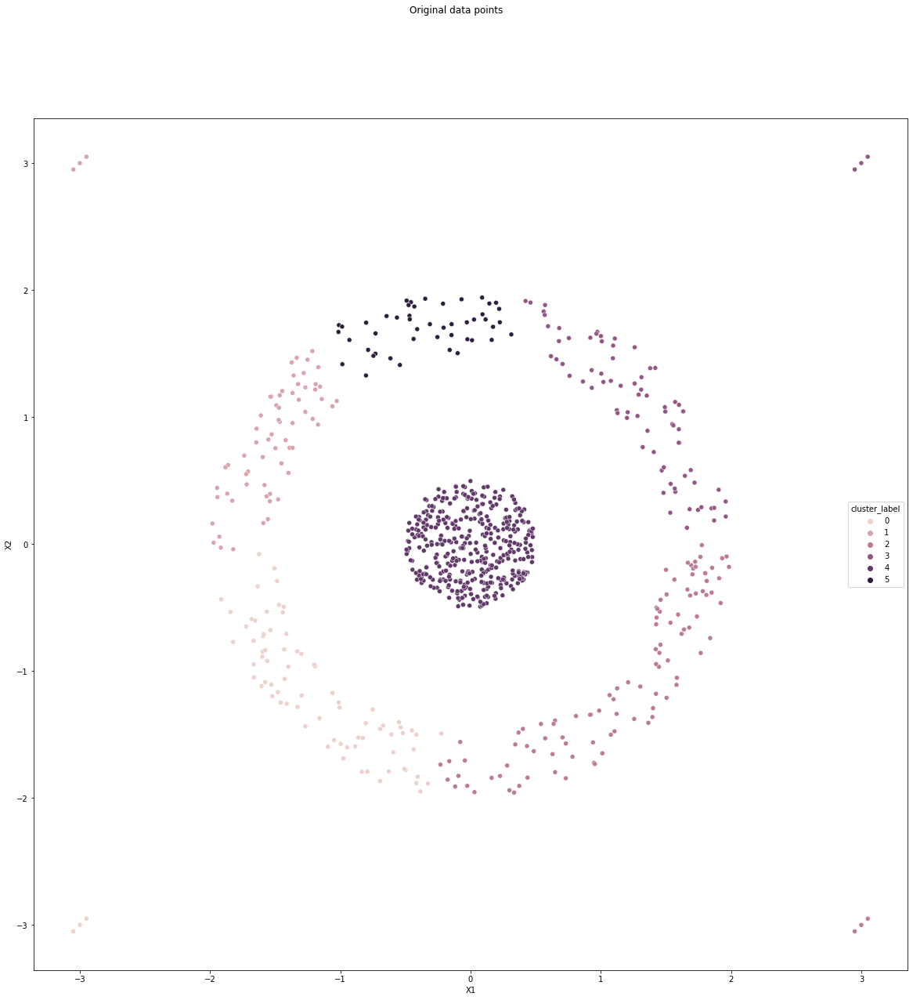

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

sns.scatterplot('X1','X2',data=df,hue='cluster_label')

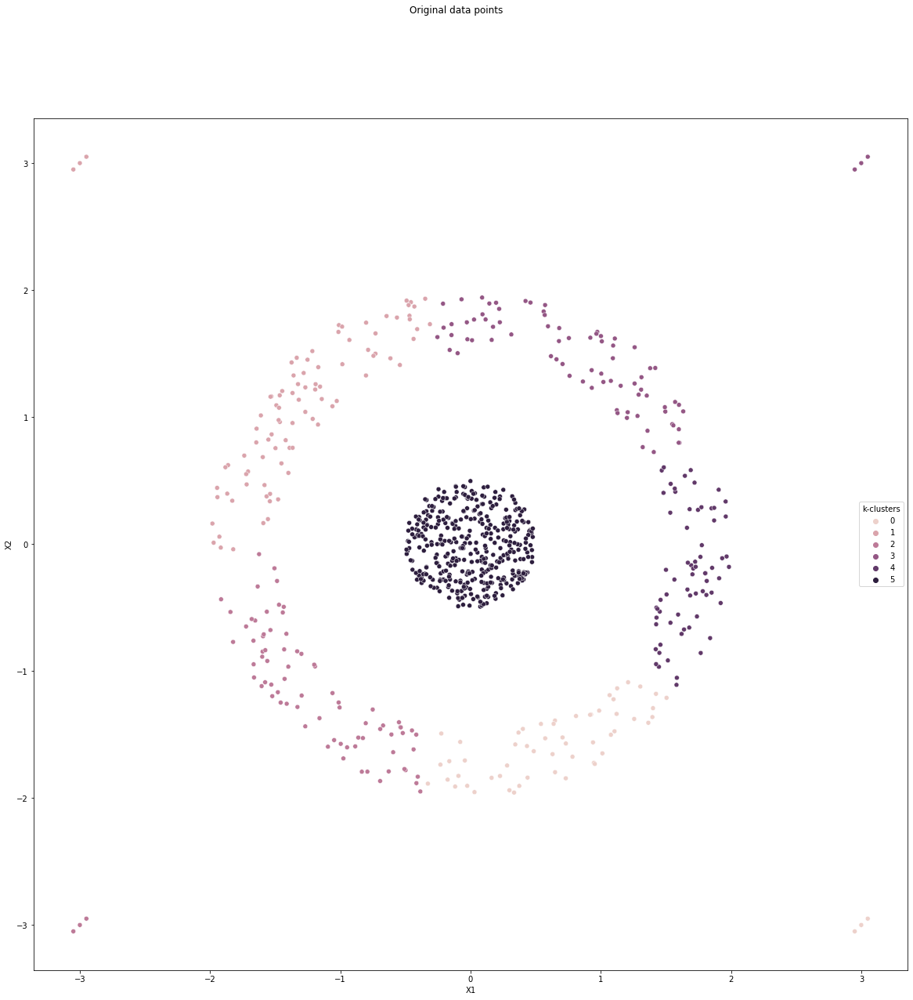

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

sns.scatterplot('X1','X2',data=df,hue='k-clusters')


# Task 1 : Dataset8

In [ ]:
import pandas as pd
import numpy as np
from numpy import where
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [ ]:
from google.colab import files
up = files.upload()

Saving Data8.csv to Data8.csv


In [ ]:
#Importing the datasets
df1 = pd.read_csv('/content/Data8.csv')

In [ ]:
df1.head()

,Unnamed: 0,X1,X2,X3,Class
0,1,0.000000,0.000000,1.00000,1
1,2,0.000000,0.052336,0.99863,1
2,3,0.049774,0.016173,0.99863,1
3,4,0.030762,-0.042341,0.99863,1
4,5,-0.030762,-0.042341,0.99863,1


In [ ]:
#brief of data
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4002 entries, 0 to 4001
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  4002 non-null   int64  
 1   X1          4002 non-null   float64
 2   X2          4002 non-null   float64
 3   X3          4002 non-null   float64
 4   Class       4002 non-null   int64  
dtypes: float64(3), int64(2)
memory usage: 156.5 KB


## Cleaning data 

we can drop column Unnamed: 0

In [ ]:
df1.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
#Brief stats
df1.describe()

,X1,X2,X3,Class
count,4.002000e+03,4.002000e+03,4.002000e+03,4002.0
mean,-7.221513e-19,-3.722590e-18,-7.573485e-18,1.0
std,5.792099e-01,5.792099e-01,5.738309e-01,0.0
min,-1.000000e+00,-1.000000e+00,-1.000000e+00,1.0
25%,-5.069495e-01,-5.039030e-01,-5.000000e-01,1.0
50%,0.000000e+00,0.000000e+00,0.000000e+00,1.0
75%,5.069495e-01,5.039030e-01,5.000000e-01,1.0
max,1.000000e+00,1.000000e+00,1.000000e+00,1.0


In [ ]:
#Skewness
df1.skew()

X1       0.000000e+00
X2       0.000000e+00
X3       7.522755e-17
Class    0.000000e+00
dtype: float64

skewness is in acceptable range

In [ ]:
#Checking the class column
df1['Class'].value_counts()

1    4002
Name: Class, dtype: int64

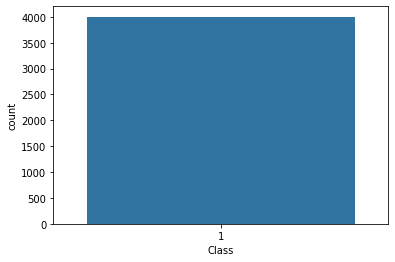

In [ ]:
#Seeing visually
sns.countplot(df1['Class'])

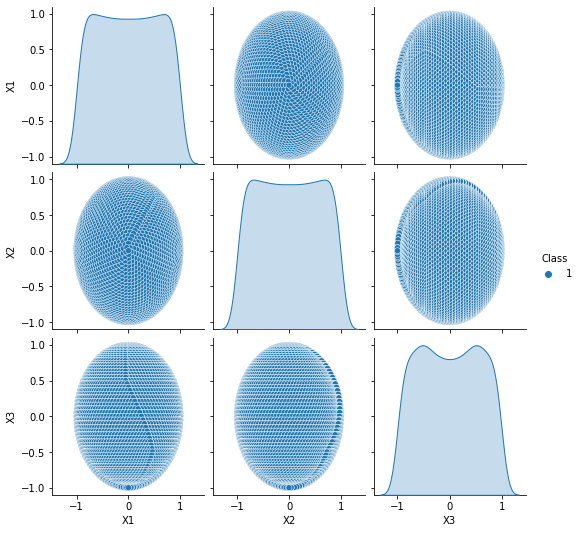

In [ ]:
#Viewing how the clusters are in original
sns.pairplot(df1,hue='Class')

## Task 1.1
- Cluster the dataset based on K-Means & Hierarchial 

making data ready for clustering

In [ ]:
df = df1.drop('Class',axis=1)
df.head()

,X1,X2,X3
0,0.000000,0.000000,1.00000
1,0.000000,0.052336,0.99863
2,0.049774,0.016173,0.99863
3,0.030762,-0.042341,0.99863
4,-0.030762,-0.042341,0.99863


In [ ]:
df2 = df.to_numpy()
y=df1['Class']

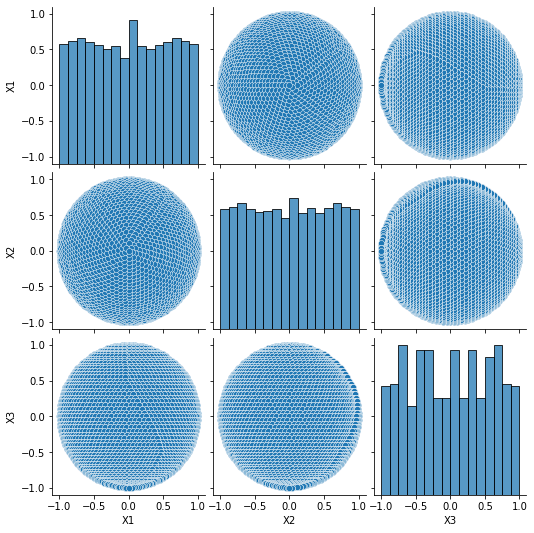

In [ ]:
sns.pairplot(df)

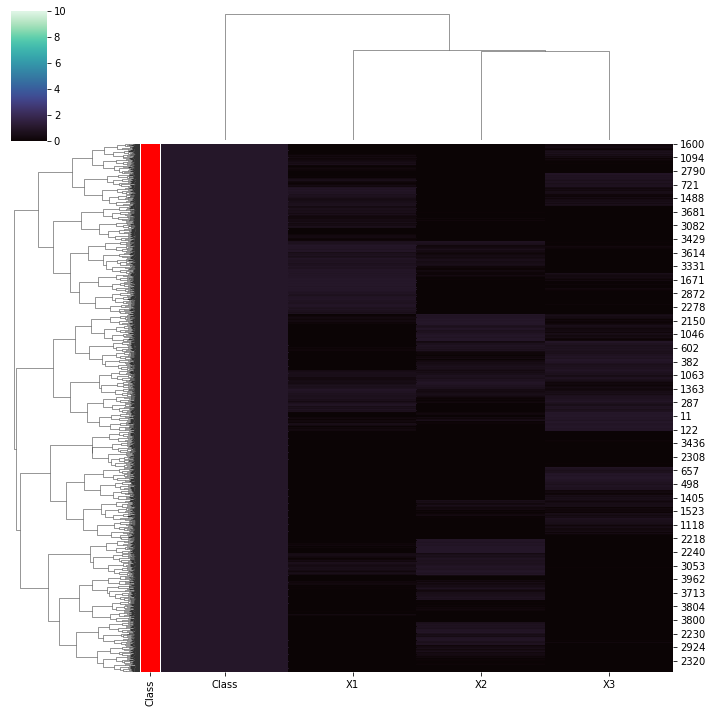

In [ ]:
ut = dict(zip(df1['Class'].unique(), "rbgyrbg"))
row_colors = df1['Class'].map(ut)
g = sns.clustermap(df1, row_colors=row_colors,cmap="mako", vmin=0, vmax=10)

#### Hierarchial clustering

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
df.head()

,X1,X2,X3
0,0.000000,0.000000,1.00000
1,0.000000,0.052336,0.99863
2,0.049774,0.016173,0.99863
3,0.030762,-0.042341,0.99863
4,-0.030762,-0.042341,0.99863


Trying different linkage techniques

Single linkage

Complete linkage

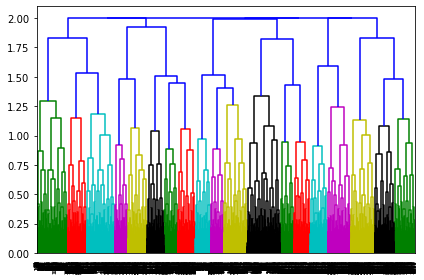

In [ ]:
#complete linkage
mergings = linkage(df,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 1

ward linkage

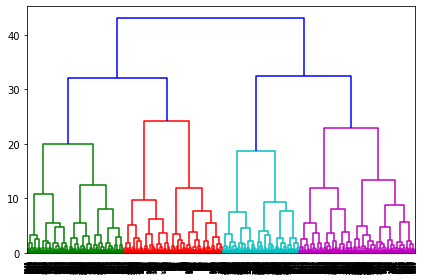

In [ ]:
mergings = linkage(df,method='ward',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()

From this we can split into 2

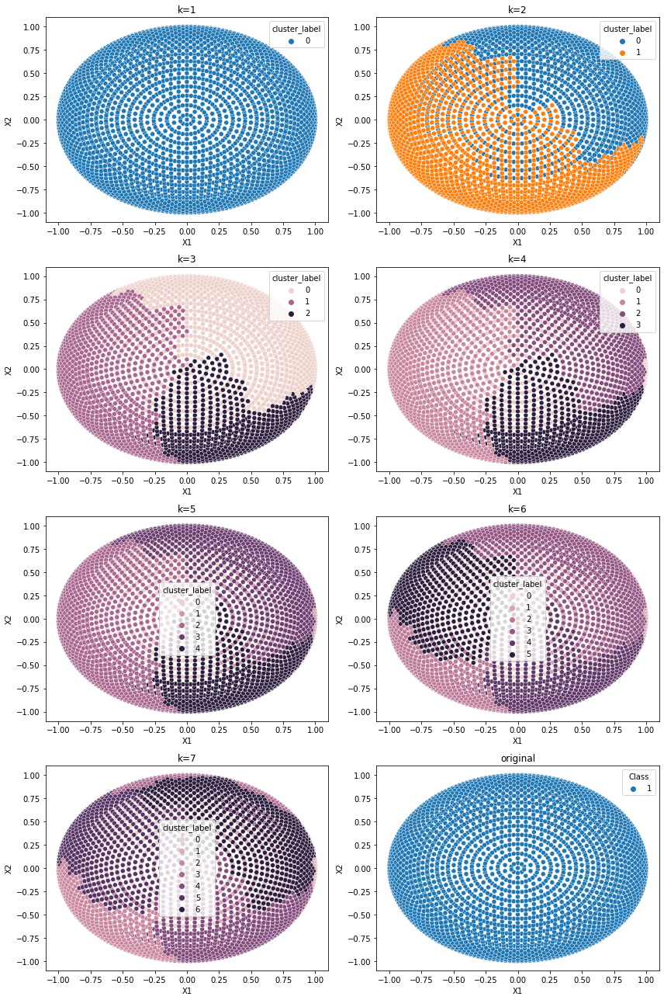

In [ ]:
plt.figure(figsize=(12,18))
for i in range(1,8):
    
    #Cutting the tree into clusters
    cluster_labels = cut_tree(mergings,n_clusters=i)
    cluster_labels=cluster_labels.reshape(-1, )
    df['cluster_label'] = cluster_labels
    
    #plotting 
    plt.subplot(4,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(4,2,8)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

splitting into 1

In [ ]:
#so we will split into 1 categories
cluster_labels = cut_tree(mergings,n_clusters=1)
cluster_labels=cluster_labels.reshape(-1, )
df['cluster_label'] = cluster_labels
df

,X1,X2,X3,cluster_label
0,0.000000,0.000000,1.00000,0
1,0.000000,0.052336,0.99863,0
2,0.049774,0.016173,0.99863,0
3,0.030762,-0.042341,0.99863,0
4,-0.030762,-0.042341,0.99863,0
...,...,...,...,...
3997,0.049774,-0.016173,-0.99863,0
3998,0.000000,-0.052336,-0.99863,0
3999,-0.049774,-0.016173,-0.99863,0
4000,-0.030762,0.042341,-0.99863,0


#### K-Means clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(df)
    
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 2991.8731968669827
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 2296.194275816574
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 1779.0237205760004
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 1496.3150851711814
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 1225.861073845667
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 1086.2262041631259
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 954.3680224451432
---------

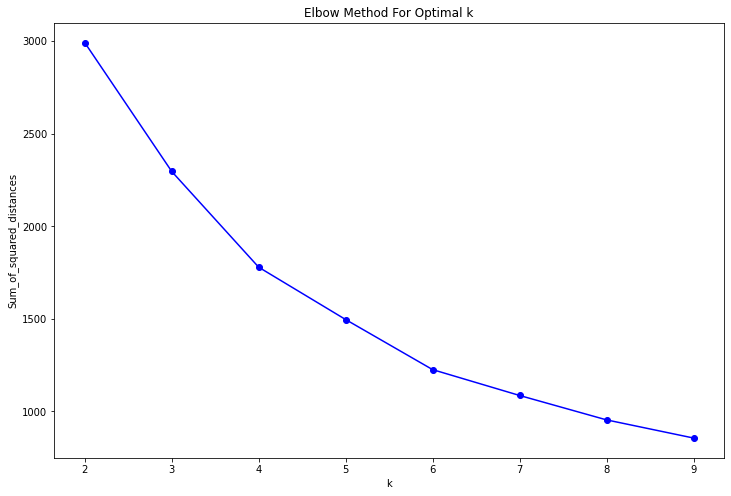

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bo-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From this we can see,we can make cluster at 2 or 3

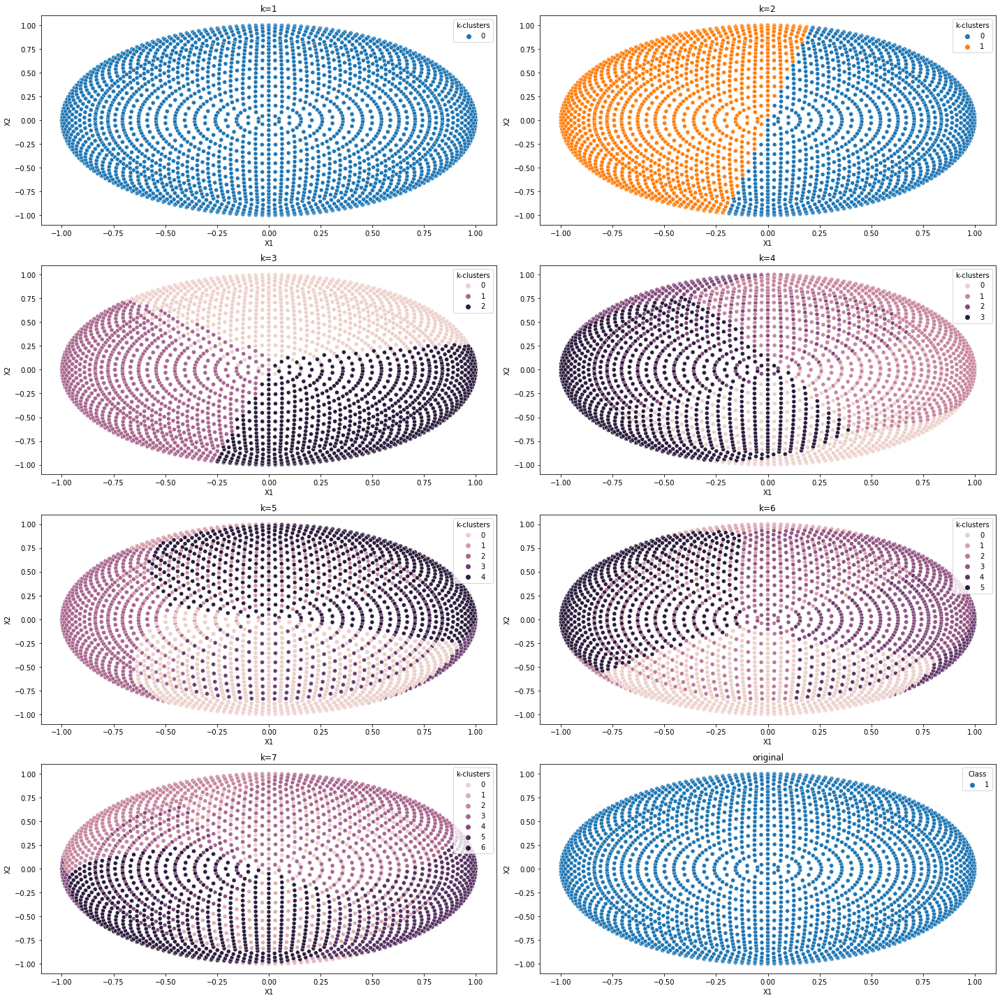

In [ ]:
plt.figure(figsize=(20,20))
for i in range(1,8):
    
    #Cutting the tree into clusters
    kmean = KMeans(n_clusters = i)
    kmean.fit(df.iloc[:,:-1])
    df['k-clusters'] = kmean.labels_
    
    #plotting 
    plt.subplot(4,2,i)
    plt.title(f'k={i}')
    sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(4,2,8)
plt.title('original')
sns.scatterplot('X1','X2',data=df1,hue='Class')
plt.tight_layout()

In [ ]:
#so we will split into 6 categories
kmean = KMeans(n_clusters=1)
kmean.fit(df.iloc[:,:-2])
df['k-clusters'] = kmean.labels_
df

,X1,X2,X3,cluster_label,k-clusters
0,0.000000,0.000000,1.00000,0,0
1,0.000000,0.052336,0.99863,0,0
2,0.049774,0.016173,0.99863,0,0
3,0.030762,-0.042341,0.99863,0,0
4,-0.030762,-0.042341,0.99863,0,0
...,...,...,...,...,...
3997,0.049774,-0.016173,-0.99863,0,0
3998,0.000000,-0.052336,-0.99863,0,0
3999,-0.049774,-0.016173,-0.99863,0,0
4000,-0.030762,0.042341,-0.99863,0,0


In [ ]:
df['original']=df1['Class']
df

,X1,X2,X3,cluster_label,k-clusters,original
0,0.000000,0.000000,1.00000,0,0,1
1,0.000000,0.052336,0.99863,0,0,1
2,0.049774,0.016173,0.99863,0,0,1
3,0.030762,-0.042341,0.99863,0,0,1
4,-0.030762,-0.042341,0.99863,0,0,1
...,...,...,...,...,...,...
3997,0.049774,-0.016173,-0.99863,0,0,1
3998,0.000000,-0.052336,-0.99863,0,0,1
3999,-0.049774,-0.016173,-0.99863,0,0,1
4000,-0.030762,0.042341,-0.99863,0,0,1


In [ ]:
df['original']=df['original']-1

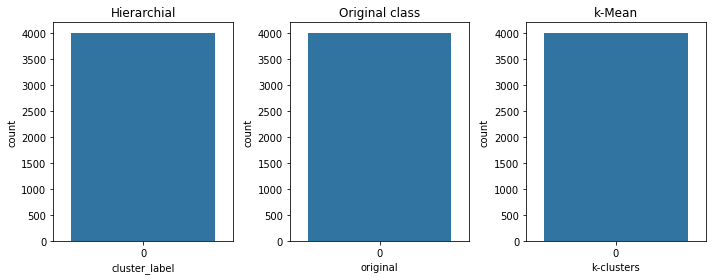

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,3,1)
sns.countplot(df['cluster_label'])
plt.title('Hierarchial')

plt.subplot(1,3,2)
sns.countplot(df['original'])
plt.title('Original class')


plt.subplot(1,3,3)
sns.countplot(df['k-clusters'])
plt.title('k-Mean')


plt.tight_layout()


1.2: External Validation

Techniques:
   - Classification accuracy
   - Purity
   - Precision
   - Recall
   - F-Measured
   - Jaccard
   - Rand index
   - Fowlkes Mallows
   - Hubert statistics
   - Entropy 
   - Mutual Information

https://drive.google.com/file/d/1GDHY6iojk0PASg1D5HGdyoCfPvVOZ68z/view?usp=sharing

Through above link math equations for validation metrics can be viewed

##### Rand index:

In [ ]:
from sklearn import metrics

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Rand Index of')
print('Hierarchial clustering:',metrics.rand_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.rand_score(label_true, k_pred),2))

Rand Index of
Hierarchial clustering: 1.0
K_Means clustering: 1.0


#### Mutual Information

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Mutual Information of')
print('Hierarchial clustering:',metrics.adjusted_mutual_info_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.adjusted_mutual_info_score(label_true, k_pred),2))


Mutual Information of
Hierarchial clustering: 1.0
K_Means clustering: 1.0


#### Homogenity & Completeness

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Homogenity & Completeness of')
print('Hierarchial clustering, Homogenity:',metrics.homogeneity_score(label_true, h_pred))
print('Hierarchial clustering, completeness:',metrics.completeness_score(label_true, h_pred))

print('K_Means clustering,Homogenity:',round(metrics.homogeneity_score(label_true, k_pred),2))
print('K_Means clustering, completeness:',round(metrics.completeness_score(label_true, k_pred),2))



Homogenity & Completeness of
Hierarchial clustering, Homogenity: 1.0
Hierarchial clustering, completeness: 1.0
K_Means clustering,Homogenity: 1.0
K_Means clustering, completeness: 1.0


#### Fowlkes Mallows Score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Fowlkes Mallows of')
print('Hierarchial clustering:',metrics.fowlkes_mallows_score(label_true, h_pred))
print('K_Means clustering:',round(metrics.fowlkes_mallows_score(label_true, k_pred),2))


Fowlkes Mallows of
Hierarchial clustering: 1.0
K_Means clustering: 1.0


#### Jaccard score

In [ ]:
label_true = df['original']
h_pred = df['cluster_label']
k_pred = df['k-clusters']

print('Jaccard score of')
print('Hierarchial clustering:',metrics.jaccard_score(label_true, h_pred,average='weighted'))
print('K_Means clustering:',round(metrics.jaccard_score(label_true, k_pred,average='weighted'),2))


Jaccard score of
Hierarchial clustering: 1.0
K_Means clustering: 1.0


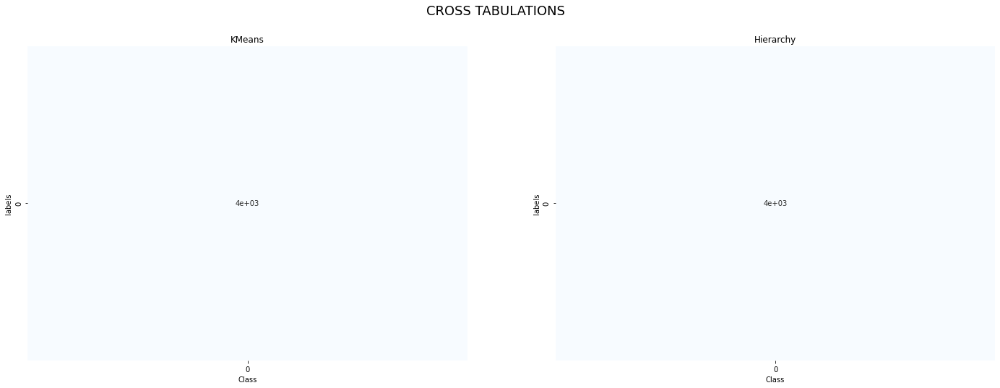

In [ ]:
h_pred = df['cluster_label']
k_pred = df['k-clusters']

# cross tabulation table for kmeans
df_k = pd.DataFrame({'labels':k_pred,"Class":df['original']})
ct1 = pd.crosstab(df_k['labels'],df_k['Class'])

# cross tabulation table for Hierarchy
df_h = pd.DataFrame({'labels':h_pred,"Class":df['original']})
ct2 = pd.crosstab(df_h['labels'],df_h['Class'])


plt.figure(figsize=(24,8))
plt.suptitle("CROSS TABULATIONS",fontsize=18)
plt.subplot(1,2,1)
plt.title("KMeans")
sns.heatmap(ct1,annot=True,cbar=False,cmap="Blues")

plt.subplot(1,2,2)
plt.title("Hierarchy")
sns.heatmap(ct2,annot=True,cbar=False,cmap="Blues")

plt.show()

In [ ]:
from sklearn.metrics.cluster import pair_confusion_matrix

In [ ]:
print('Hierarchial clustering:')
pair_confusion_matrix(label_true, h_pred)

Hierarchial clustering:


array([[       0,        0],
       [       0, 16012002]])

In [ ]:
print('K_Means clustering:')
pair_confusion_matrix(label_true, k_pred)

K_Means clustering:


array([[       0,        0],
       [       0, 16012002]])

In [ ]:
#Accuracy score

print('Accuracy score of  Hierarchial clustering:',metrics.accuracy_score(label_true, h_pred))
print('Accuracy score of K_Means clustering:',metrics.accuracy_score(label_true, k_pred))

Accuracy score of  Hierarchial clustering: 1.0
Accuracy score of K_Means clustering: 1.0


In [ ]:
#Classification report
print('Classification report of  Hierarchial clustering:\n',metrics.classification_report(label_true, h_pred))
print('Classification report of K_Means clustering:\n',metrics.classification_report(label_true, k_pred))

Classification report of  Hierarchial clustering:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      4002

    accuracy                           1.00      4002
   macro avg       1.00      1.00      1.00      4002
weighted avg       1.00      1.00      1.00      4002

Classification report of K_Means clustering:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      4002

    accuracy                           1.00      4002
   macro avg       1.00      1.00      1.00      4002
weighted avg       1.00      1.00      1.00      4002



#### 1.3 : Plot of data points according to original class

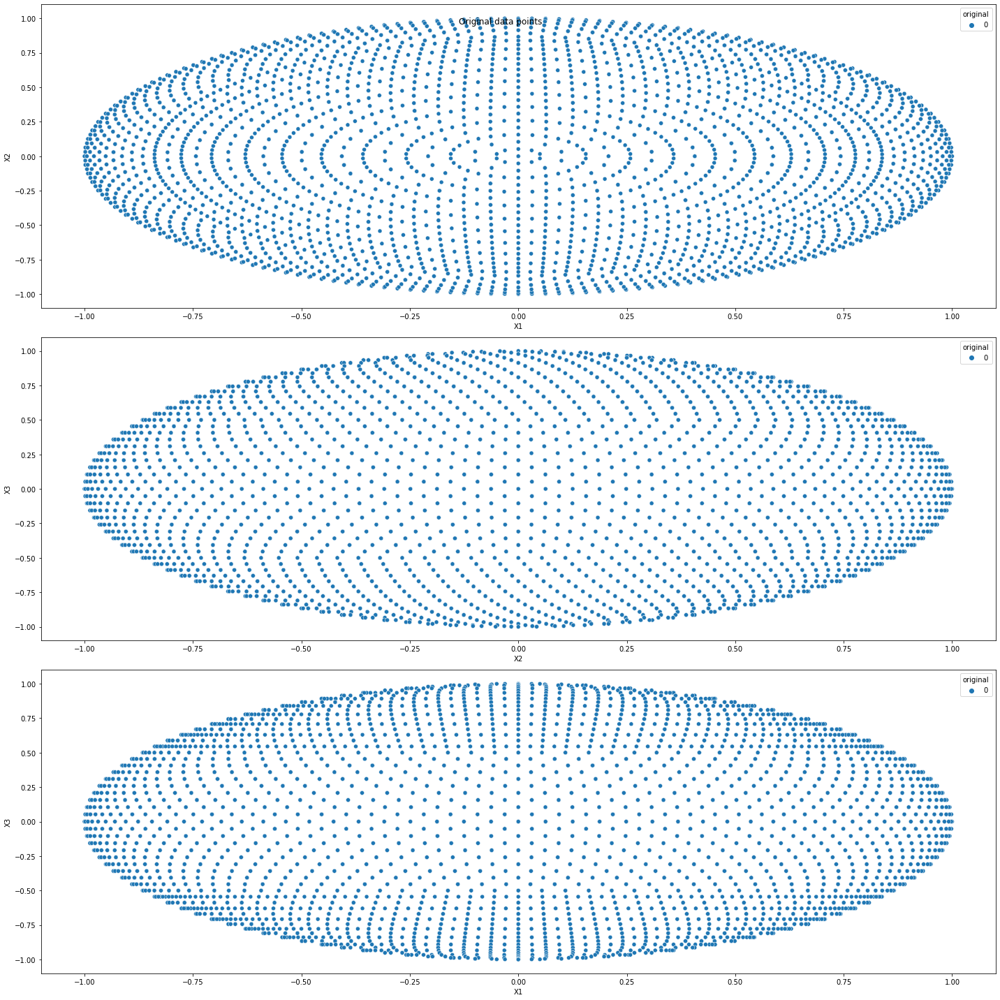

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Original data points')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='original')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='original')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='original')

plt.tight_layout()

#### 1.4 : Plot of data points according to class by algorithm

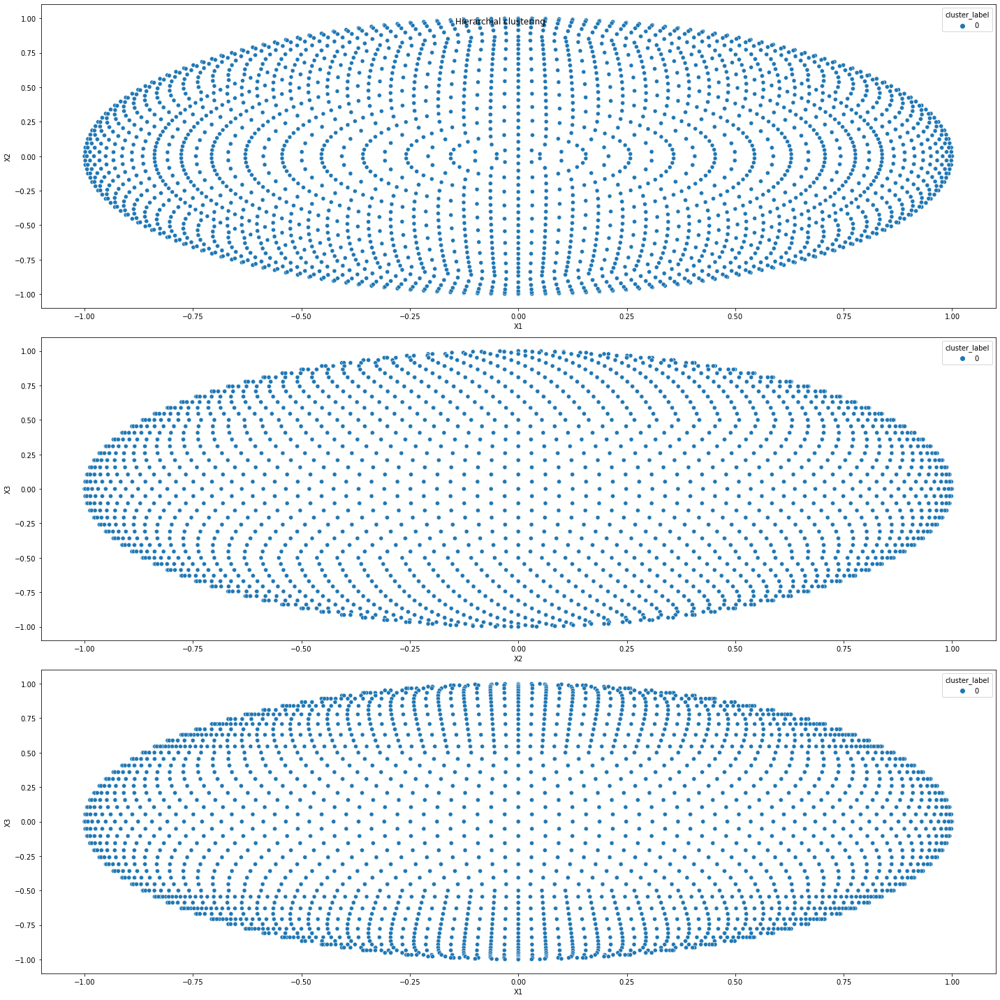

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('Hierarchial clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='cluster_label')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='cluster_label')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='cluster_label')

plt.tight_layout()

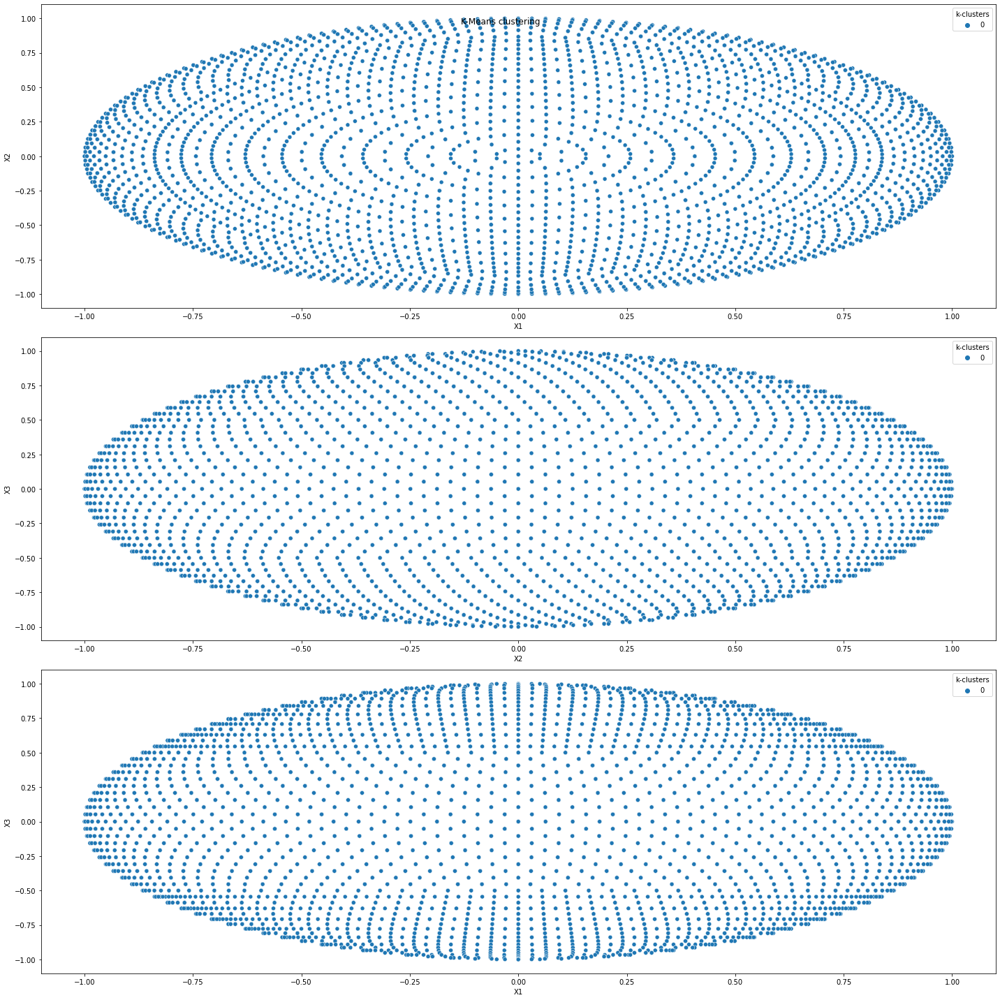

In [ ]:
plt.figure(figsize=(20,20))
plt.suptitle('K-Means clustering')

plt.subplot(3,1,1)
sns.scatterplot('X1','X2',data=df,hue='k-clusters')

plt.subplot(3,1,2)
sns.scatterplot('X2','X3',data=df,hue='k-clusters')

plt.subplot(3,1,3)
sns.scatterplot('X1','X3',data=df,hue='k-clusters')

plt.tight_layout()

# New Section
TASK 2

In [ ]:
#Importing required modules
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
from sklearn.metrics import pairwise_distances
from sklearn import metrics

In [ ]:
from google.colab import files
up = files.upload()

Saving World Indicators.csv to World Indicators (1).csv


In [ ]:
#reading the data
data=pd.read_csv('/content/World Indicators.csv')

In [ ]:
#viewing the top 5 rows
data.head()

,Birth Rate,Business Tax Rate,Days to Start Business,Energy Usage,GDP,Health Exp % GDP,Health Exp/Capita,Hours to do Tax,Infant Mortality Rate,Internet Usage,Lending Interest,Life Expectancy Female,Life Expectancy Male,Mobile Phone Usage,Population 0-14,Population 15-64,Population 65+,Population Urban,Region,Country
0,0.0,72.0%,25.0,41852.0,"$199,070,864,638",0.0,$233,451.0,0.0,0.1,0.1,72.0,69.0,0.9,0.3,0.7,0.0,0.7,Africa,Algeria
1,0.0,52.1%,66.0,13576.0,"$104,115,863,405",0.0,$178,282.0,0.1,0.1,0.2,53.0,50.0,0.5,0.5,0.5,0.0,0.4,Africa,Angola
2,0.0,65.9%,29.0,3761.0,"$7,294,900,431",0.0,$34,270.0,0.1,0.0,NaN,60.0,58.0,0.8,0.4,0.5,0.0,0.4,Africa,Benin
3,0.0,19.5%,60.0,2215.0,"$15,292,424,757",0.1,$404,152.0,0.0,0.1,0.1,46.0,47.0,1.5,0.3,0.6,0.0,0.6,Africa,Botswana
4,0.0,43.5%,13.0,NaN,"$10,395,757,480",0.1,$39,270.0,0.1,0.0,NaN,56.0,55.0,0.5,0.5,0.5,0.0,0.3,Africa,Burkina Faso


From above we can see there are few missing values, majority of columns are float and only two columns are categorical object type

In [ ]:
#viewing the brief details 
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 208 entries, 0 to 207
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Birth Rate              199 non-null    float64
 1   Business Tax Rate       181 non-null    object 
 2   Days to Start Business  181 non-null    float64
 3   Energy Usage            136 non-null    float64
 4   GDP                     188 non-null    object 
 5   Health Exp % GDP        185 non-null    float64
 6   Health Exp/Capita       185 non-null    object 
 7   Hours to do Tax         180 non-null    float64
 8   Infant Mortality Rate   188 non-null    float64
 9   Internet Usage          199 non-null    float64
 10  Lending Interest        131 non-null    float64
 11  Life Expectancy Female  197 non-null    float64
 12  Life Expectancy Male    197 non-null    float64
 13  Mobile Phone Usage      196 non-null    float64
 14  Population 0-14         191 non-null    fl

In [ ]:
#Viewing all the column names
data.columns

Index(['Birth Rate', 'Business Tax Rate', 'Days to Start Business',
       'Energy Usage', 'GDP', 'Health Exp % GDP', 'Health Exp/Capita',
       'Hours to do Tax', 'Infant Mortality Rate', 'Internet Usage',
       'Lending Interest', 'Life Expectancy Female', 'Life Expectancy Male',
       'Mobile Phone Usage', 'Population 0-14', 'Population 15-64',
       'Population 65+', 'Population Urban', 'Region', 'Country'],
      dtype='object')

In [ ]:
#Changing all the column names into lower case
df = []
for i in data.columns:
    df.append(i.lower())
df

['birth rate',
 'business tax rate',
 'days to start business',
 'energy usage',
 'gdp',
 'health exp % gdp',
 'health exp/capita',
 'hours to do tax',
 'infant mortality rate',
 'internet usage',
 'lending interest',
 'life expectancy female',
 'life expectancy male',
 'mobile phone usage',
 'population 0-14',
 'population 15-64',
 'population 65+',
 'population urban',
 'region',
 'country']

In [ ]:
data.columns = df

converted to small case and re-assigned to columns names

**Fixing the wrongly interpret columns**

In [ ]:
data['business tax rate']=data['business tax rate'].str.replace('%','').astype(float)
#Removed the character '%' present in the column, which is the cause for being read as object type. Then it is converted to float type#

In [ ]:
data['gdp']= data['gdp'].str.replace('$','').str.replace(',','')
data['gdp']=data['gdp'].astype(float)
pd.set_option('display.float_format', lambda x: '%.1f' % x)

In [ ]:
type(data['gdp'][0])
#Removed the characters '$' and ',' present in the column, which is the cause for being read as object type. Then it is converted to numeric type.#

numpy.float64

In [ ]:
data['health exp/capita']=data['health exp/capita'].str.replace('$','').str.replace(',','').astype(float)
#Removed the characters '$' and ',' present in the column, which is the cause for being read as object type. Then it is converted to float type.#

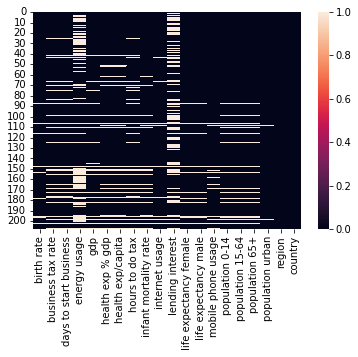

In [ ]:
#visualising the missing values
sns.heatmap(data.isnull())

Except region & country there are missing values in all other columns

In [ ]:
#viewing the count of missing values in each column
data.isnull().sum()

birth rate                 9
business tax rate         27
days to start business    27
energy usage              72
gdp                       20
health exp % gdp          23
health exp/capita         23
hours to do tax           28
infant mortality rate     20
internet usage             9
lending interest          77
life expectancy female    11
life expectancy male      11
mobile phone usage        12
population 0-14           17
population 15-64          17
population 65+            17
population urban           2
region                     0
country                    0
dtype: int64

Let us see the % of missing values in all columns

In [ ]:
100*(data.isnull().sum()/data.shape[0])

birth rate                4.3
business tax rate        13.0
days to start business   13.0
energy usage             34.6
gdp                       9.6
health exp % gdp         11.1
health exp/capita        11.1
hours to do tax          13.5
infant mortality rate     9.6
internet usage            4.3
lending interest         37.0
life expectancy female    5.3
life expectancy male      5.3
mobile phone usage        5.8
population 0-14           8.2
population 15-64          8.2
population 65+            8.2
population urban          1.0
region                    0.0
country                   0.0
dtype: float64

From above we can see energy usage and lending interest have huge missing data. So let us drop those columns

**Droping the missing values**

In [ ]:
df=data.drop(['energy usage','lending interest','hours to do tax'],axis=1)
df.head(3)

,birth rate,business tax rate,days to start business,gdp,health exp % gdp,health exp/capita,infant mortality rate,internet usage,life expectancy female,life expectancy male,mobile phone usage,population 0-14,population 15-64,population 65+,population urban,region,country
0,0.0,72.0,25.0,199070864638.0,0.0,233.0,0.0,0.1,72.0,69.0,0.9,0.3,0.7,0.0,0.7,Africa,Algeria
1,0.0,52.1,66.0,104115863405.0,0.0,178.0,0.1,0.1,53.0,50.0,0.5,0.5,0.5,0.0,0.4,Africa,Angola
2,0.0,65.9,29.0,7294900431.0,0.0,34.0,0.1,0.0,60.0,58.0,0.8,0.4,0.5,0.0,0.4,Africa,Benin


In [ ]:
df.shape

(208, 17)

In [ ]:
#Checking for missing values now 
df.isnull().sum()

birth rate                 9
business tax rate         27
days to start business    27
gdp                       20
health exp % gdp          23
health exp/capita         23
infant mortality rate     20
internet usage             9
life expectancy female    11
life expectancy male      11
mobile phone usage        12
population 0-14           17
population 15-64          17
population 65+            17
population urban           2
region                     0
country                    0
dtype: int64

let us drop all the missing rows

In [ ]:
df=df.dropna()

In [ ]:
df.isnull().sum()

birth rate                0
business tax rate         0
days to start business    0
gdp                       0
health exp % gdp          0
health exp/capita         0
infant mortality rate     0
internet usage            0
life expectancy female    0
life expectancy male      0
mobile phone usage        0
population 0-14           0
population 15-64          0
population 65+            0
population urban          0
region                    0
country                   0
dtype: int64

Now there are no missing values

In [ ]:
df.shape

(172, 17)

In [ ]:
# we can make single column of life expectancy
df['life expectancy'] = (df['life expectancy female']+df['life expectancy male'])/2
df.head(3)

,birth rate,business tax rate,days to start business,gdp,health exp % gdp,health exp/capita,infant mortality rate,internet usage,life expectancy female,life expectancy male,mobile phone usage,population 0-14,population 15-64,population 65+,population urban,region,country,life expectancy
0,0.0,72.0,25.0,199070864638.0,0.0,233.0,0.0,0.1,72.0,69.0,0.9,0.3,0.7,0.0,0.7,Africa,Algeria,70.5
1,0.0,52.1,66.0,104115863405.0,0.0,178.0,0.1,0.1,53.0,50.0,0.5,0.5,0.5,0.0,0.4,Africa,Angola,51.5
2,0.0,65.9,29.0,7294900431.0,0.0,34.0,0.1,0.0,60.0,58.0,0.8,0.4,0.5,0.0,0.4,Africa,Benin,59.0


In [ ]:
#lly we can make new column total population, instead of 3 age ranges
df['tot. population'] = df['population 0-14']+df['population 15-64']+df['population 65+']
df.head()

,birth rate,business tax rate,days to start business,gdp,health exp % gdp,health exp/capita,infant mortality rate,internet usage,life expectancy female,life expectancy male,mobile phone usage,population 0-14,population 15-64,population 65+,population urban,region,country,life expectancy,tot. population
0,0.0,72.0,25.0,199070864638.0,0.0,233.0,0.0,0.1,72.0,69.0,0.9,0.3,0.7,0.0,0.7,Africa,Algeria,70.5,1.0
1,0.0,52.1,66.0,104115863405.0,0.0,178.0,0.1,0.1,53.0,50.0,0.5,0.5,0.5,0.0,0.4,Africa,Angola,51.5,1.0
2,0.0,65.9,29.0,7294900431.0,0.0,34.0,0.1,0.0,60.0,58.0,0.8,0.4,0.5,0.0,0.4,Africa,Benin,59.0,1.0
3,0.0,19.5,60.0,15292424757.0,0.1,404.0,0.0,0.1,46.0,47.0,1.5,0.3,0.6,0.0,0.6,Africa,Botswana,46.5,1.0
4,0.0,43.5,13.0,10395757480.0,0.1,39.0,0.1,0.0,56.0,55.0,0.5,0.5,0.5,0.0,0.3,Africa,Burkina Faso,55.5,1.0


In [ ]:
#brief stats
df.describe()

,birth rate,business tax rate,days to start business,gdp,health exp % gdp,health exp/capita,infant mortality rate,internet usage,life expectancy female,life expectancy male,mobile phone usage,population 0-14,population 15-64,population 65+,population urban,life expectancy,tot. population
count,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0,172.0
mean,0.0,45.0,30.6,408419633959.6,0.1,1078.7,0.0,0.4,72.2,67.6,1.0,0.3,0.6,0.1,0.6,69.9,1.0
std,0.0,36.7,57.7,1456984401961.0,0.0,1869.5,0.0,0.3,10.1,8.9,0.4,0.1,0.1,0.1,0.2,9.4,0.0
min,0.0,8.4,1.0,172253739.0,0.0,12.0,0.0,0.0,45.0,45.0,0.0,0.1,0.5,0.0,0.1,45.0,1.0
25%,0.0,30.3,9.0,8158712050.2,0.0,85.0,0.0,0.1,65.0,61.8,0.7,0.2,0.6,0.0,0.4,63.4,1.0
50%,0.0,38.9,18.0,28942287843.5,0.1,310.5,0.0,0.3,76.0,69.5,1.0,0.3,0.7,0.1,0.5,72.8,1.0
75%,0.0,48.2,35.2,224580258561.0,0.1,929.8,0.0,0.6,79.2,74.0,1.2,0.4,0.7,0.1,0.7,76.5,1.0
max,0.1,339.1,694.0,15533800000000.0,0.2,9908.0,0.1,0.9,86.0,81.0,2.0,0.5,0.9,0.2,1.0,83.0,1.0


In our data there are 6 regions with 208 countries. Where the 53 countries are from region africa

converting gdp into billions - dividing with 10**9

In [ ]:
df['gdp in billions'] = df['gdp']/10**9

Now taking the required columns into new data frame

In [ ]:
df.columns

Index(['birth rate', 'business tax rate', 'days to start business', 'gdp',
       'health exp % gdp', 'health exp/capita', 'infant mortality rate',
       'internet usage', 'life expectancy female', 'life expectancy male',
       'mobile phone usage', 'population 0-14', 'population 15-64',
       'population 65+', 'population urban', 'region', 'country',
       'life expectancy', 'tot. population', 'gdp in billions'],
      dtype='object')

In [ ]:
df_new = df.drop(['gdp','life expectancy female','life expectancy male','population 0-14', 'population 15-64',
                 'population 65+','region'],axis=1)
df_new.head()

,birth rate,business tax rate,days to start business,health exp % gdp,health exp/capita,infant mortality rate,internet usage,mobile phone usage,population urban,country,life expectancy,tot. population,gdp in billions
0,0.0,72.0,25.0,0.0,233.0,0.0,0.1,0.9,0.7,Algeria,70.5,1.0,199.1
1,0.0,52.1,66.0,0.0,178.0,0.1,0.1,0.5,0.4,Angola,51.5,1.0,104.1
2,0.0,65.9,29.0,0.0,34.0,0.1,0.0,0.8,0.4,Benin,59.0,1.0,7.3
3,0.0,19.5,60.0,0.1,404.0,0.0,0.1,1.5,0.6,Botswana,46.5,1.0,15.3
4,0.0,43.5,13.0,0.1,39.0,0.1,0.0,0.5,0.3,Burkina Faso,55.5,1.0,10.4


we can drop region from our data. Since we need to cluster based on country. Region is not required

In [ ]:
df_new.skew()
#Now let us solve the skewness#

birth rate                0.6
business tax rate         5.3
days to start business    9.2
health exp % gdp          0.9
health exp/capita         2.6
infant mortality rate     1.1
internet usage            0.4
mobile phone usage       -0.0
population urban         -0.0
life expectancy          -0.8
tot. population          -0.1
gdp in billions           7.7
dtype: float64

let us find and remove outliers

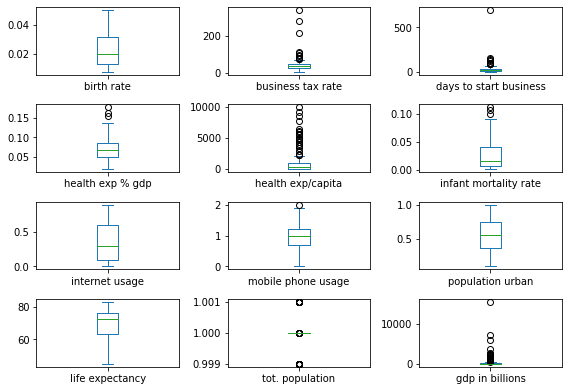

In [ ]:
df_new.plot(kind='box',subplots=True,layout=(6,3),figsize=(8,8))
plt.tight_layout()

we can see there are outliers in many columns. Let us try removing these outliers

In [ ]:
df_new.shape

(172, 13)

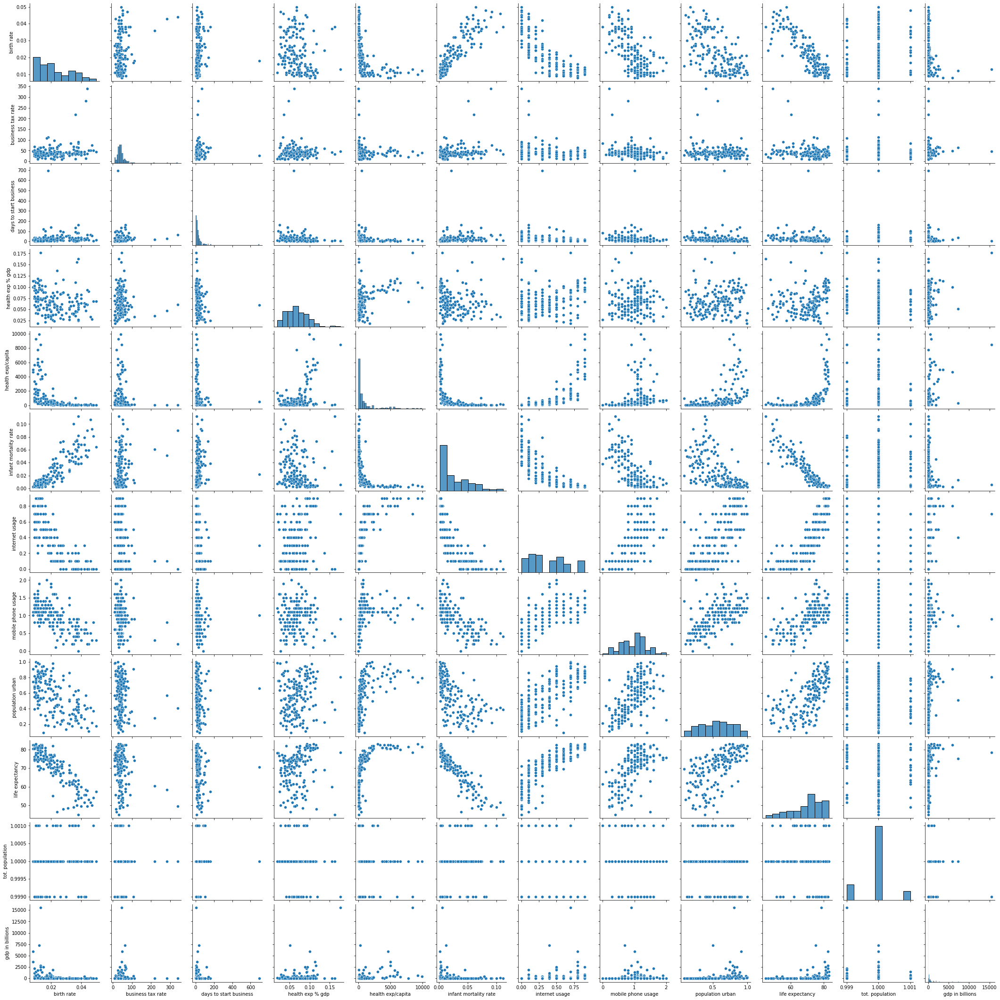

In [ ]:
sns.pairplot(df_new.drop('country',axis=1))

from above we can see the relation between columns

In [ ]:
#Checking the correlation
country_cor = df_new.drop('country',axis=1).corr()
country_cor

,birth rate,business tax rate,days to start business,health exp % gdp,health exp/capita,infant mortality rate,internet usage,mobile phone usage,population urban,life expectancy,tot. population,gdp in billions
birth rate,1.0,0.3,0.1,-0.2,-0.5,0.9,-0.8,-0.7,-0.6,-0.9,0.2,-0.2
business tax rate,0.3,1.0,0.0,-0.1,-0.1,0.3,-0.2,-0.2,-0.1,-0.2,0.0,0.0
days to start business,0.1,0.0,1.0,-0.1,-0.1,0.1,-0.2,-0.1,-0.0,-0.1,0.1,-0.0
health exp % gdp,-0.2,-0.1,-0.1,1.0,0.5,-0.1,0.3,-0.0,0.2,0.2,-0.1,0.3
health exp/capita,-0.5,-0.1,-0.1,0.5,1.0,-0.5,0.7,0.3,0.5,0.5,-0.1,0.4
infant mortality rate,0.9,0.3,0.1,-0.1,-0.5,1.0,-0.8,-0.7,-0.6,-0.9,0.1,-0.2
internet usage,-0.8,-0.2,-0.2,0.3,0.7,-0.8,1.0,0.6,0.7,0.8,-0.1,0.3
mobile phone usage,-0.7,-0.2,-0.1,-0.0,0.3,-0.7,0.6,1.0,0.6,0.6,-0.1,0.0
population urban,-0.6,-0.1,-0.0,0.2,0.5,-0.6,0.7,0.6,1.0,0.6,-0.1,0.2
life expectancy,-0.9,-0.2,-0.1,0.2,0.5,-0.9,0.8,0.6,0.6,1.0,-0.1,0.2


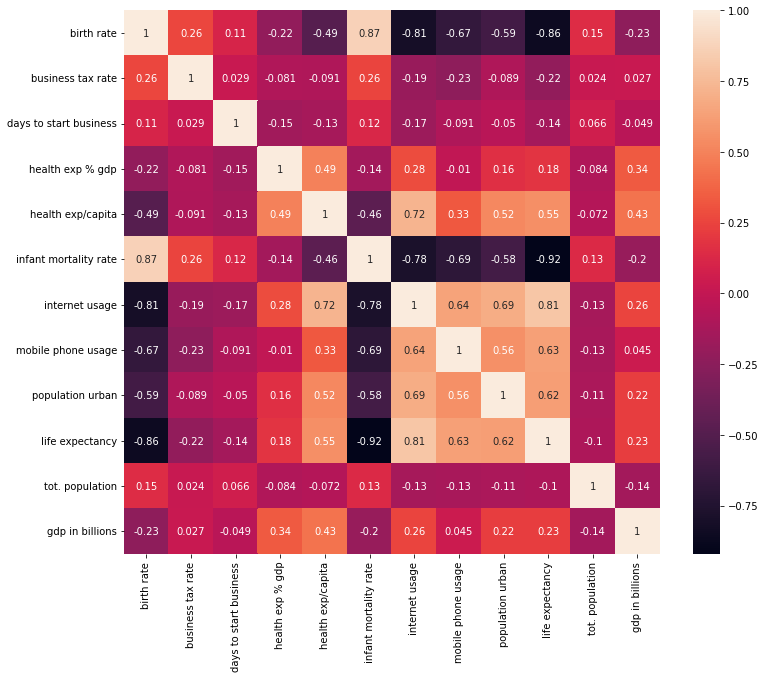

In [ ]:
#Viewing the correlation graphically
plt.figure(figsize=(12,10))
sns.heatmap(country_cor,annot=True)

<Figure size 1296x720 with 0 Axes>

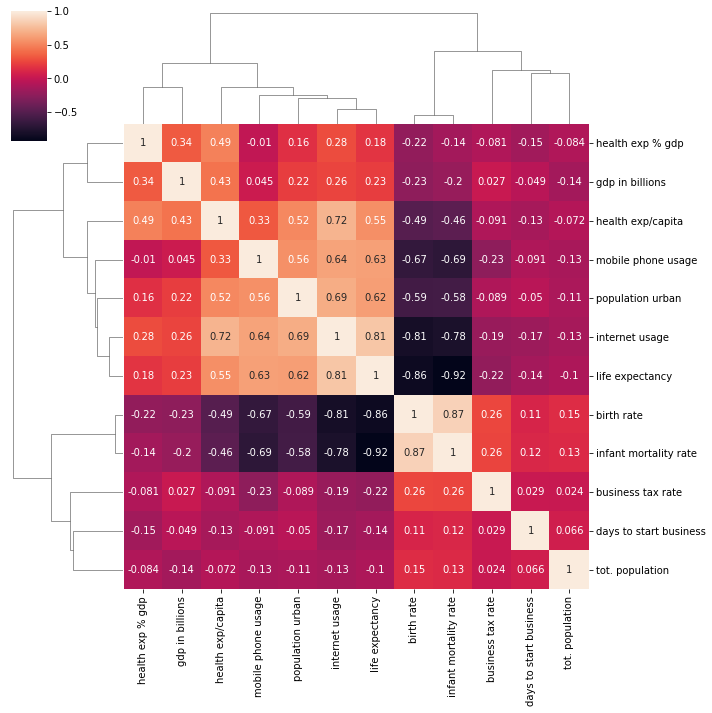

In [ ]:
plt.figure(figsize=(18,10))
sns.clustermap(country_cor, annot=True)

Scaling the data

In [ ]:
# scale the data
from sklearn.preprocessing import MinMaxScaler
min_max_scaler = MinMaxScaler()
country_scale = min_max_scaler.fit_transform(df_new.drop('country',axis=1))
country_scale_df = pd.DataFrame(data = country_scale,
                               columns=df_new.drop('country',axis=1).columns)
country_scale_df['country'] = df_new['country']
country_scale_df.head()

,birth rate,business tax rate,days to start business,health exp % gdp,health exp/capita,infant mortality rate,internet usage,mobile phone usage,population urban,life expectancy,tot. population,gdp in billions,country
0,0.4,0.2,0.0,0.2,0.0,0.2,0.1,0.5,0.7,0.7,0.5,0.0,Algeria
1,0.9,0.1,0.1,0.1,0.0,1.0,0.1,0.2,0.4,0.2,0.5,0.0,Angola
2,0.7,0.2,0.0,0.2,0.0,0.5,0.0,0.4,0.4,0.4,0.5,0.0,Benin
3,0.4,0.0,0.1,0.2,0.0,0.3,0.1,0.8,0.5,0.0,0.5,0.0,Botswana
4,0.8,0.1,0.0,0.3,0.0,0.6,0.0,0.2,0.2,0.3,0.5,0.0,Burkina Faso


**PCA**

In [ ]:
from sklearn.decomposition import PCA

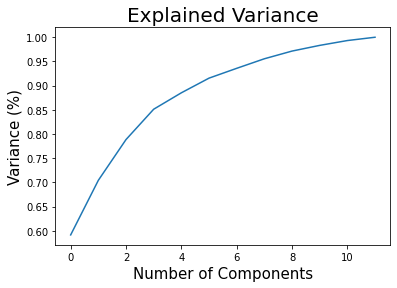

In [ ]:
# pass through the scaled data set into our PCA class object
pca = PCA().fit(country_scale)

# plot the Cumulative Summation of the Explained Variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))

# define the labels & title
plt.xlabel('Number of Components', fontsize = 15)
plt.ylabel('Variance (%)', fontsize = 15) 
plt.title('Explained Variance', fontsize = 20)

# show the plot
sns.set()
plt.show()

We then use 8 as n_component parameter and save the PCA dataset into a new object called country_pca, this dataset will be used to preform the final clustering.

In [ ]:
len(country_scale)

172

In [ ]:
# we will choose 5 pca components and create a new dataset

country_pca = PCA(n_components=8).fit(country_scale).transform(country_scale)

# store it in a new data frame
country_pca= pd.DataFrame(data = country_pca, columns = ['principal component 1', 'principal component 2','principal component 3','principal component 4',
                                                        'principal component 5','principal component 6','principal component 7','principal component 8',])


country_pca.head()

,principal component 1,principal component 2,principal component 3,principal component 4,principal component 5,principal component 6,principal component 7,principal component 8
0,0.2,0.0,-0.2,0.2,-0.2,-0.1,0.1,-0.0
1,1.0,-0.0,0.2,0.3,0.3,-0.0,-0.1,-0.0
2,0.7,-0.0,-0.0,0.2,0.0,0.0,0.1,-0.0
3,0.4,-0.0,-0.1,0.3,0.1,0.4,-0.1,0.1
4,0.9,-0.0,0.1,0.0,0.1,0.0,0.0,-0.1


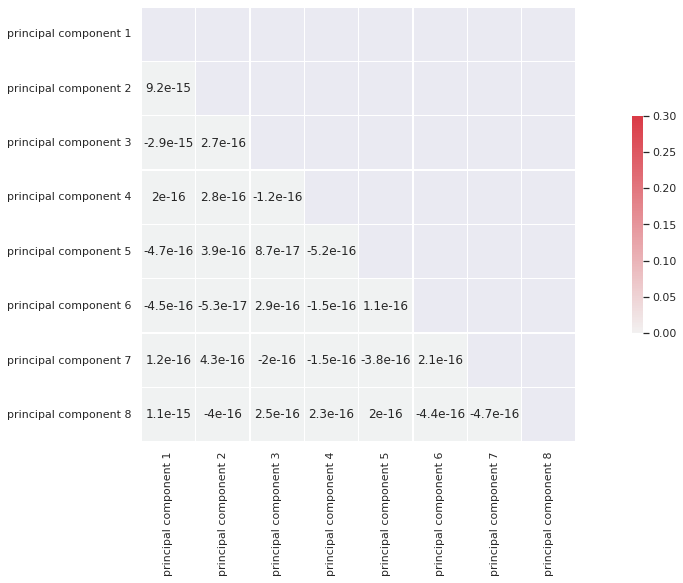

In [ ]:
country_pca_cor = country_pca.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(country_pca_cor, dtype=np.bool))

# Set up the matplotlib figure
fig, ax = plt.subplots(figsize=(20, 8))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(country_pca_cor, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5},annot = True)

**Hopkins Statistics:**
The Hopkins statistic, is a statistic which gives a value which indicates the cluster tendency, in other words: how well the data can be clustered.

If the value is between {0.01, ...,0.3}, the data is regularly spaced.

If the value is around 0.5, it is random.

If the value is between {0.7, ..., 0.99}, it has a high tendency to cluster.

In [ ]:
from sklearn.neighbors import NearestNeighbors
from random import sample
from numpy.random import uniform
import numpy as np
from math import isnan
 
def hopkins(X):
    d = X.shape[1]
    #d = len(vars) # columns
    n = len(X) # rows
    m = int(0.1 * n) 
    nbrs = NearestNeighbors(n_neighbors=1).fit(X.values)
 
    rand_X = sample(range(0, n, 1), m)
 
    ujd = []
    wjd = []
    for j in range(0, m):
        u_dist, _ = nbrs.kneighbors(uniform(np.amin(X,axis=0),np.amax(X,axis=0),d).reshape(1, -1), 2, return_distance=True)
        ujd.append(u_dist[0][1])
        w_dist, _ = nbrs.kneighbors(X.iloc[rand_X[j]].values.reshape(1, -1), 2, return_distance=True)
        wjd.append(w_dist[0][1])
 
    H = sum(ujd) / (sum(ujd) + sum(wjd))
    if isnan(H):
        print(ujd, wjd)
        H = 0
 
    return H

In [ ]:
country_scale_df.columns

Index(['birth rate', 'business tax rate', 'days to start business',
       'health exp % gdp', 'health exp/capita', 'infant mortality rate',
       'internet usage', 'mobile phone usage', 'population urban',
       'life expectancy', 'tot. population', 'gdp in billions', 'country'],
      dtype='object')

In [ ]:
#First convert the numpy array to a dataframe
scaled_df= pd.DataFrame(country_scale_df.drop('country',axis=1))
scaled_df.columns = country_scale_df.drop('country',axis=1).columns

In [ ]:
hopkins(scaled_df)

0.8261988135505314

In [ ]:
hopkins(scaled_df)

0.8140382448625678

In [ ]:
hopkins(scaled_df)

0.8087219727682081

From the three runs of hopkins we can see the values are above 0.80. Therefore the data we have can be highly clustered

**TASK2.1** **CLUSTERING**

KMEANS **CLUSTERING**

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# define a dictionary that contains all of our relevant info.
results = []

# define how many clusters we want to test up to.
num_of_clusters = 10

# run through each instance of K
for k in range(2, num_of_clusters):
    
    print("-"*100)
    
    # create an instance of the model, and fit the training data to it.
    kmeans = KMeans(n_clusters=k, random_state=0).fit(country_pca)
    
    
    # store the different metrics
#     results_dict_pca[k]['silhouette_score'] = sil_score
#     results_dict_pca[k]['inertia'] = kmeans.inertia_
#     results_dict_pca[k]['score'] = kmeans.score
#     results_dict_pca[k]['model'] = kmeans
    
    results.append(kmeans.inertia_)
    
    # print the results    
    print("Number of Clusters: {}".format(k),kmeans.inertia_)
    

----------------------------------------------------------------------------------------------------
Number of Clusters: 2 47.156790653491285
----------------------------------------------------------------------------------------------------
Number of Clusters: 3 37.102127613336975
----------------------------------------------------------------------------------------------------
Number of Clusters: 4 32.53340038363634
----------------------------------------------------------------------------------------------------
Number of Clusters: 5 28.43646938674921
----------------------------------------------------------------------------------------------------
Number of Clusters: 6 26.166847820722182
----------------------------------------------------------------------------------------------------
Number of Clusters: 7 24.64052125539161
----------------------------------------------------------------------------------------------------
Number of Clusters: 8 23.2387038618078
-----------

Then we plot the Elbow Method for optimal k

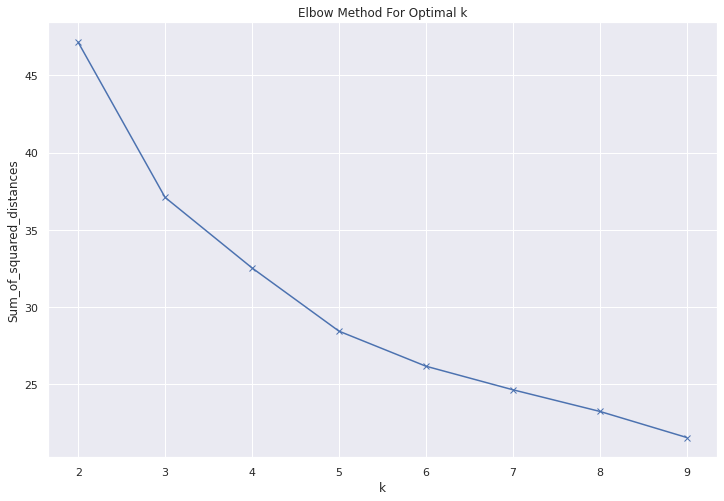

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(range(2, num_of_clusters), results, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

From graph we can see 3 is the optimum for k to make number of cluster

In [ ]:
from sklearn.metrics import silhouette_score, silhouette_samples

In [ ]:
from sklearn.metrics import silhouette_score

In [ ]:
!pip install validclust

In [ ]:
from validclust import dunn

In [ ]:
range_n_clusters=[2,3,4,5,6,7,8]
for n_clusters in range_n_clusters:
    
    #initialising cluters
    kmean = KMeans(n_clusters=n_clusters,max_iter=100)
    kmean.fit(country_pca)
    
    cluster_labels = kmean.labels_
    
    #silhouette score
    silhouette_avg=silhouette_score(country_pca, cluster_labels)
    
    #dunn metric
    dist = pairwise_distances(country_pca)
    dun = dunn(dist,  cluster_labels)
    
    #printing the metrics
    print(f'for n_clusters {n_clusters}:')
    print('CH Data: '+ str(metrics.calinski_harabasz_score(country_pca, cluster_labels)))
    print('DI Data: '+ str(dun))
    print(f'the silhouette score is: {silhouette_avg}') 
    print('**'*20)
    print(' ')

for n_clusters 2:
CH Data: 146.977748393492
DI Data: 0.09038547650044393
the silhouette score is: 0.3810855485211602
****************************************
 
for n_clusters 3:
CH Data: 115.75436418608857
DI Data: 0.09953567457561756
the silhouette score is: 0.28033515874690856
****************************************
 
for n_clusters 4:
CH Data: 95.59166711951917
DI Data: 0.10225636759820009
the silhouette score is: 0.2575121687420414
****************************************
 
for n_clusters 5:
CH Data: 87.34365615715292
DI Data: 0.14225690669379118
the silhouette score is: 0.2587973372593646
****************************************
 
for n_clusters 6:
CH Data: 77.99647750011228
DI Data: 0.12824531215118137
the silhouette score is: 0.22597614805075628
****************************************
 
for n_clusters 7:
CH Data: 72.08371854883727
DI Data: 0.1309819864025097
the silhouette score is: 0.2376439760221737
****************************************
 
for n_clusters 8:
CH Data: 65.701

----------------------------------------------------------------------------------------------------


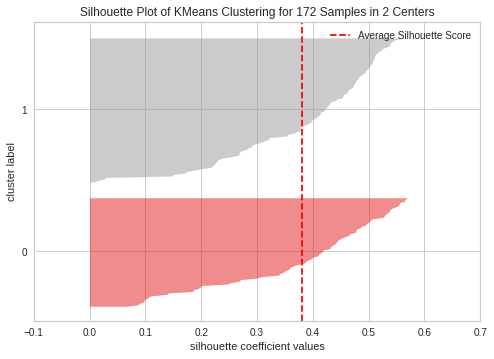

----------------------------------------------------------------------------------------------------


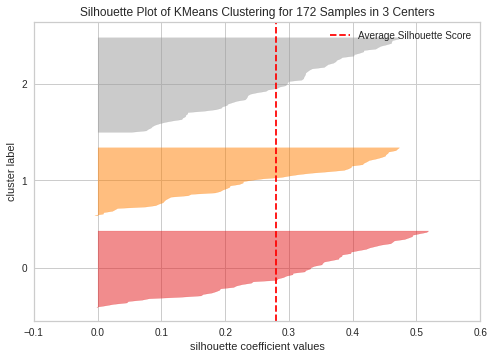

----------------------------------------------------------------------------------------------------


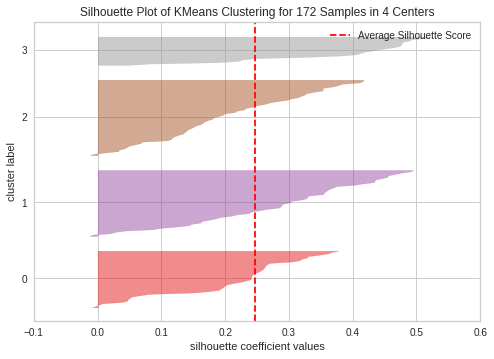

----------------------------------------------------------------------------------------------------


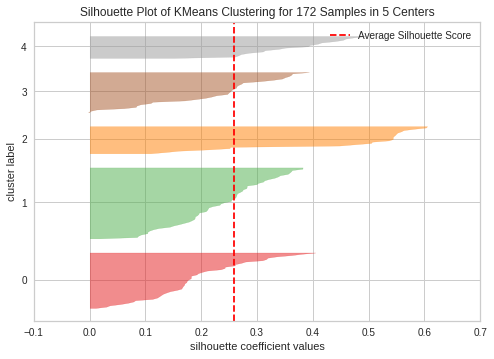

In [ ]:
# From the graph above, it indicates that we should choose k = 3

from yellowbrick.cluster import SilhouetteVisualizer

clusters = [2,3,4,5]

for cluster in clusters:
    
    print('-'*100)

    # define the model for K
    kmeans = KMeans(n_clusters = cluster, random_state=0)

    # pass the model through the visualizer
    visualizer = SilhouetteVisualizer(kmeans)

    # fit the data
    visualizer.fit(country_pca)

    # show the chart
    visualizer.poof()

    
# the silhouette plot also shows that the optimal k is 3

Clustering into 3

In [ ]:
kmeans = KMeans(n_clusters=3, random_state=0).fit(country_pca)
df_new['cluster'] = kmeans.labels_
df_new.head()

,birth rate,business tax rate,days to start business,health exp % gdp,health exp/capita,infant mortality rate,internet usage,mobile phone usage,population urban,country,life expectancy,tot. population,gdp in billions,cluster
0,0.0,72.0,25.0,0.0,233.0,0.0,0.1,0.9,0.7,Algeria,70.5,1.0,199.1,2
1,0.0,52.1,66.0,0.0,178.0,0.1,0.1,0.5,0.4,Angola,51.5,1.0,104.1,0
2,0.0,65.9,29.0,0.0,34.0,0.1,0.0,0.8,0.4,Benin,59.0,1.0,7.3,0
3,0.0,19.5,60.0,0.1,404.0,0.0,0.1,1.5,0.6,Botswana,46.5,1.0,15.3,0
4,0.0,43.5,13.0,0.1,39.0,0.1,0.0,0.5,0.3,Burkina Faso,55.5,1.0,10.4,0


Clustered the cities into 3 categories using K-Means

**HIERARCHICAL CLUSTERING**

In [ ]:
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

In [ ]:
country_pca.head()

,principal component 1,principal component 2,principal component 3,principal component 4,principal component 5,principal component 6,principal component 7,principal component 8
0,0.2,0.0,-0.2,0.2,-0.2,-0.1,0.1,-0.0
1,1.0,-0.0,0.2,0.3,0.3,-0.0,-0.1,-0.0
2,0.7,-0.0,-0.0,0.2,0.0,0.0,0.1,-0.0
3,0.4,-0.0,-0.1,0.3,0.1,0.4,-0.1,0.1
4,0.9,-0.0,0.1,0.0,0.1,0.0,0.0,-0.1


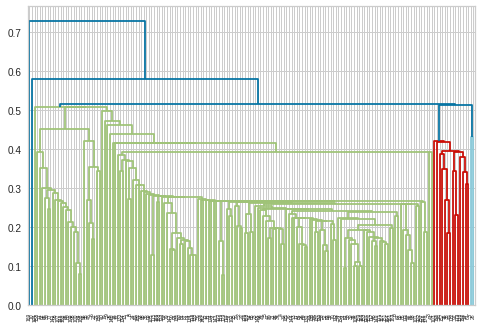

In [ ]:
#Single linkage
mergings = linkage(country_pca,method='single',metric='euclidean')
dendrogram(mergings)
plt.show()

From the above single linkage,No proper output , we cant use this to understand or perform number of clusters to be made

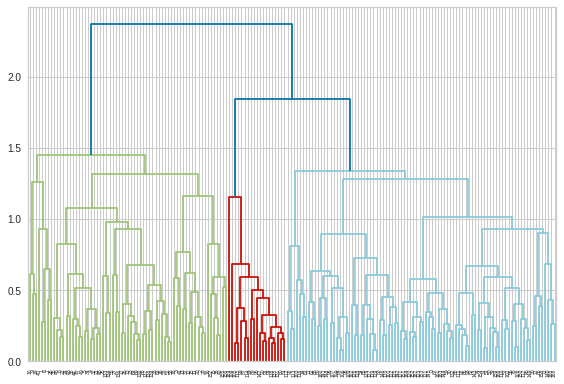

In [ ]:
#complete linkage
mergings = linkage(country_pca,method='complete',metric='euclidean')
dendrogram(mergings)
plt.tight_layout()
plt.show()

In [ ]:
range_n_clusters=[2,3,4,5,6]
for n_clusters in range_n_clusters:
    
    #initialising cluters
    cluster_labels = cut_tree(mergings,n_clusters=n_clusters)
    cluster_labels=cluster_labels.reshape(-1, )
    
    #silhouette score
    silhouette_avg=silhouette_score(country_pca, cluster_labels)
    
    #dunn metric
    dist = pairwise_distances(country_pca)
    dun = dunn(dist,  cluster_labels)
    
    #printing the metrics
    print(f'for n_clusters {n_clusters}:')
    print('CH Data: '+ str(metrics.calinski_harabasz_score(country_pca, cluster_labels)))
    print('DI Data: '+ str(dun))
    print(f'the silhouette score is: {silhouette_avg}') 
    print('**'*20)
    print(' ')

for n_clusters 2:
CH Data: 140.77065769079064
DI Data: 0.11728393749143036
the silhouette score is: 0.38025251908365854
****************************************
 
for n_clusters 3:
CH Data: 107.66180646406681
DI Data: 0.14857269849105662
the silhouette score is: 0.31276449045085664
****************************************
 
for n_clusters 4:
CH Data: 79.47719369315139
DI Data: 0.16131852685147122
the silhouette score is: 0.2520386659231381
****************************************
 
for n_clusters 5:
CH Data: 66.7319771755828
DI Data: 0.1644588324197219
the silhouette score is: 0.2367093659181714
****************************************
 
for n_clusters 6:
CH Data: 58.23433019276487
DI Data: 0.16857419523954656
the silhouette score is: 0.2097453680741168
****************************************
 


In [ ]:
#Cutting the tree into clusters
cluster_labels = cut_tree(mergings,n_clusters=3)
cluster_labels.shape

(172, 1)

In [ ]:
cluster_labels=cluster_labels.reshape(-1, )

In [ ]:
df_new['cluster_label'] = cluster_labels
df_new.head()

,birth rate,business tax rate,days to start business,health exp % gdp,health exp/capita,infant mortality rate,internet usage,mobile phone usage,population urban,country,life expectancy,tot. population,gdp in billions,cluster,cluster_label
0,0.0,72.0,25.0,0.0,233.0,0.0,0.1,0.9,0.7,Algeria,70.5,1.0,199.1,2,0
1,0.0,52.1,66.0,0.0,178.0,0.1,0.1,0.5,0.4,Angola,51.5,1.0,104.1,0,1
2,0.0,65.9,29.0,0.0,34.0,0.1,0.0,0.8,0.4,Benin,59.0,1.0,7.3,0,1
3,0.0,19.5,60.0,0.1,404.0,0.0,0.1,1.5,0.6,Botswana,46.5,1.0,15.3,0,1
4,0.0,43.5,13.0,0.1,39.0,0.1,0.0,0.5,0.3,Burkina Faso,55.5,1.0,10.4,0,1


From above columns:

cluster - assigned based on k-means technique
cluster_label - assigned based on Hierarchial technique

TASK 2.2:INTERNAL VALIDATION METRICS

(https://drive.google.com/file/d/1s5rU9Vk1j7KDI0vnNLAYtVL2g92LmYbE/view?usp=sharing)

In this link we can view the math equations of validation techniques

In [ ]:
kmean = KMeans(n_clusters=3,max_iter=100)
kmean.fit(country_pca)
    
cluster_labels = kmean.labels_
    
#silhouette score
silhouette_avg=silhouette_score(country_pca, cluster_labels)
    
#dunn metric
dist = pairwise_distances(country_pca)
dun = dunn(dist,  cluster_labels)
    
#printing the metrics
print('Metrics of K-Means clustering technique')
print('CH Data: '+ str(metrics.calinski_harabasz_score(country_pca, cluster_labels)))
print('DI Data: '+ str(dun))
print(f'The silhouette score is: {silhouette_avg}') 

Metrics of K-Means clustering technique
CH Data: 115.75436418608857
DI Data: 0.09953567457561756
The silhouette score is: 0.28033515874690856


In [ ]:
cluster_labels = cut_tree(mergings,n_clusters=n_clusters)
cluster_labels=cluster_labels.reshape(-1, )
    
    
#silhouette score
silhouette_avg=silhouette_score(country_pca, cluster_labels)
    
#dunn metric
dist = pairwise_distances(country_pca)
dun = dunn(dist,  cluster_labels)
    
#printing the metrics
print('Metrics of Heirarchial clustering technique')
print('CH Data: '+ str(metrics.calinski_harabasz_score(country_pca, cluster_labels)))
print('DI Data: '+ str(dun))
print(f'The silhouette score is: {silhouette_avg}') 

**TASK 2.3**

Print out the country in each cluster

**clustered countries as per K-Means**

In [ ]:
c0=df_new[df_new['cluster'] == 0]
c0

,birth rate,business tax rate,days to start business,health exp % gdp,health exp/capita,infant mortality rate,internet usage,mobile phone usage,population urban,country,life expectancy,tot. population,gdp in billions,cluster,cluster_label
1,0.0,52.1,66.0,0.0,178.0,0.1,0.1,0.5,0.4,Angola,51.5,1.0,104.1,0,1
2,0.0,65.9,29.0,0.0,34.0,0.1,0.0,0.8,0.4,Benin,59.0,1.0,7.3,0,1
3,0.0,19.5,60.0,0.1,404.0,0.0,0.1,1.5,0.6,Botswana,46.5,1.0,15.3,0,1
4,0.0,43.5,13.0,0.1,39.0,0.1,0.0,0.5,0.3,Burkina Faso,55.5,1.0,10.4,0,1
5,0.0,51.6,13.0,0.1,21.0,0.1,0.0,0.2,0.1,Burundi,53.0,1.0,2.4,0,1
6,0.0,48.8,15.0,0.1,64.0,0.1,0.1,0.5,0.5,Cameroon,54.0,1.0,25.5,0,1
7,0.0,54.6,22.0,0.0,19.0,0.1,0.0,0.2,0.4,Central African Republic,49.0,1.0,2.2,0,1
8,0.0,75.8,55.0,0.0,25.0,0.1,0.0,0.3,0.2,Chad,50.0,1.0,12.2,0,1
9,0.0,217.9,22.0,0.0,31.0,0.1,0.1,0.3,0.3,Comoros,60.5,1.0,0.6,0,1
10,0.0,339.1,65.0,0.1,15.0,0.1,0.0,0.2,0.4,"Congo, Dem. Rep.",49.5,1.0,23.8,0,1


In [ ]:
c0.shape

(55, 15)

We can see,there are 55 countries under cluster 0

In [ ]:
#viewing all the countries in cluster 0
print(c0['country'])

1                        Angola
2                         Benin
3                      Botswana
4                  Burkina Faso
5                       Burundi
6                      Cameroon
7      Central African Republic
8                          Chad
9                       Comoros
10             Congo, Dem. Rep.
11                  Congo, Rep.
12                Cote d'Ivoire
13                     Djibouti
15            Equatorial Guinea
16                      Eritrea
17                     Ethiopia
19                  Gambia, The
20                        Ghana
21                       Guinea
22                Guinea-Bissau
23                        Kenya
24                      Lesotho
25                      Liberia
27                   Madagascar
28                       Malawi
29                         Mali
30                   Mauritania
33                   Mozambique
34                      Namibia
35                        Niger
36                      Nigeria
37      

In [ ]:
c1=df_new[df_new['cluster'] == 1]
c1

,birth rate,business tax rate,days to start business,health exp % gdp,health exp/capita,infant mortality rate,internet usage,mobile phone usage,population urban,country,life expectancy,tot. population,gdp in billions,cluster,cluster_label
65,0.0,48.4,22.0,0.1,4641.0,0.0,0.8,1.0,0.9,Japan,82.5,1.0,5905.6,1,2
68,0.0,28.7,6.0,0.1,1652.0,0.0,0.8,1.1,0.8,"Korea, Rep.",81.0,1.0,1202.5,1,0
79,0.0,27.1,3.0,0.0,2144.0,0.0,0.7,1.5,1.0,Singapore,82.0,1.0,274.1,1,0
89,0.0,52.3,25.0,0.1,5643.0,0.0,0.8,1.5,0.7,Austria,81.0,1.0,416.0,1,2
91,0.0,57.0,4.0,0.1,4914.0,0.0,0.8,1.1,1.0,Belgium,80.5,1.0,513.3,1,2
94,0.0,21.9,8.0,0.1,992.0,0.0,0.6,1.2,0.6,Croatia,77.0,1.0,61.5,1,0
95,0.0,22.0,8.0,0.1,2123.0,0.0,0.6,1.0,0.7,Cyprus,79.5,1.0,24.9,1,0
96,0.0,48.1,20.0,0.1,1545.0,0.0,0.7,1.2,0.7,Czech Republic,78.0,1.0,216.1,1,0
97,0.0,26.4,6.0,0.1,6521.0,0.0,0.9,1.3,0.9,Denmark,80.0,1.0,333.7,1,2
98,0.0,57.6,7.0,0.1,928.0,0.0,0.8,1.4,0.7,Estonia,76.0,1.0,22.5,1,0


In [ ]:
c1.shape

(49, 15)

There are 49 countries in cluster 1

In [ ]:
c1['country']

65                    Japan
68              Korea, Rep.
79                Singapore
89                  Austria
91                  Belgium
94                  Croatia
95                   Cyprus
96           Czech Republic
97                  Denmark
98                  Estonia
100                 Finland
101                  France
102                 Germany
103                  Greece
104                 Hungary
105                 Iceland
106                 Ireland
108                   Italy
110                  Latvia
112               Lithuania
113              Luxembourg
114          Macedonia, FYR
115                   Malta
119             Netherlands
120                  Norway
121                  Poland
122                Portugal
124      Russian Federation
127         Slovak Republic
128                Slovenia
129                   Spain
130                  Sweden
131             Switzerland
134          United Kingdom
135                 Bahrain
138                 

In [ ]:
c2=df_new[df_new['cluster'] == 2]
c2

,birth rate,business tax rate,days to start business,health exp % gdp,health exp/capita,infant mortality rate,internet usage,mobile phone usage,population urban,country,life expectancy,tot. population,gdp in billions,cluster,cluster_label
0,0.0,72.0,25.0,0.0,233.0,0.0,0.1,0.9,0.7,Algeria,70.5,1.0,199.1,2,0
14,0.0,43.6,8.0,0.0,137.0,0.0,0.4,1.1,0.4,"Egypt, Arab Rep.",70.5,1.0,236.0,2,0
18,0.0,43.5,57.0,0.0,401.0,0.0,0.1,1.5,0.9,Gabon,63.0,1.0,18.8,2,1
31,0.0,27.7,6.0,0.0,450.0,0.0,0.4,1.0,0.4,Mauritius,73.5,1.0,11.3,2,0
32,0.0,49.6,12.0,0.1,195.0,0.0,0.5,1.1,0.6,Morocco,70.5,1.0,99.2,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198,0.0,34.4,15.0,0.1,513.0,0.0,0.5,1.2,0.2,St. Lucia,74.5,1.0,1.3,2,0
200,0.0,38.7,10.0,0.0,310.0,0.0,0.4,1.2,0.5,St. Vincent and the Grenadines,72.0,1.0,0.7,2,0
201,0.0,27.9,694.0,0.1,490.0,0.0,0.3,1.0,0.7,Suriname,70.5,1.0,4.4,2,0
202,0.0,29.1,41.0,0.1,935.0,0.0,0.6,1.4,0.1,Trinidad and Tobago,69.5,1.0,23.7,2,0


In [ ]:
c2.shape

(68, 15)

There are 68 countries in cluster 2

Total number of countries in each cluster are 172

**Countries clustered as per hierarchial model:**

In [ ]:
ch0 = df_new[df_new['cluster_label']==0]
ch0['country']

0                             Algeria
14                   Egypt, Arab Rep.
31                          Mauritius
32                            Morocco
40                         Seychelles
                    ...              
200    St. Vincent and the Grenadines
201                          Suriname
202               Trinidad and Tobago
205                           Uruguay
206                     Venezuela, RB
Name: country, Length: 88, dtype: object

In [ ]:
ch0['country'].shape

(88,)

there are 88 countries in cluster 0

In [ ]:
ch1 = df_new[df_new['cluster_label']==1]
ch1['country']

1            Angola
2             Benin
3          Botswana
4      Burkina Faso
5           Burundi
           ...     
161           Tonga
162         Vanuatu
185       Guatemala
186          Guyana
187           Haiti
Name: country, Length: 65, dtype: object

In [ ]:
ch1['country'].shape

(65,)

there are 65 countries in cluster 1

In [ ]:
ch2 = df_new[df_new['cluster_label']==2]
ch2['country']

65              Japan
89            Austria
91            Belgium
97            Denmark
100           Finland
101            France
102           Germany
105           Iceland
106           Ireland
113        Luxembourg
119       Netherlands
120            Norway
130            Sweden
131       Switzerland
134    United Kingdom
149         Australia
157       New Zealand
172            Canada
204     United States
Name: country, dtype: object

In [ ]:
ch2['country'].shape

(19,)

there are 19 countries in cluster 3

Num of countries present in 3 clusters is 172

**Making a dataframe to compare number of countries in each cluster**

(0.0, 8000.0)

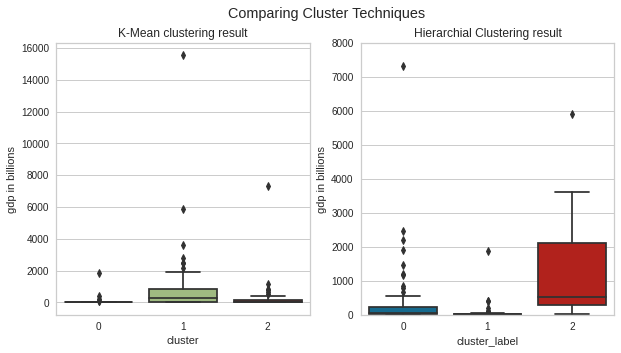

In [ ]:
figure, axes = plt.subplots(1, 2, sharex=True,
                            figsize=(10, 5))
figure.suptitle('Comparing Cluster Techniques')
axes[0].set_title('K-Mean clustering result')
sns.boxplot(x='cluster',y='gdp in billions',data=df_new,ax=axes[0])
plt.ylim(0,8000)

axes[1].set_title('Hierarchial Clustering result')
sns.boxplot(x='cluster_label',y='gdp in billions',data=df_new,ax=axes[1])
plt.ylim(0,8000)

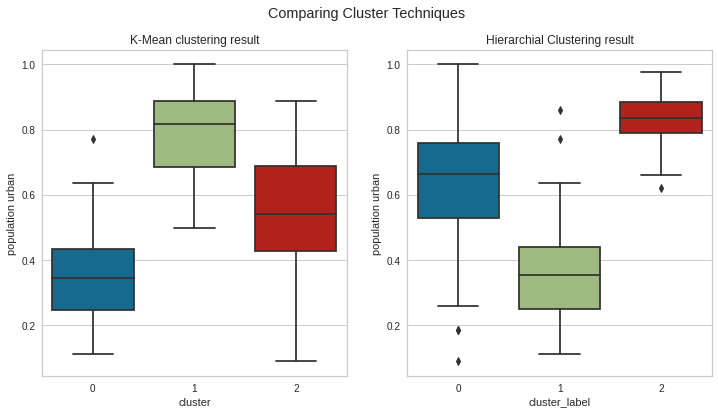

In [ ]:
figure, axes = plt.subplots(1, 2, sharex=True,
                            figsize=(12, 6))
figure.suptitle('Comparing Cluster Techniques')
axes[0].set_title('K-Mean clustering result')
sns.boxplot(x='cluster',y='population urban',data=df_new,ax=axes[0])

axes[1].set_title('Hierarchial Clustering result')
sns.boxplot(x='cluster_label',y='population urban',data=df_new,ax=axes[1])

In [ ]:
df_new.columns

Index(['birth rate', 'business tax rate', 'days to start business',
       'health exp % gdp', 'health exp/capita', 'infant mortality rate',
       'internet usage', 'mobile phone usage', 'population urban', 'country',
       'life expectancy', 'tot. population', 'gdp in billions', 'cluster',
       'cluster_label'],
      dtype='object')

In [ ]:
result_df=pd.DataFrame()
result_df['country']= df_new['country']
result_df['k-mean label']=df_new['cluster']
result_df['Hierarchial label']=df_new['cluster_label']
result_df['gdp'] = df_new['gdp in billions']
result_df

,country,k-mean label,Hierarchial label,gdp
0,Algeria,2,0,199.1
1,Angola,0,1,104.1
2,Benin,0,1,7.3
3,Botswana,0,1,15.3
4,Burkina Faso,0,1,10.4
...,...,...,...,...
201,Suriname,2,0,4.4
202,Trinidad and Tobago,2,0,23.7
204,United States,1,2,15533.8
205,Uruguay,1,0,47.2


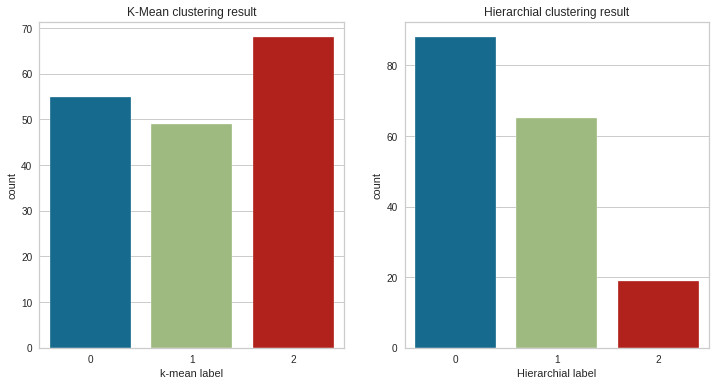

In [ ]:
figure, axes = plt.subplots(1, 2, sharex=True,figsize=(12, 6))

axes[0].set_title('K-Mean clustering result')
sns.countplot(result_df['k-mean label'],ax=axes[0])

axes[1].set_title('Hierarchial clustering result')
sns.countplot(result_df['Hierarchial label'],ax=axes[1])

Comparing kmeans and hierarchical clustering ,kmeans will be best clustering solution AS hierarchical has memory constraint suppose if the data is complex it cant handle it , though it has advantage of not to decide on k value for clusters

**TASK2.4 : PLOTS**

**Plots as K-Mean clustering**

(0.0, 8000.0)

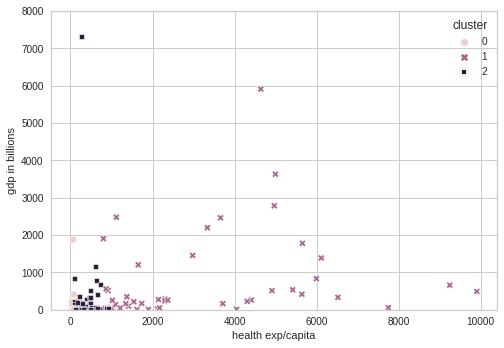

In [ ]:
sns.scatterplot(data=df_new, x="health exp/capita", y="gdp in billions", hue="cluster",style="cluster")
plt.ylim(0,8000)

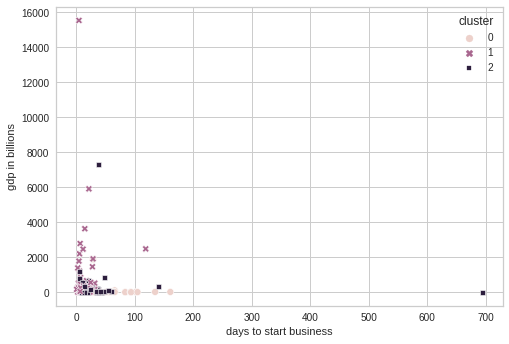

In [ ]:
sns.scatterplot(data=df_new, x="days to start business", y="gdp in billions", hue="cluster",style="cluster")

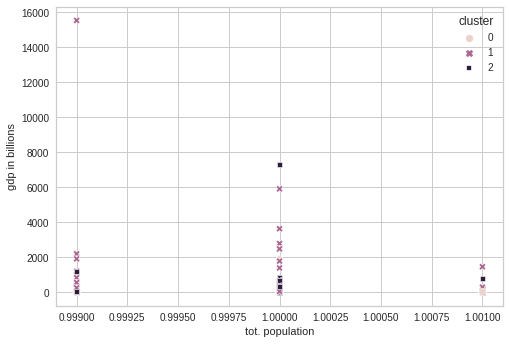

In [ ]:
sns.scatterplot(data=df_new, x="tot. population", y="gdp in billions", hue="cluster",style="cluster")

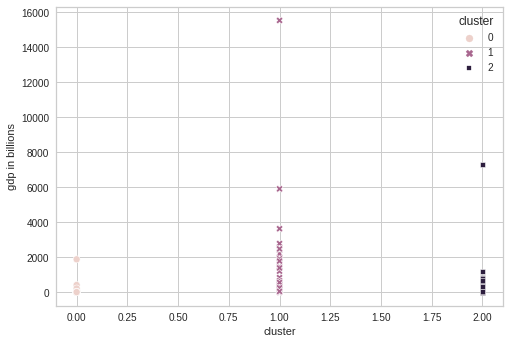

In [ ]:
sns.scatterplot(data=df_new, x="cluster", y="gdp in billions", hue="cluster",style="cluster")

**Plots based on Hierarchial clustering**

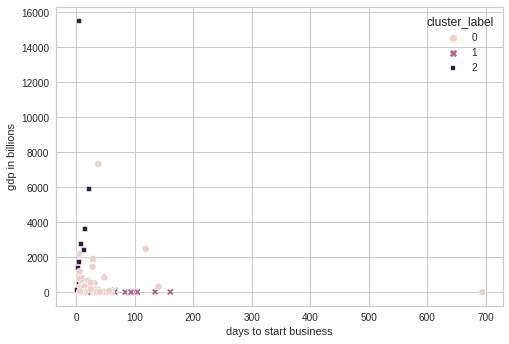

In [ ]:
sns.scatterplot(data=df_new, x="days to start business", y="gdp in billions", hue="cluster_label",style="cluster_label")

(0.0, 8000.0)

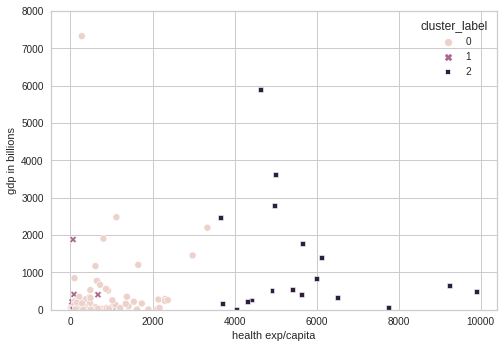

In [ ]:
sns.scatterplot(data=df_new, x="health exp/capita", y="gdp in billions", hue="cluster_label",style="cluster_label")
plt.ylim(0,8000)

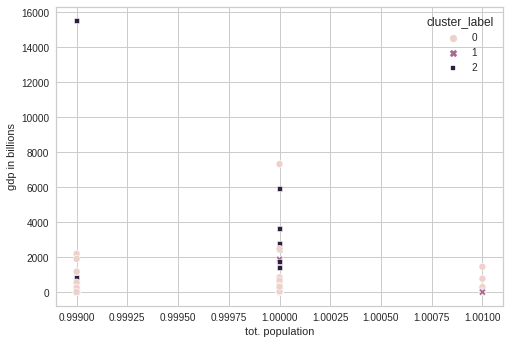

In [ ]:
sns.scatterplot(data=df_new, x="tot. population", y="gdp in billions", hue="cluster_label",style="cluster_label")

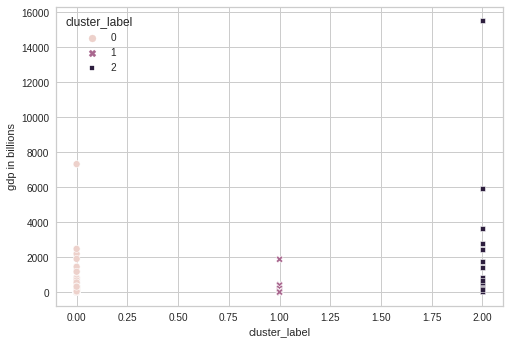

In [ ]:
sns.scatterplot(data=df_new, x="cluster_label", y="gdp in billions", hue="cluster_label",style="cluster_label")